# IMC breast cancer

In this notebook we demonstrate how mosna can be used to analyze spatiallly resolved omics data.  
The data used is from the publication by [Danenberg et al., Nature Genetics, 2023](https://doi.org/10.1038/s41588-022-01041-y) "Breast tumor microenvironment structures are associated with genomic features and clinical outcome".  
Here 693 tumors of breast cancer were processed with the [Imaging Mass Cytometry](https://doi.org/10.1038/s43018-020-0026-6) method (cytometry by time of fligh, CyTOF) to produce maps of 37 proteins and study the relationship between cell types in tumors with respect to survival.  

## Imports and data loading

In [310]:
import warnings
from sklearn.exceptions import ConvergenceWarning, FitFailedWarning
warnings.simplefilter('ignore', FitFailedWarning)
warnings.simplefilter('ignore', ConvergenceWarning)
warnings.simplefilter('ignore', FutureWarning)
warnings.simplefilter('ignore', DeprecationWarning)
warnings.simplefilter('ignore', UserWarning)
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
from time import time
import warnings
import joblib
from pathlib import Path
from time import time
from tqdm import tqdm
import copy
import matplotlib as mpl
import napari
import colorcet as cc
import composition_stats as cs
from sklearn.impute import KNNImputer
from lifelines import KaplanMeierFitter, CoxPHFitter

# from tysserand import tysserand as ty
import sys
mosna_path =  '../../mosna/'
sys.path.append(mosna_path)
import mosna

ty_path =  '../../../tysserand2/tysserand2/'
sys.path.append(ty_path)
import tysserand2 as ty

import matplotlib as mpl
mpl.rcParams["figure.facecolor"] = 'white'
mpl.rcParams["axes.facecolor"] = 'white'
mpl.rcParams["savefig.facecolor"] = 'white'

In [97]:
# If need to reload modules after their modification
from importlib import reload
ty = reload(ty)
mosna = reload(mosna)

In [98]:
RUN_LONG = False

### Objects data

Load files that contains all the detected objects (the cells) across all samples and clinical data.  
Data is available here: https://zenodo.org/records/7324285  
Images are available here: https://zenodo.org/records/6036188

In [99]:
data_dir = Path("../../data/raw/IMC_Breast_cancer_Danenberg_2022")
objects_path = data_dir / "SingleCells.csv"

if objects_path.with_suffix('.parquet').exists():
    obj = pd.read_parquet(objects_path.with_suffix('.parquet'))
else:
    obj = pd.read_csv(objects_path)
    # for latter use
    obj.to_parquet(objects_path.with_suffix('.parquet'))
obj

,ImageNumber,ObjectNumber,metabric_id,cellPhenotype,is_epithelial,is_tumour,is_normal,is_dcis,is_interface,is_perivascular,...,CD31-vWF,CXCL12,HLA-ABC,panCK,c-Caspase3,DNA1,DNA2,Location_Center_X,Location_Center_Y,AreaShape_Area
0,1,1,MB-0282,CK^{med}ER^{lo},1,1,0,0,1,0,...,0.495330,0.401104,9.282180,18.180412,0.163026,29.445302,54.989698,121.418605,4.023256,43
1,1,2,MB-0282,ER^{hi}CXCL12^{+},1,1,0,0,1,0,...,0.552035,2.567602,1.417755,48.593726,0.310149,23.160734,42.596685,150.468531,6.083916,143
2,1,4,MB-0282,CD4^{+} T cells & APCs,0,1,0,0,0,0,...,0.493669,0.117742,3.791699,3.404438,0.242591,16.884008,31.325295,221.930233,5.139535,129
3,1,5,MB-0282,CK^{med}ER^{lo},1,1,0,0,0,0,...,0.373286,1.048929,2.364418,23.289196,0.297700,8.475436,15.654673,354.136364,5.890909,110
4,1,7,MB-0282,CD4^{+} T cells,0,1,0,0,1,0,...,0.287512,0.058795,4.690886,0.664581,0.078051,14.009167,28.587826,469.174603,7.158730,126
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1123461,797,3818,MB-0406,CK8-18^{hi}CXCL12^{hi},1,1,0,0,0,0,...,0.412993,7.255870,0.947830,76.300971,0.000000,16.235925,31.912625,482.950000,947.825000,40
1123462,797,3819,MB-0406,CK8-18^{hi}CXCL12^{hi},1,1,0,0,0,0,...,0.609522,3.370633,1.534348,53.953806,0.205527,7.448000,12.347708,605.791667,945.333333,24
1123463,797,3820,MB-0406,CK8-18^{hi}CXCL12^{hi},1,1,0,0,1,0,...,0.562381,2.553417,0.629895,41.573201,0.187847,9.222450,18.821950,833.200000,947.350000,20
1123464,797,3822,MB-0406,CK^{lo}ER^{lo},1,1,0,0,1,0,...,0.133439,0.019060,1.156061,0.053584,0.000000,3.641944,7.286806,851.916667,949.222222,36


`ObjectNumber` is the ID of cells, starting at 1 for each image (there are 797 ObjectNumber = 1).

In [100]:
obj.rename(columns={'Location_Center_X': 'x', 'Location_Center_Y': 'y'}, inplace=True)
sample_col = 'ImageNumber'  # != from `sample_cols`
patient_col = 'metabric_id'
pheno_col = 'cellPhenotype'
sample_cols = [sample_col, patient_col, pheno_col, 'ObjectNumber']
# this file contains 'c-Caspase3c-PARP' instead of 'c-Caspase3c' as in the dataframe
# all_epitopes = pd.read_csv(data_dir / 'markerStackOrder.csv').iloc[:, 1].values
# so instead we directly do:
all_epitopes = obj.columns[11:50].values
# remove Histone H3 and DNA markers
marker_cols = list(all_epitopes[1:-2])
pos_cols = ['x', 'y']
cell_type_cols = [
    'is_epithelial',
    'is_tumour',
    'is_normal',
    'is_dcis',
    'is_interface',
    'is_perivascular',
    'is_hotAggregate',
    ]
nb_phenotypes = obj[pheno_col].unique().size
all_cols = sample_cols + marker_cols + pos_cols + cell_type_cols + [pheno_col]
# columns we want to include in network data
net_cols = pos_cols + [pheno_col] + cell_type_cols + marker_cols

print(f'nb phenotypes: {nb_phenotypes}')
print(f'nb used markers: {len(marker_cols)}')

nb phenotypes: 32
nb used markers: 36


In [101]:
obj[pheno_col]

0                 CK^{med}ER^{lo}
1               ER^{hi}CXCL12^{+}
2          CD4^{+} T cells & APCs
3                 CK^{med}ER^{lo}
4                 CD4^{+} T cells
                    ...          
1123461    CK8-18^{hi}CXCL12^{hi}
1123462    CK8-18^{hi}CXCL12^{hi}
1123463    CK8-18^{hi}CXCL12^{hi}
1123464            CK^{lo}ER^{lo}
1123465               Fibroblasts
Name: cellPhenotype, Length: 1123466, dtype: object

In [102]:
obj.sample(5)

,ImageNumber,ObjectNumber,metabric_id,cellPhenotype,is_epithelial,is_tumour,is_normal,is_dcis,is_interface,is_perivascular,...,CD31-vWF,CXCL12,HLA-ABC,panCK,c-Caspase3,DNA1,DNA2,x,y,AreaShape_Area
908395,734,1236,MB-3506,Fibroblasts,0,0,1,0,0,0,...,0.301903,0.000000,0.037958,0.067882,0.060409,3.673478,6.302221,449.433628,472.212389,113
110926,83,1426,MB-0316,CD38^{+} lymphocytes,0,1,0,0,0,0,...,0.991141,0.135938,3.864204,0.224862,0.224538,28.399867,55.970500,205.716667,318.966667,60
863228,696,976,MB-3363,CK^{lo}ER^{lo},1,1,0,0,0,0,...,0.300576,0.099647,4.277914,0.473621,0.197320,51.422082,98.285740,272.315068,338.986301,73
722834,589,86,MB-2820,Endothelial,0,1,0,0,0,1,...,0.253226,0.010216,0.452909,0.127100,0.081672,6.393752,12.188634,433.405941,43.306931,101
594009,469,714,MB-0314,Fibroblasts,0,1,0,0,0,0,...,0.482444,0.067730,2.468338,0.672010,0.115562,17.170727,33.006804,211.602871,305.368421,209


In [103]:
# Show number of cells per sample
sample_sizes = obj[['ImageNumber', 'ObjectNumber']].groupby(['ImageNumber']).count()
sample_sizes

,ObjectNumber
ImageNumber,
1,1624
2,1057
3,1648
4,1348
5,2018
...,...
793,372
794,4460
795,2689


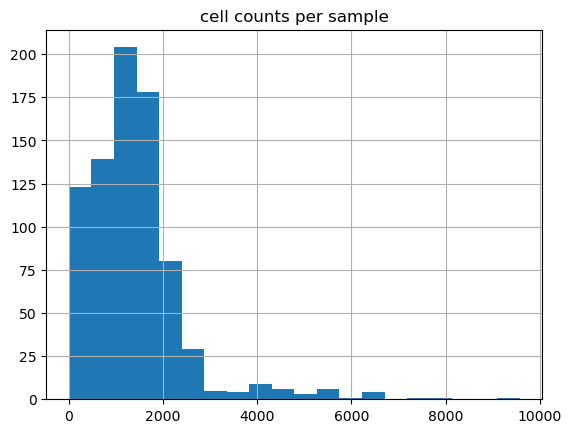

In [104]:
axes = sample_sizes.hist(bins=20)
axes[0][0].set_title('cell counts per sample');

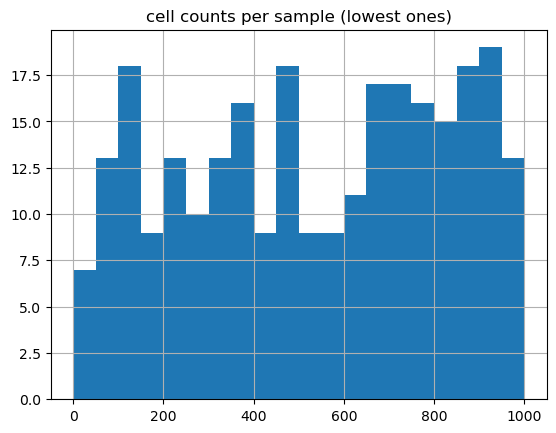

In [105]:
axes = sample_sizes.hist(bins=20, range=(0, 1000))
axes[0][0].set_title('cell counts per sample (lowest ones)');

We may need to discard patients with too few cells, we'll manually inspect reconstructed networks to define a size threshold latter in this notebook.

In [106]:
# aggregate unique pairs of patients and image IDs
sample_patient_counts = obj[sample_cols].groupby([sample_col, patient_col]).count()
print(sample_patient_counts)

# count occurrences of patient IDs in patient / image pairs
occ = sample_patient_counts.index.get_level_values(1).value_counts()
print(occ)

n_patient_multiple = np.sum(occ.values != 1)
print(f'There are {n_patient_multiple} patients with multiple samples')

sample_patient_mapper = dict(sample_patient_counts.index.values)

                         cellPhenotype  ObjectNumber
ImageNumber metabric_id                             
1           MB-0282               1624          1624
2           MB-0099               1057          1057
3           MB-0598               1648          1648
4           MB-0606               1348          1348
5           MB-0190               2018          2018
...                                ...           ...
793         MB-0359                372           372
794         MB-0353               4460          4460
795         MB-0158               2689          2689
796         MB-0158                737           737
797         MB-0406               3758          3758

[794 rows x 2 columns]
metabric_id
MB-0359    4
MB-0135    3
MB-0175    3
MB-0145    3
MB-0184    3
          ..
MB-0180    1
MB-0181    1
MB-0182    1
MB-0183    1
MB-0129    1
Name: count, Length: 718, dtype: int64
There are 59 patients with multiple samples


In [107]:
print(obj.columns)

Index(['ImageNumber', 'ObjectNumber', 'metabric_id', 'cellPhenotype',
       'is_epithelial', 'is_tumour', 'is_normal', 'is_dcis', 'is_interface',
       'is_perivascular', 'is_hotAggregate', 'Histone H3', 'SMA', 'CK5',
       'CD38', 'HLA-DR', 'CK8-18', 'CD15', 'FSP1', 'CD163', 'ICOS', 'OX40',
       'CD68', 'HER2 (3B5)', 'CD3', 'Podoplanin', 'CD11c', 'PD-1', 'GITR',
       'CD16', 'HER2 (D8F12)', 'CD45RA', 'B2M', 'CD45RO', 'FOXP3', 'CD20',
       'ER', 'CD8', 'CD57', 'Ki-67', 'PDGFRB', 'Caveolin-1', 'CD4', 'CD31-vWF',
       'CXCL12', 'HLA-ABC', 'panCK', 'c-Caspase3', 'DNA1', 'DNA2', 'x', 'y',
       'AreaShape_Area'],
      dtype='object')


### Survival data

From the authors:
> Processed metadata from the METABRIC study are among the files provided.  It is, however, recommended that additional analyses that rely on METABRIC metadata, use data downloaded from their original publications or a public repository as these data are subject to updates, and the user may wish to process them differently.

In [108]:
survival_path = data_dir / "IMCClinical.csv"
surv = pd.read_csv(survival_path, index_col=0)
surv.head()

,ERStatus,LymphNodesOrdinal,sizeOrdinal,Grade,ERBB2_pos,yearsToStatus,DeathBreast,isValidation,PAM50,IntClust
metabric_id,,,,,,,,,,
MB-0000,pos,7+,20-50mm,3.0,False,11.540041,0,False,Normal-like,IntClust 4+
MB-0002,pos,0,5-10mm,3.0,False,6.951403,0,False,Luminal A,IntClust 4+
MB-0005,pos,1,10-20mm,2.0,False,13.445585,1,False,Luminal B,IntClust 3
MB-0006,pos,2-3,20-50mm,2.0,False,13.546886,0,False,Luminal B,IntClust 9
MB-0008,pos,7+,20-50mm,3.0,False,3.397673,1,False,Luminal B,IntClust 9


### Discard small samples

### TYSSERAND


In [109]:
ty_path =  '../../../tysserand2/tysserand2/'
sys.path.append(ty_path)
import tysserand2 as ty

import tysserand as ty1

In [110]:
nodes[pheno_col].head()


901413    Myofibroblasts
901414       Fibroblasts
901415       Fibroblasts
901416    Myofibroblasts
901417    Myofibroblasts
Name: cellPhenotype, dtype: object

In [381]:
pos_cols

['x', 'y']

    processing sample 416
    there are 6/291 nodes with < 3 edges


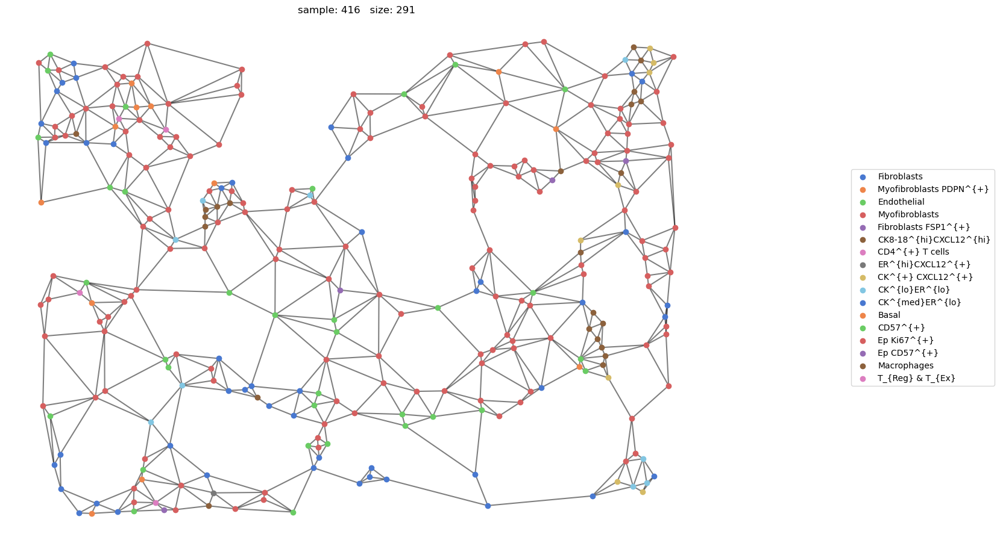

    processing sample 174
    there are 2/294 nodes with < 3 edges


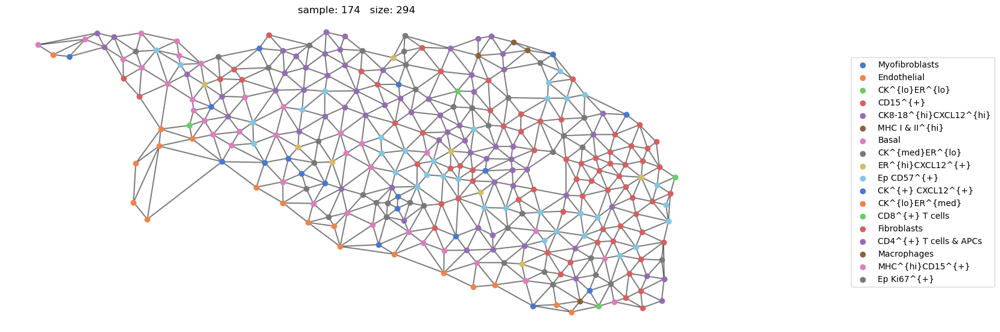

    processing sample 285
    there are 1/300 nodes with < 3 edges


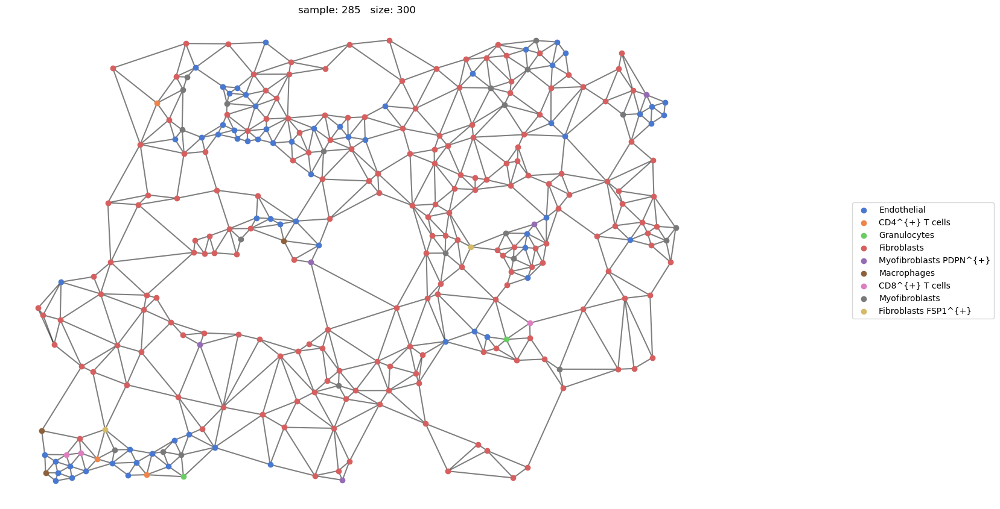

    processing sample 59
    there are 1/301 nodes with < 3 edges


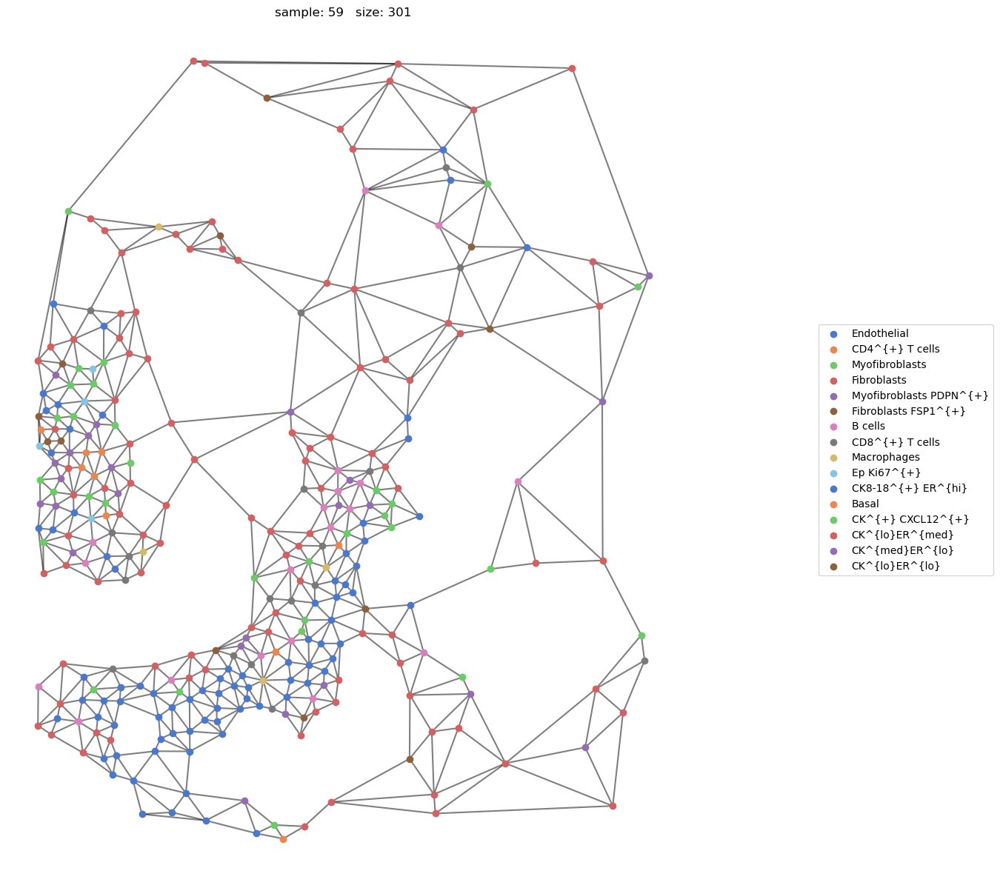

    processing sample 626
    there are 2/308 nodes with < 3 edges


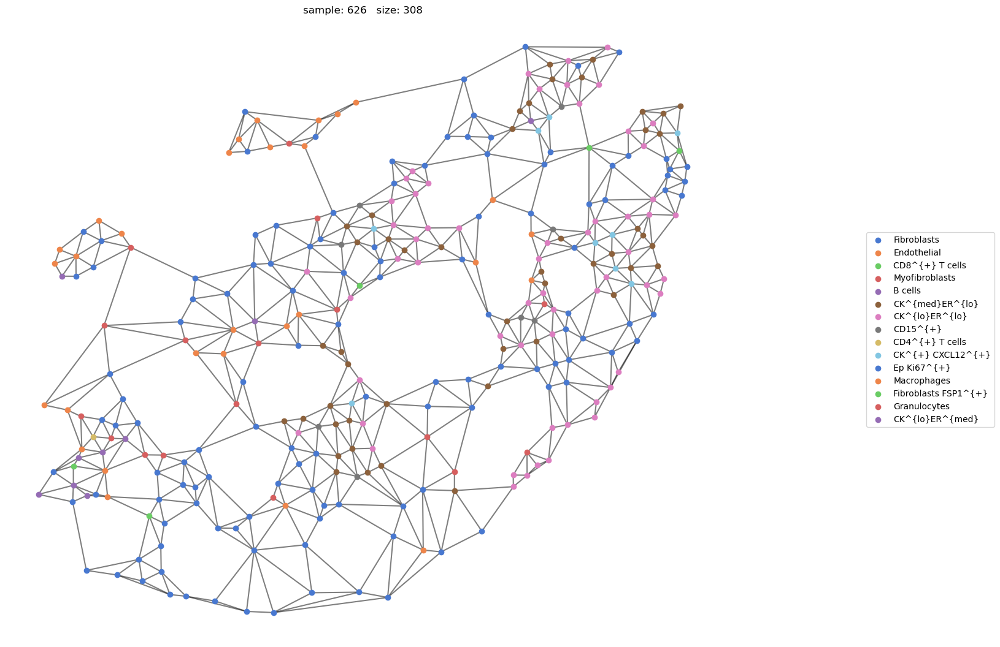

    processing sample 116
    there are 4/314 nodes with < 3 edges


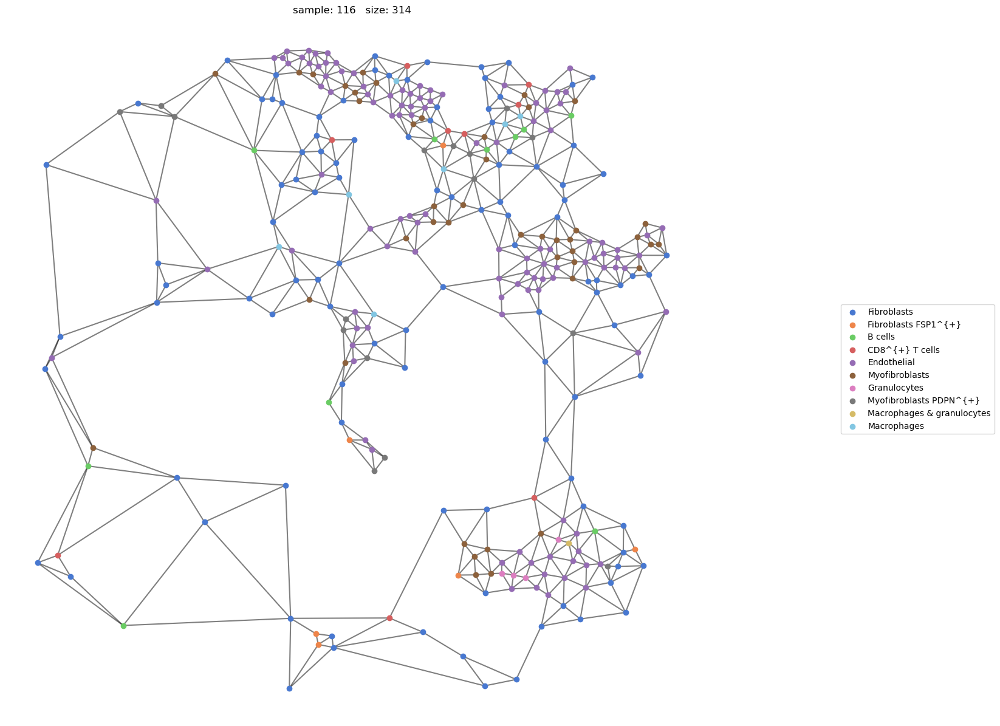

    processing sample 270
    there are 1/316 nodes with < 3 edges


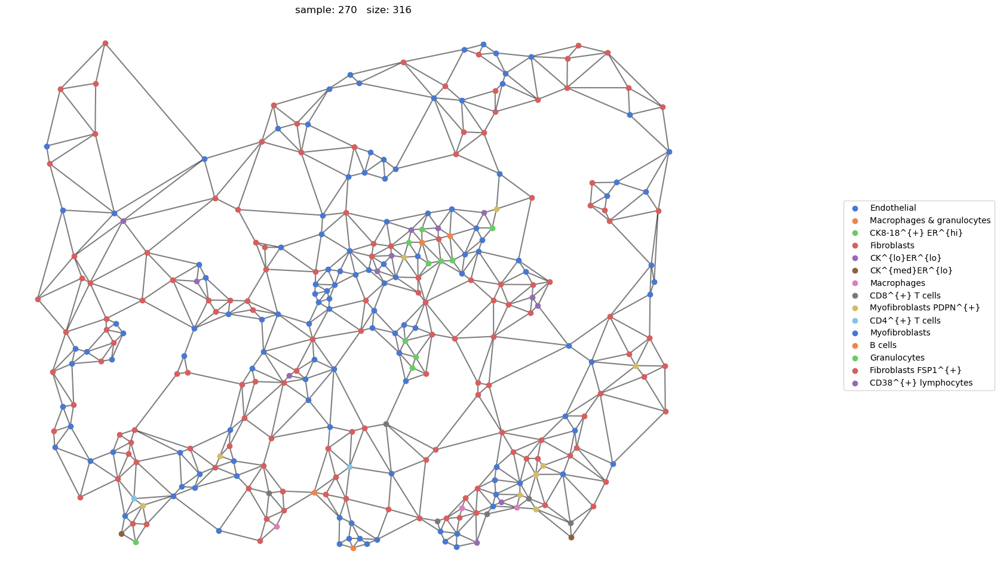

    processing sample 412
    there are 5/326 nodes with < 3 edges


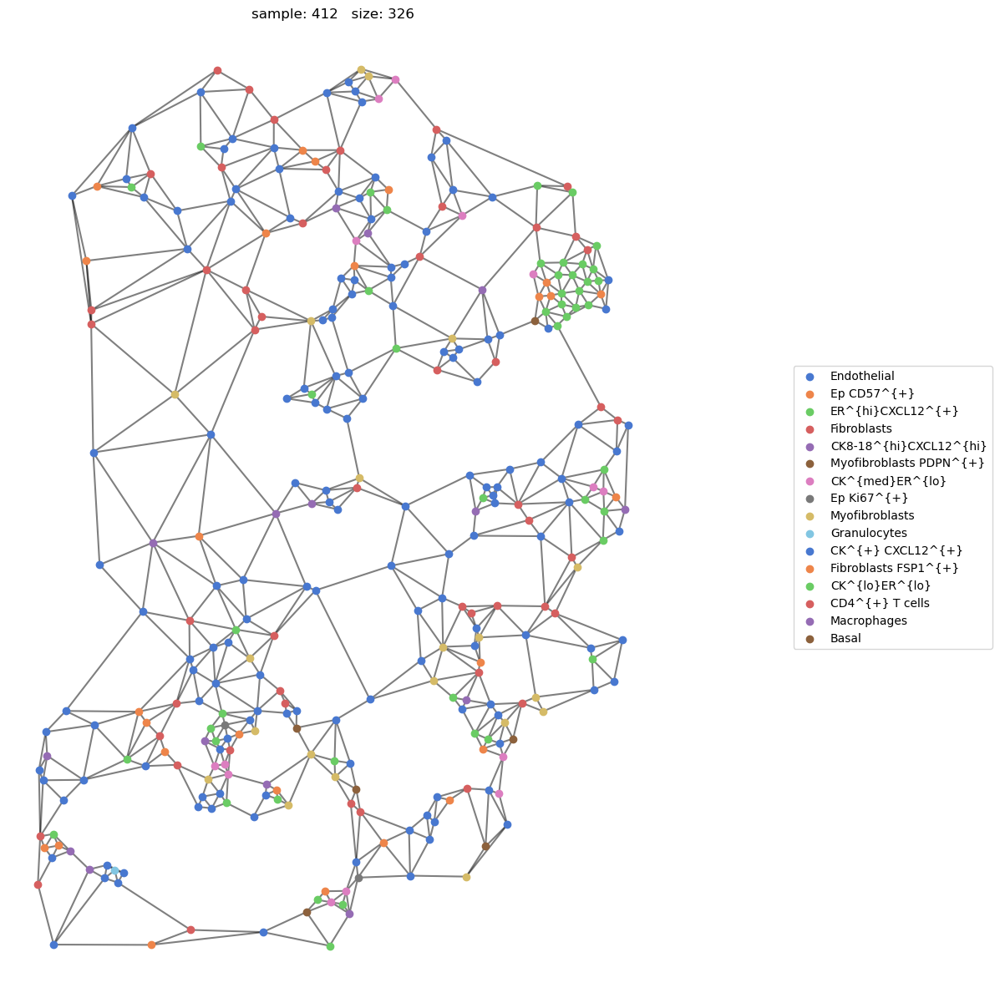

    processing sample 761
    there are 3/328 nodes with < 3 edges


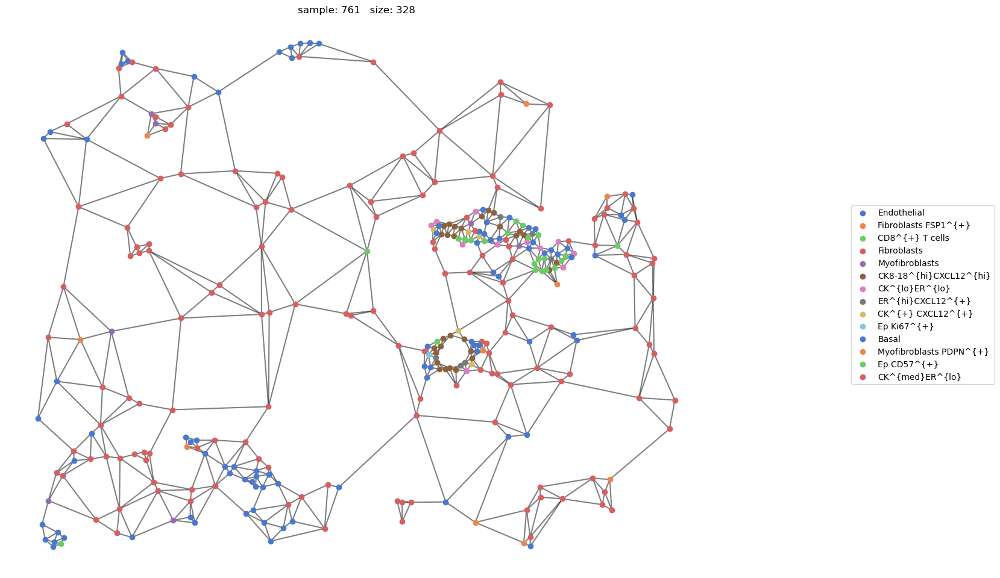

    processing sample 249
    there are 2/332 nodes with < 3 edges


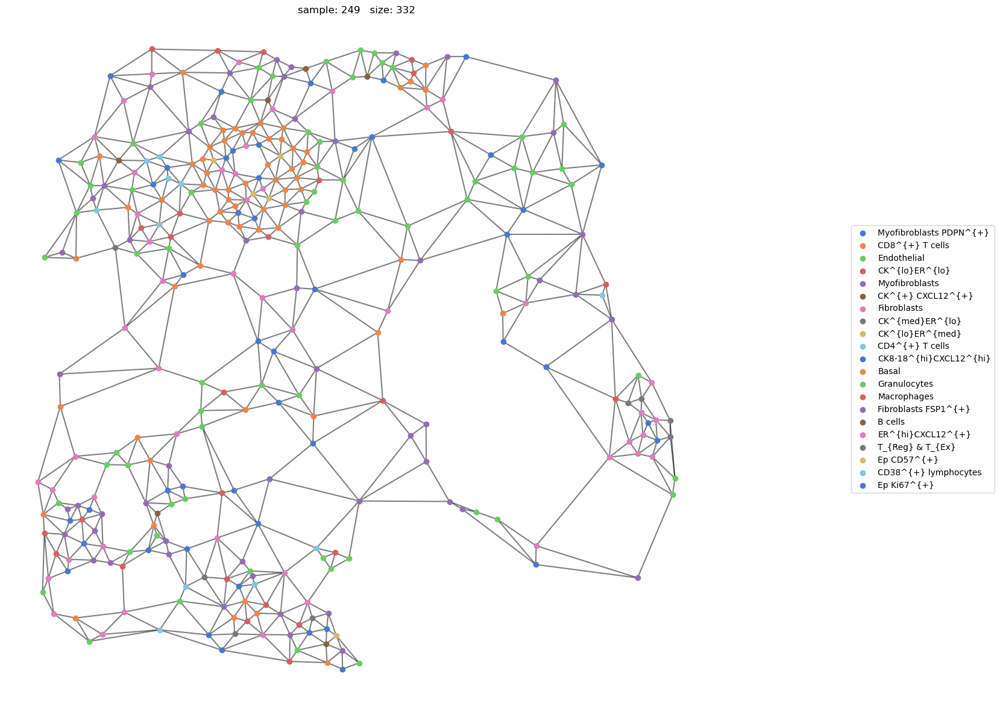

    processing sample 31
    there are 4/332 nodes with < 3 edges


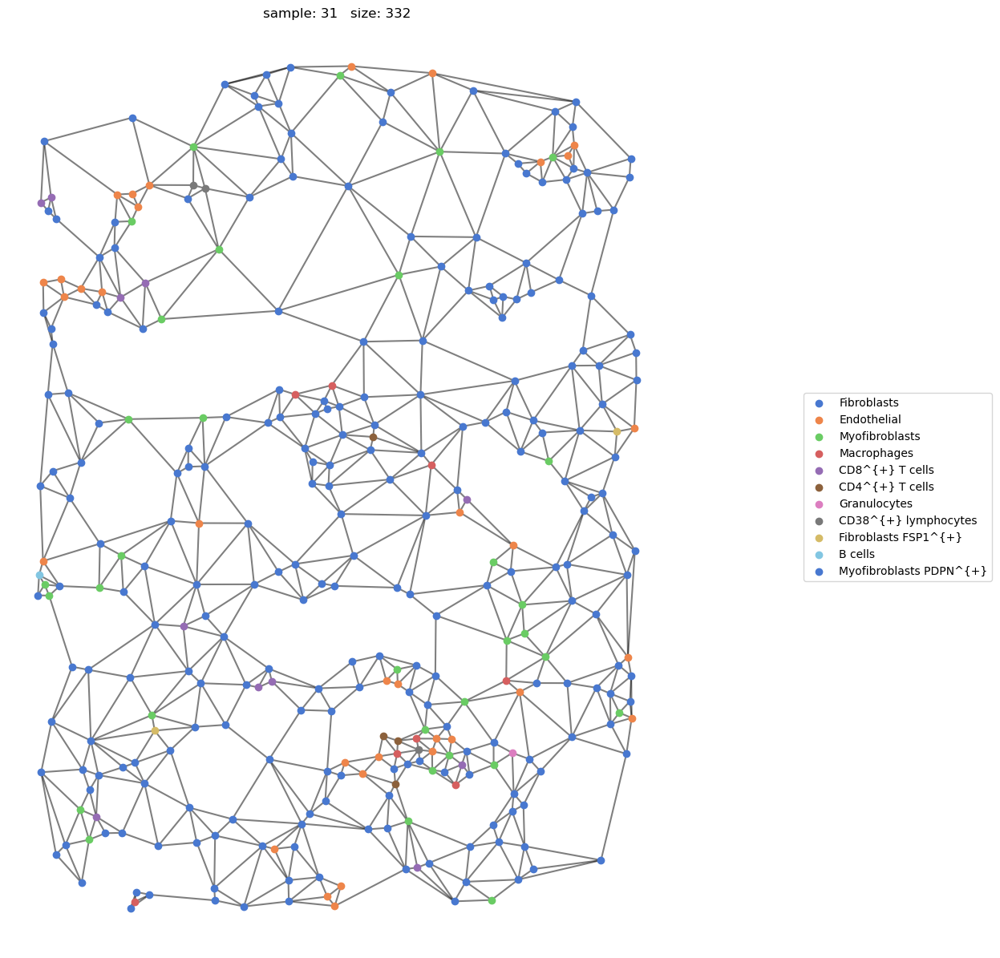

    processing sample 330
    there are 2/342 nodes with < 3 edges


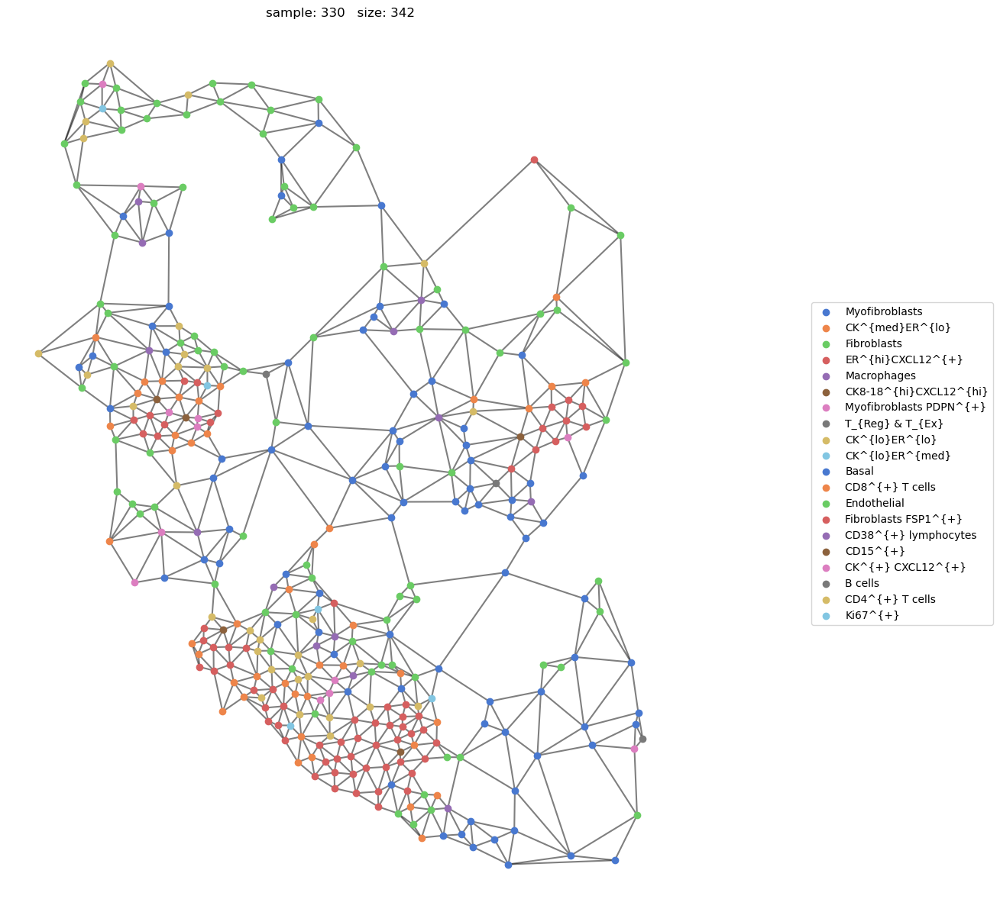

    processing sample 484
    there are 3/343 nodes with < 3 edges


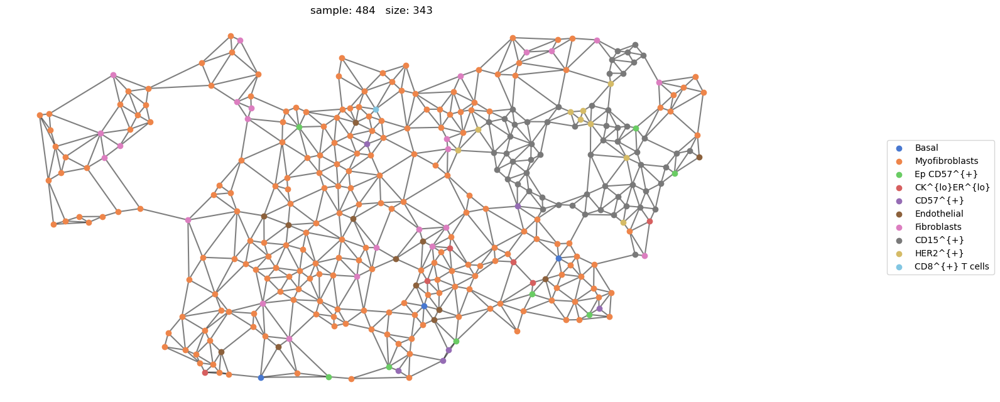

    processing sample 464
    there are 1/346 nodes with < 3 edges


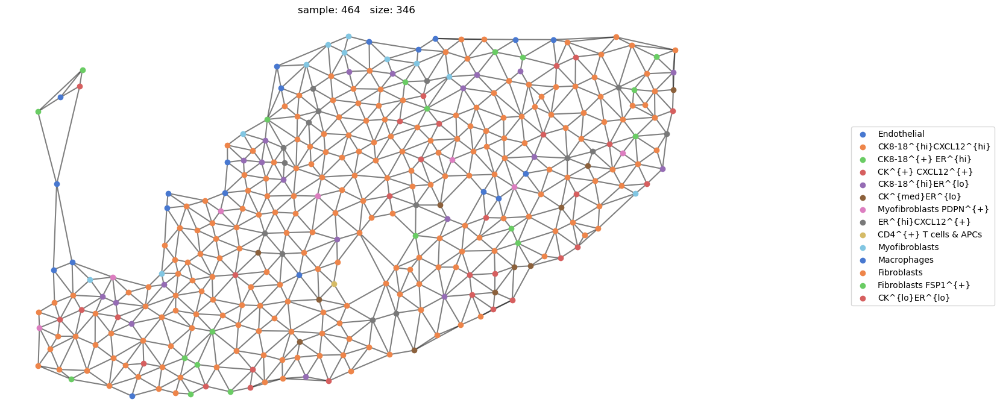

    processing sample 517
    all nodes have at least 3 edges


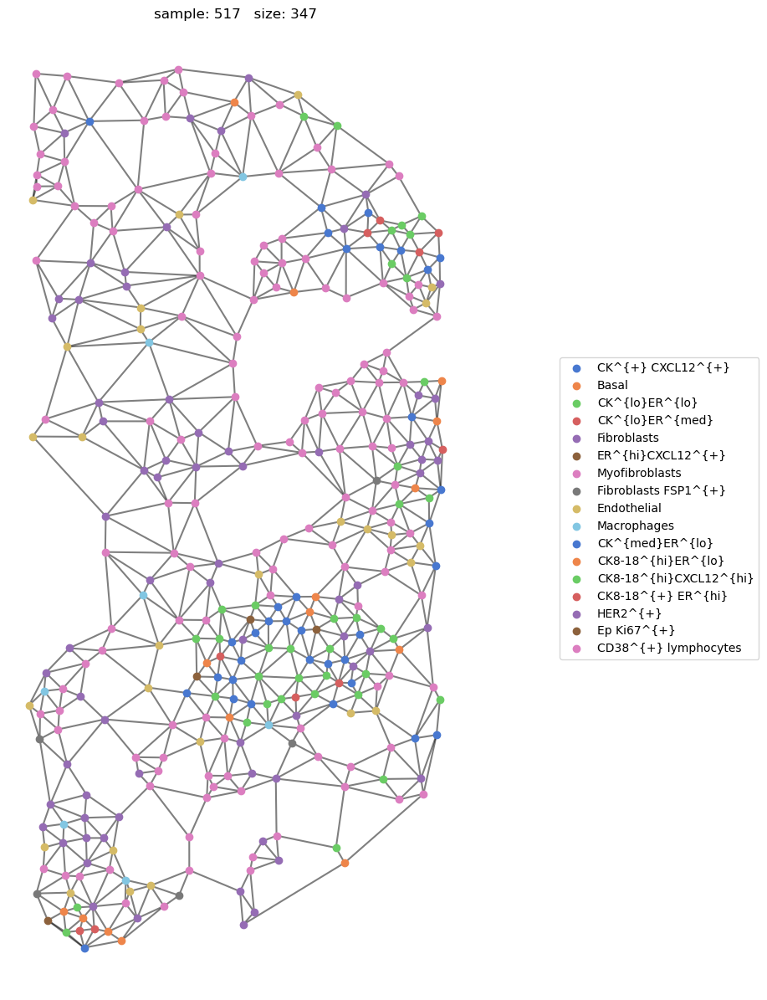

    processing sample 72
    there are 4/356 nodes with < 3 edges


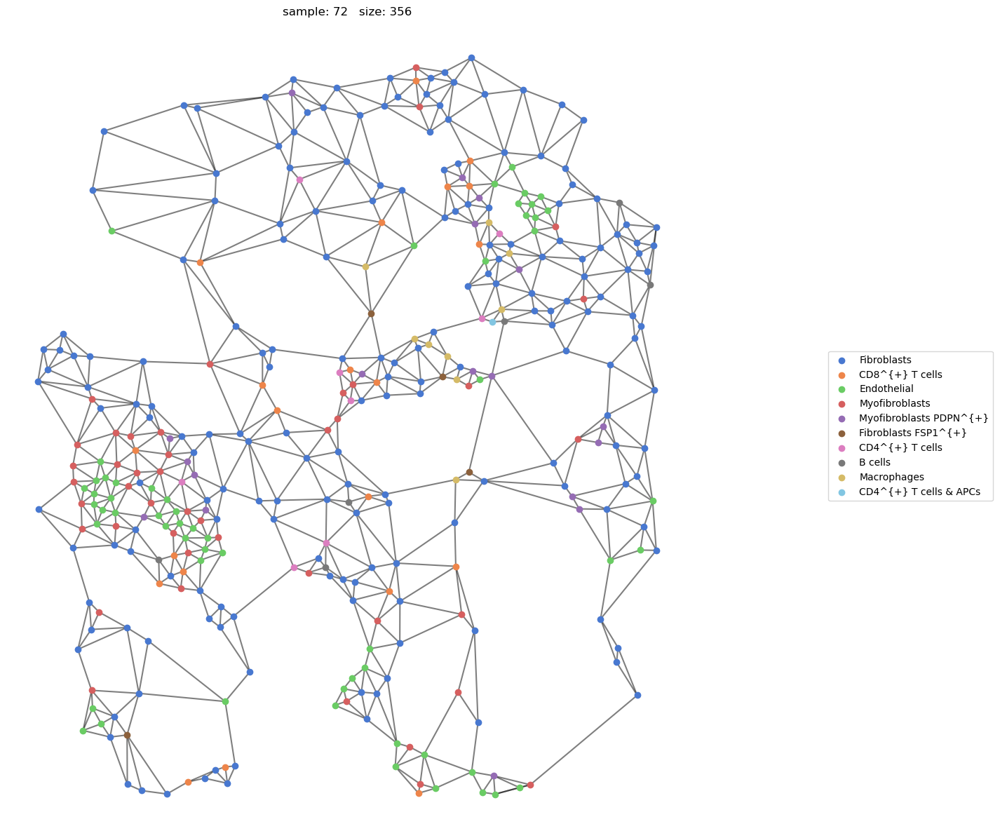

    processing sample 193
    there are 3/357 nodes with < 3 edges


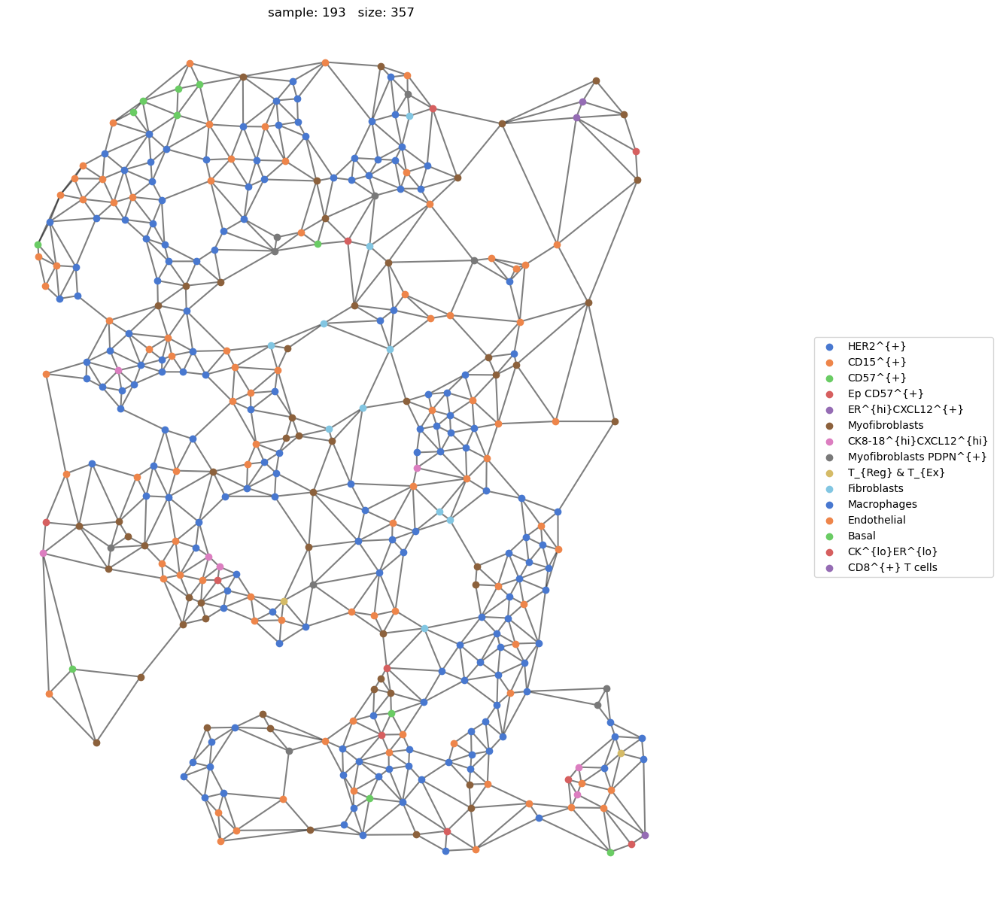

    processing sample 481
    there are 4/358 nodes with < 3 edges


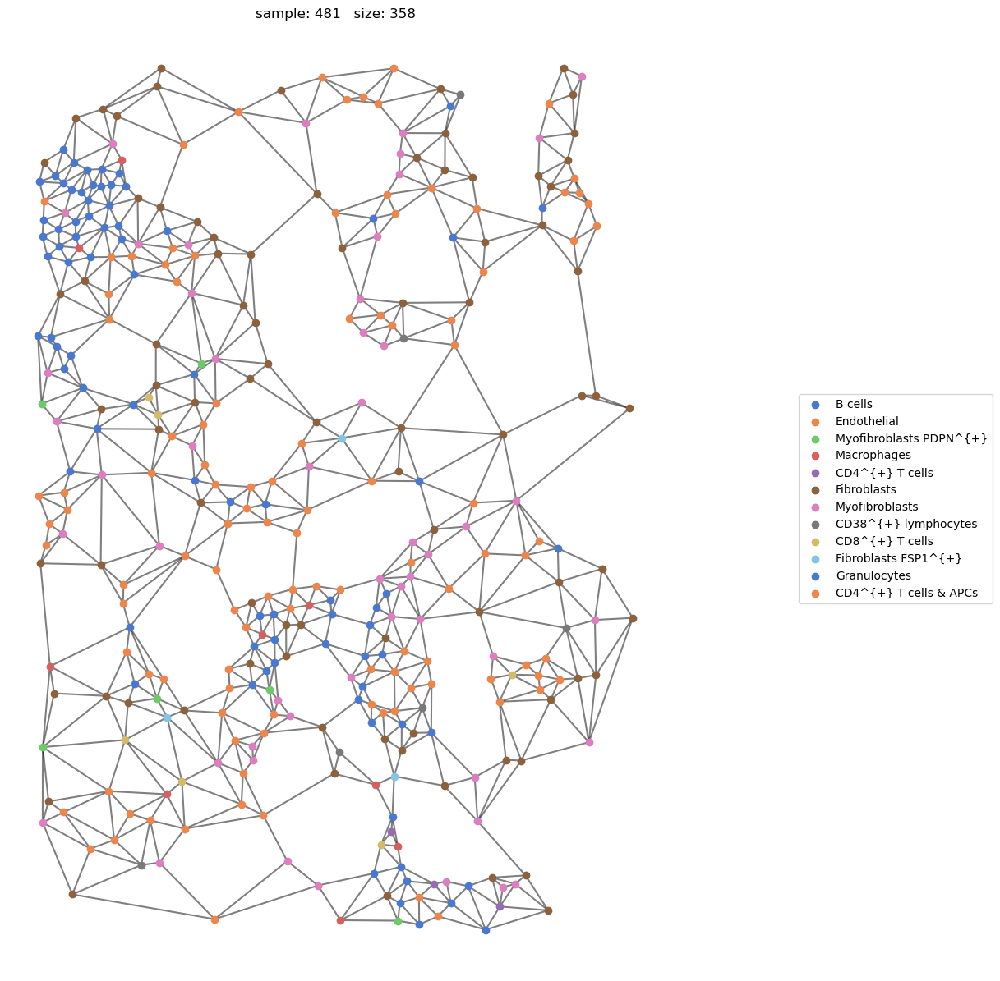

    processing sample 67
    there are 1/358 nodes with < 3 edges


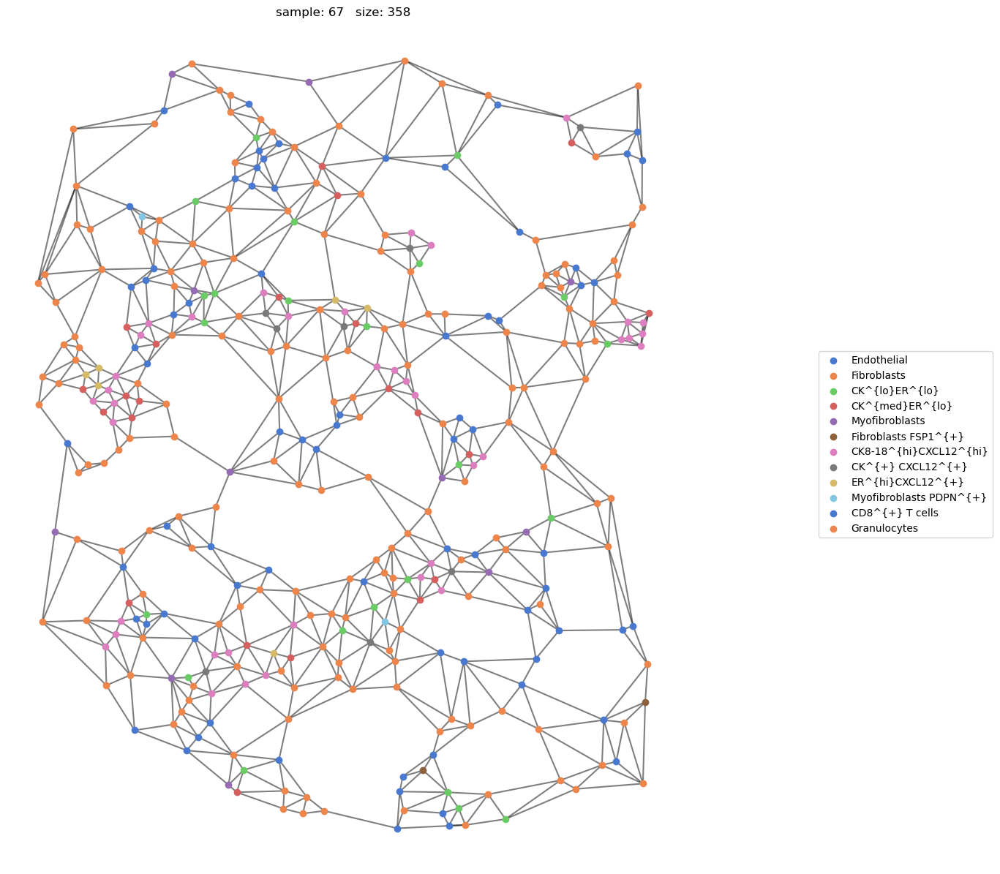

    processing sample 704
    there are 2/362 nodes with < 3 edges


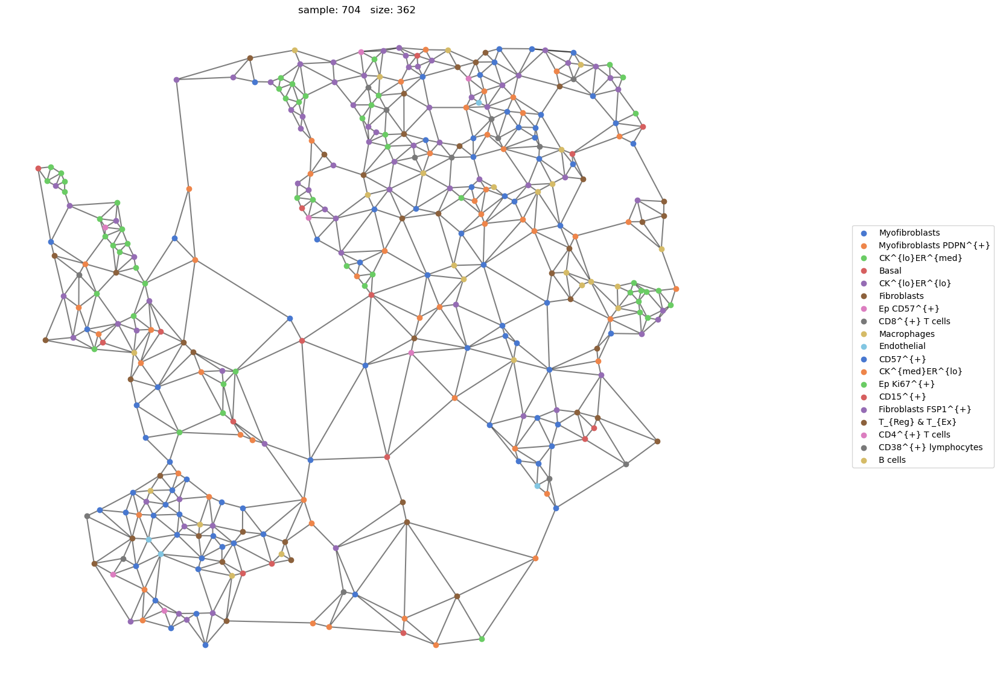

    processing sample 290
    there are 2/368 nodes with < 3 edges


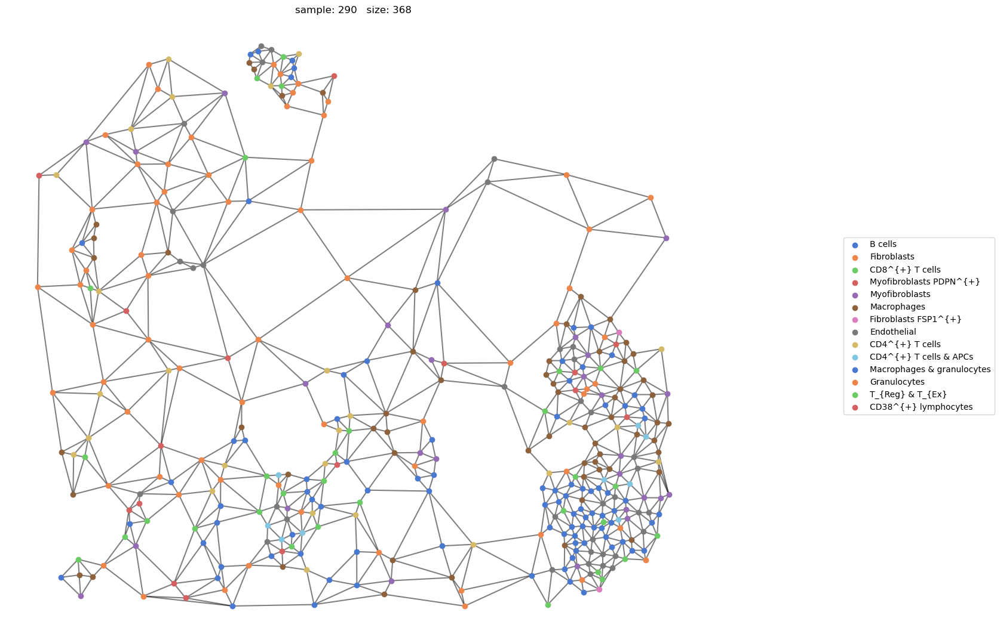

    processing sample 793
    there are 4/372 nodes with < 3 edges


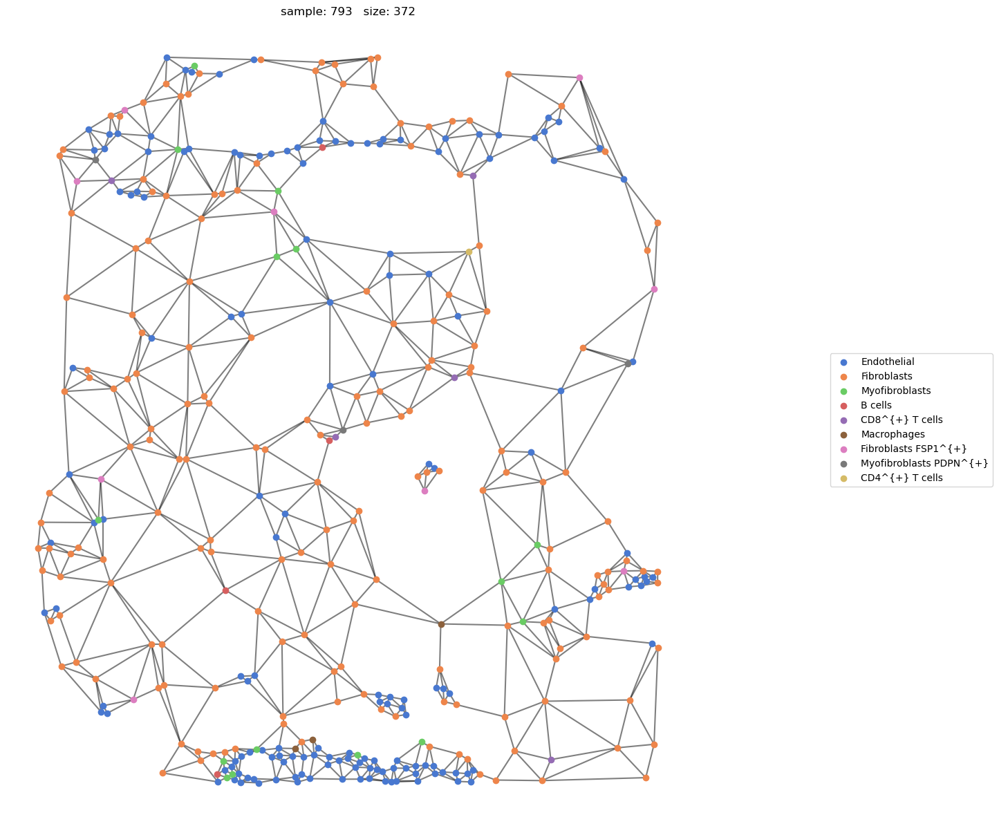

    processing sample 311
    there are 3/374 nodes with < 3 edges


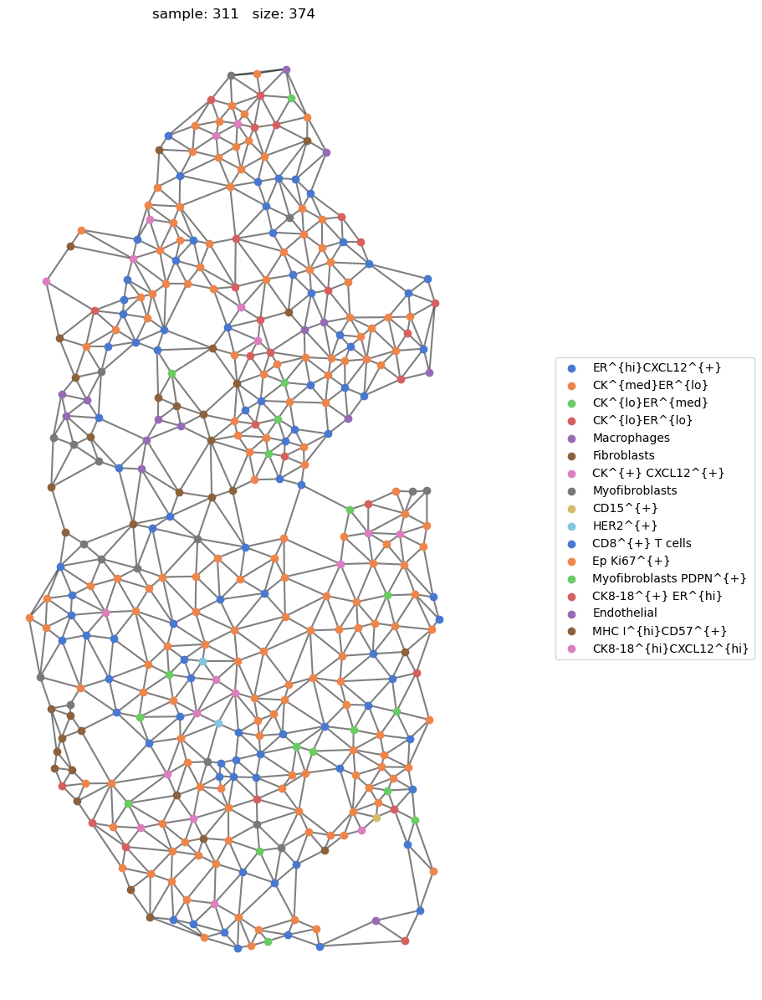

    processing sample 362
    there are 6/375 nodes with < 3 edges


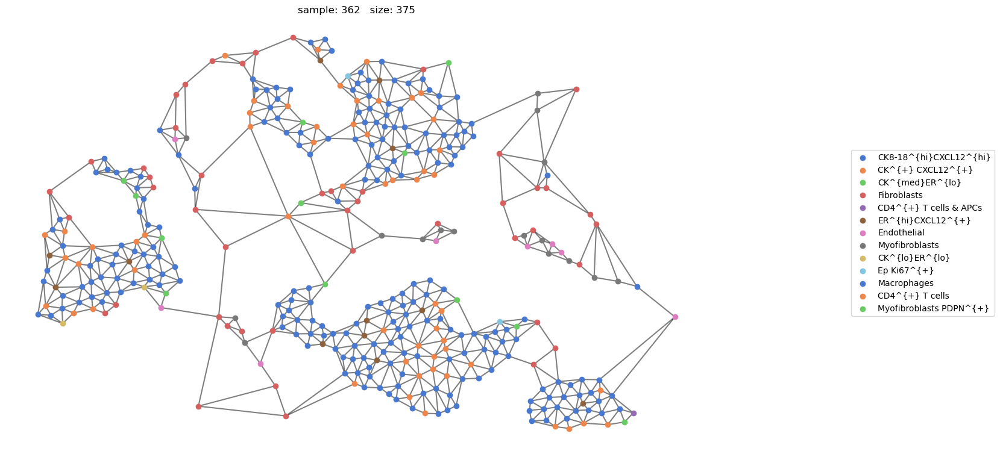

    processing sample 23
    there are 3/382 nodes with < 3 edges


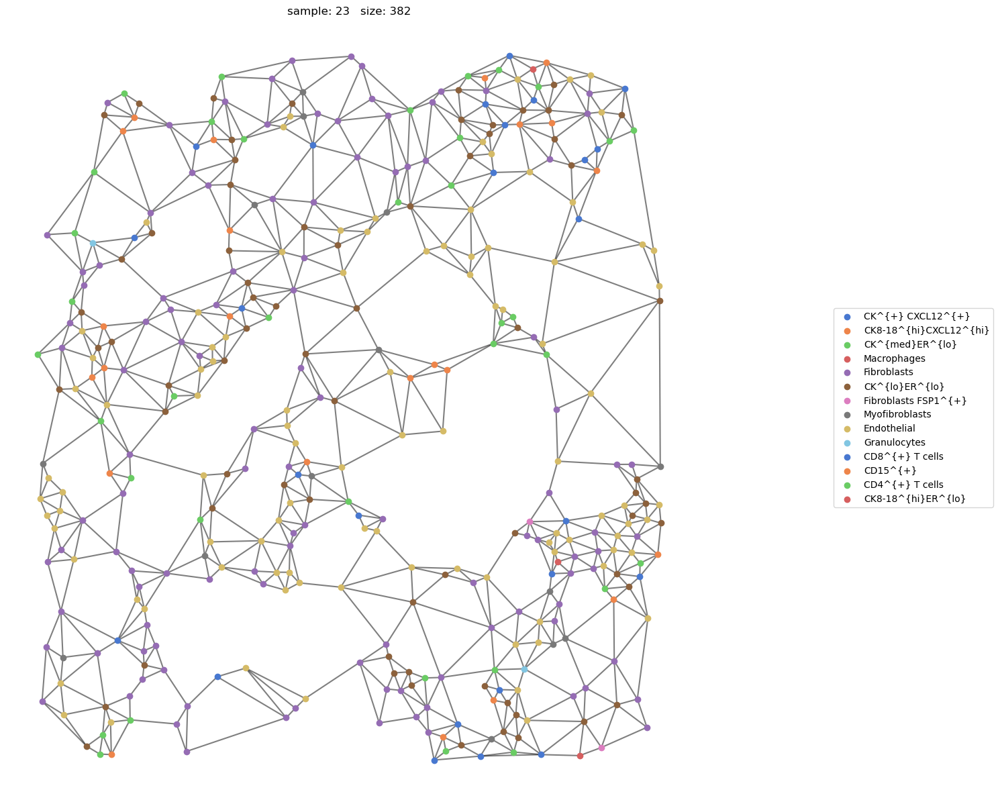

    processing sample 225
    there are 3/385 nodes with < 3 edges


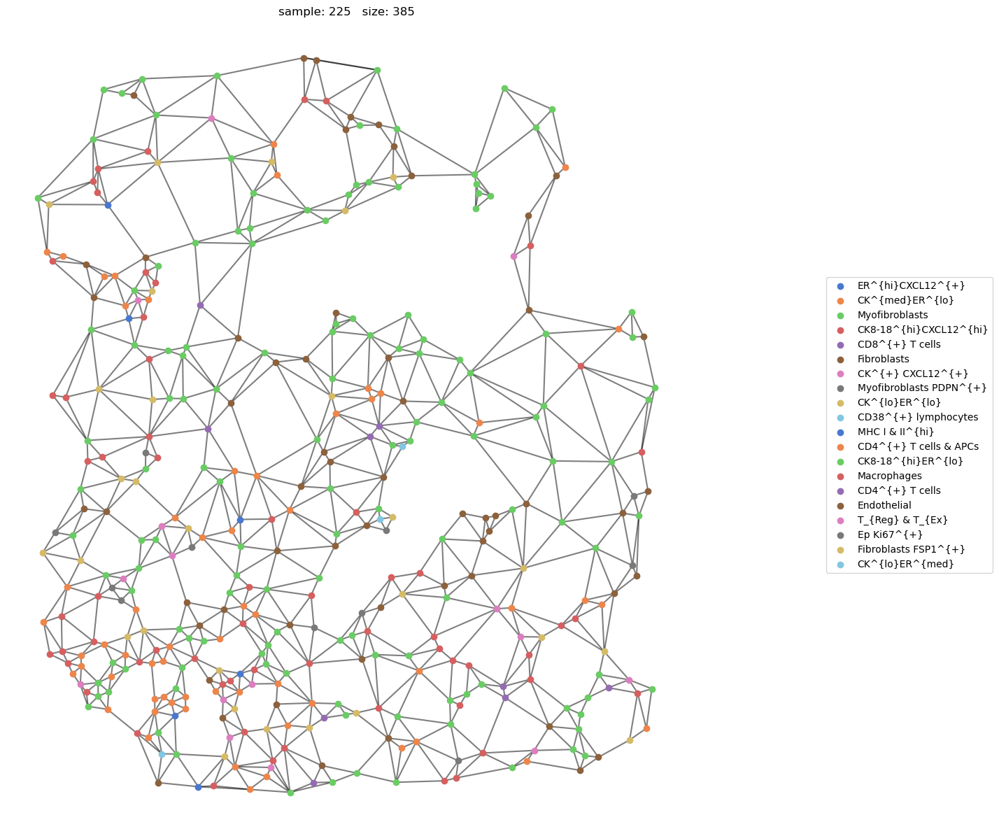

    processing sample 778
    there are 2/387 nodes with < 3 edges


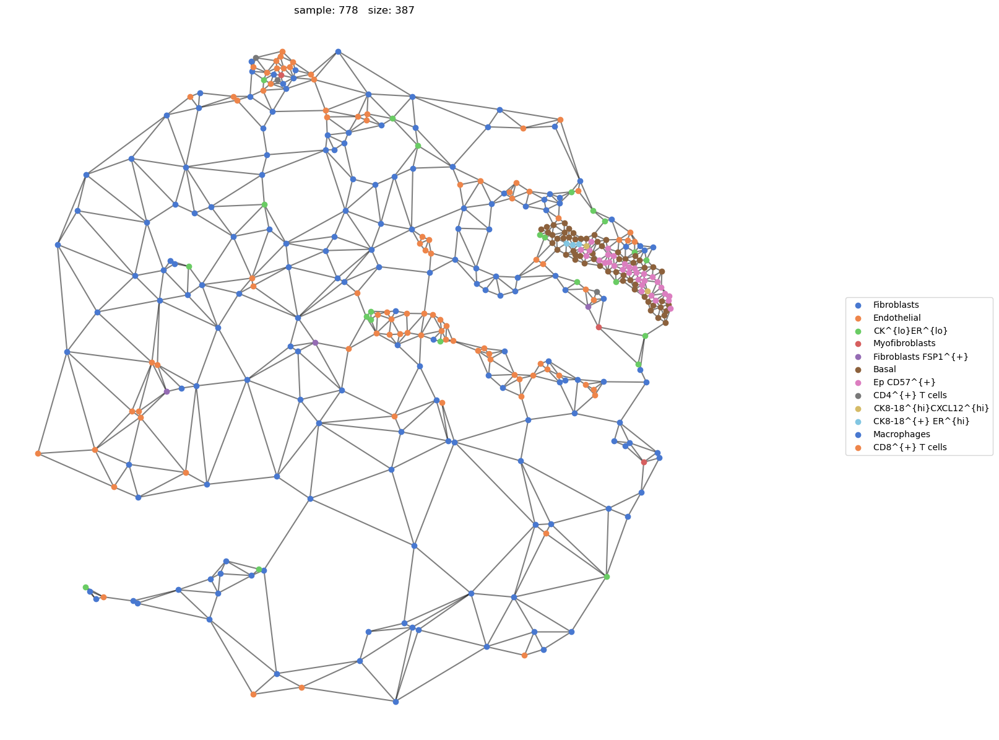

    processing sample 183
    there are 4/393 nodes with < 3 edges


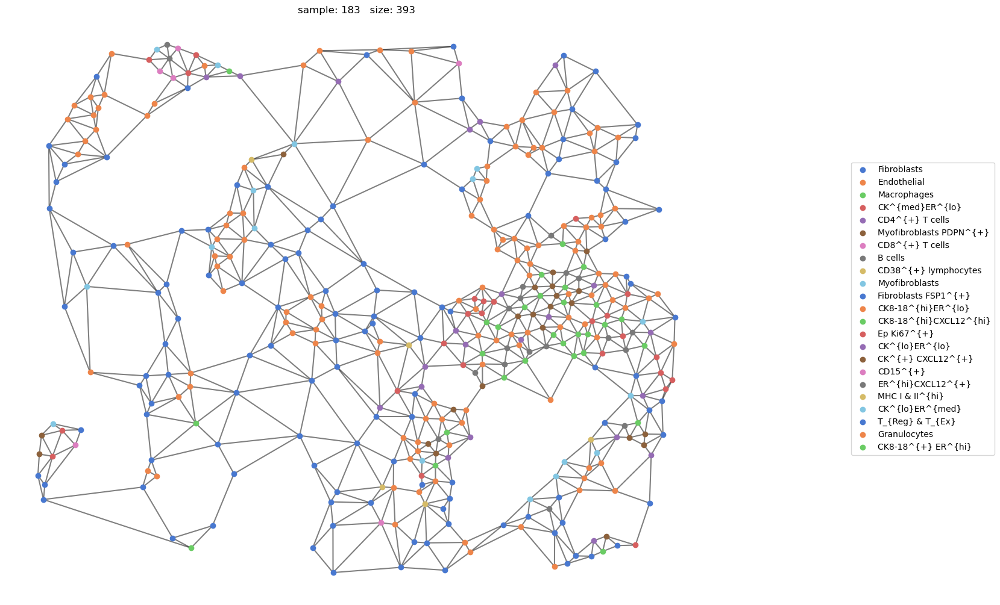

    processing sample 457
    there are 1/396 nodes with < 3 edges


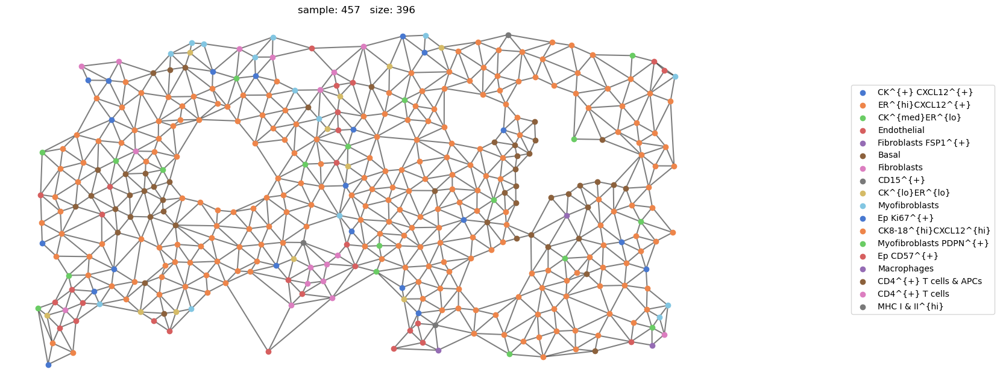

    processing sample 633
    there are 3/397 nodes with < 3 edges


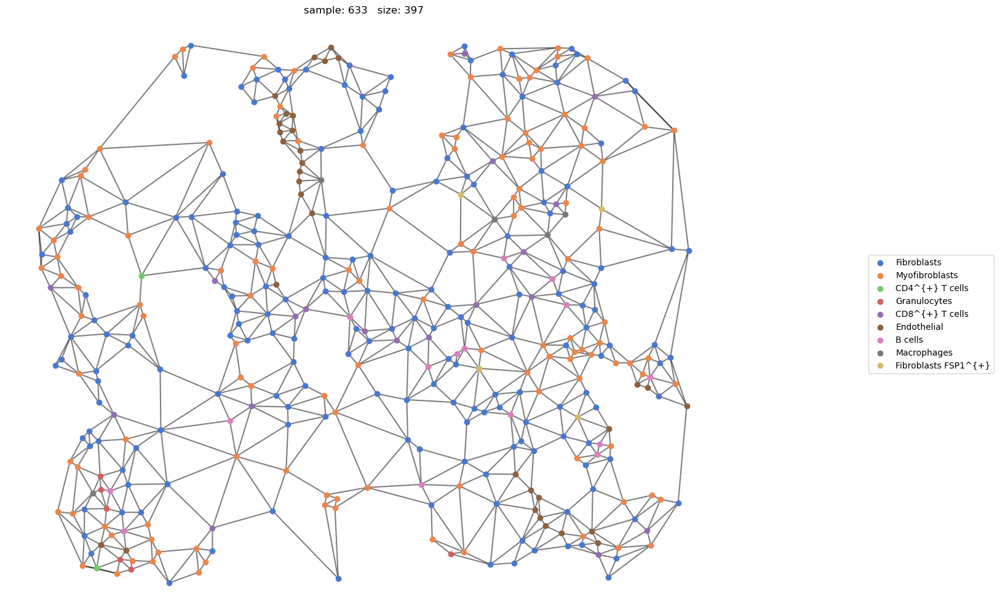

    processing sample 251
    there are 2/399 nodes with < 3 edges


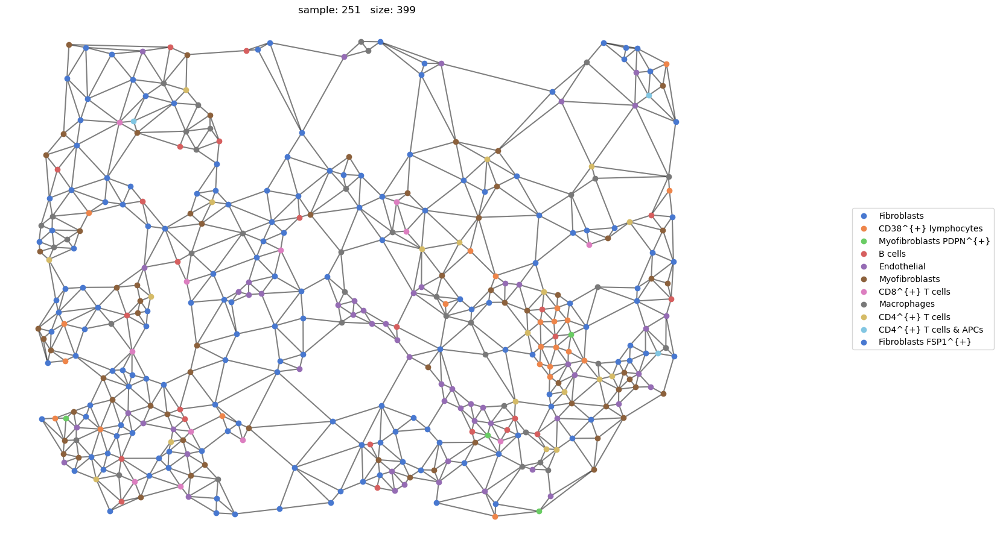

    processing sample 679
    there are 2/400 nodes with < 3 edges


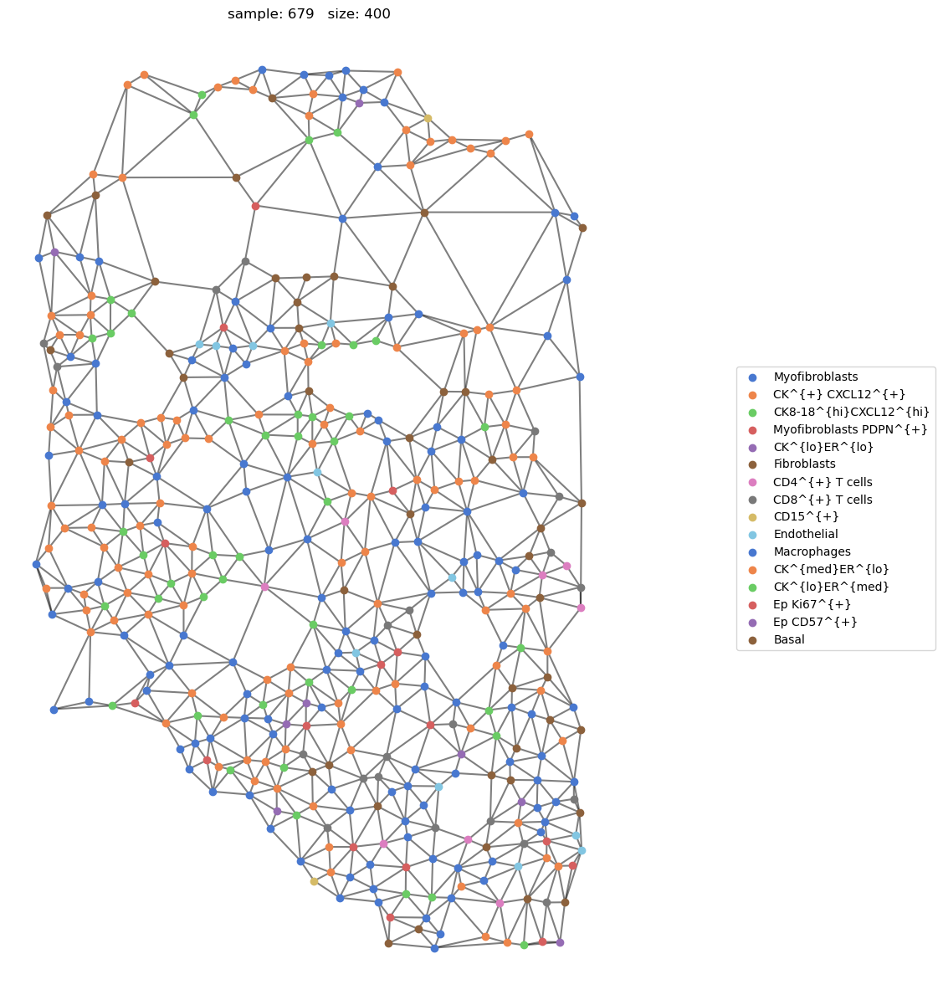

In [111]:
reload(ty)
trim_dist = 200
min_neighbors = 3
smallest_samples = sample_sizes.sort_values('ObjectNumber') #.head(20)
RUN_LONG = 1
all_cols = list(set(all_cols))
if RUN_LONG:
    for sample_name in smallest_samples.index[:100]:
        print("    processing sample {}".format(sample_name))
        select_sample = obj[sample_col] == sample_name
        nodes = obj.loc[select_sample, all_cols]
        coords = nodes[pos_cols].values
        pairs = ty.build_delaunay(
            coords, 
            node_adaptive_trimming=True, 
            n_edges=3, 
            trim_dist_ratio=2,
            min_dist=0, 
            trim_dist=trim_dist,
            )
        print("    ", end="")

        if min_neighbors > 0:
            pairs = ty.link_solitaries(
                coords, 
                pairs, 
                min_neighbors=min_neighbors,
                )
        distances = ty.distance_neighbors(coords, pairs)
        sample_size = len(coords)
        fig, ax = ty.plot_network(
            coords, pairs, labels=nodes[pheno_col],
            legend_opt={'loc': 'center left', 'bbox_to_anchor': (1.2, 0.5)}
            )
        plt.axis('off');
        title = f"network_sample-{sample_name}"
        ax.set_title(f"sample: {sample_name}   size: {sample_size}")
        plt.show()

We discard samples with less than 150 cells.

In [112]:
net_size_threshold = 150

select = sample_sizes['ObjectNumber'] >= net_size_threshold
print(f"there are {select.sum()} samples with > {net_size_threshold} cells, discarding {len(select) - select.sum()} samples")
sample_sizes = sample_sizes.loc[select, :]
uniq_samples = sample_sizes.index.values

print(f"filtering small samples, full dataframe dropping from {len(obj)} cells to", end=' ')
obj = obj.query("ImageNumber in @uniq_samples")
print(f'{len(obj)} cells')

print(f"survival data dropping from {len(surv)} patients to", end=' ')
uniq_patients = obj['metabric_id'].unique()
# surv = surv.query("metabric_id in @uniq_patients")
print(f'{len(surv)} patients')

there are 756 samples with > 150 cells, discarding 38 samples
filtering small samples, full dataframe dropping from 1123466 cells to 1120100 cells
survival data dropping from 709 patients to 709 patients


## Spatial networks reconstruction

### Load one sample

We will have a look at the spatial networks of different samples from the same patient to check they seem "correct", i.e. not over nor under connected.

In [113]:
# make common color mapper
cycle_cmap = False

nodes_labels = obj[pheno_col]
uniq = pd.Series(nodes_labels).value_counts().index

if nodes_labels is not None:
    nb_clust = nodes_labels.max()
    uniq = pd.Series(nodes_labels).value_counts().index

    # choose colormap
    clusters_cmap = mosna.make_cluster_cmap(uniq)
    # make color mapper
    # series to sort by decreasing order
    n_colors = len(clusters_cmap)
    celltypes_color_mapper = {x: clusters_cmap[i % n_colors] for i, x in enumerate(uniq)}

In [114]:
reload(ty)

<module 'tysserand2' from '/home/abdelmounim.essabbar/Projects/mosna_benchmark/benchmarking/mosna_repo/../../../tysserand2/tysserand2/tysserand2.py'>

processing sample 59
there are 1/301 nodes with < 3 edges
processing sample 150
there are 2/1060 nodes with < 3 edges
processing sample 790
there are 4/3598 nodes with < 3 edges
processing sample 793
there are 4/372 nodes with < 3 edges


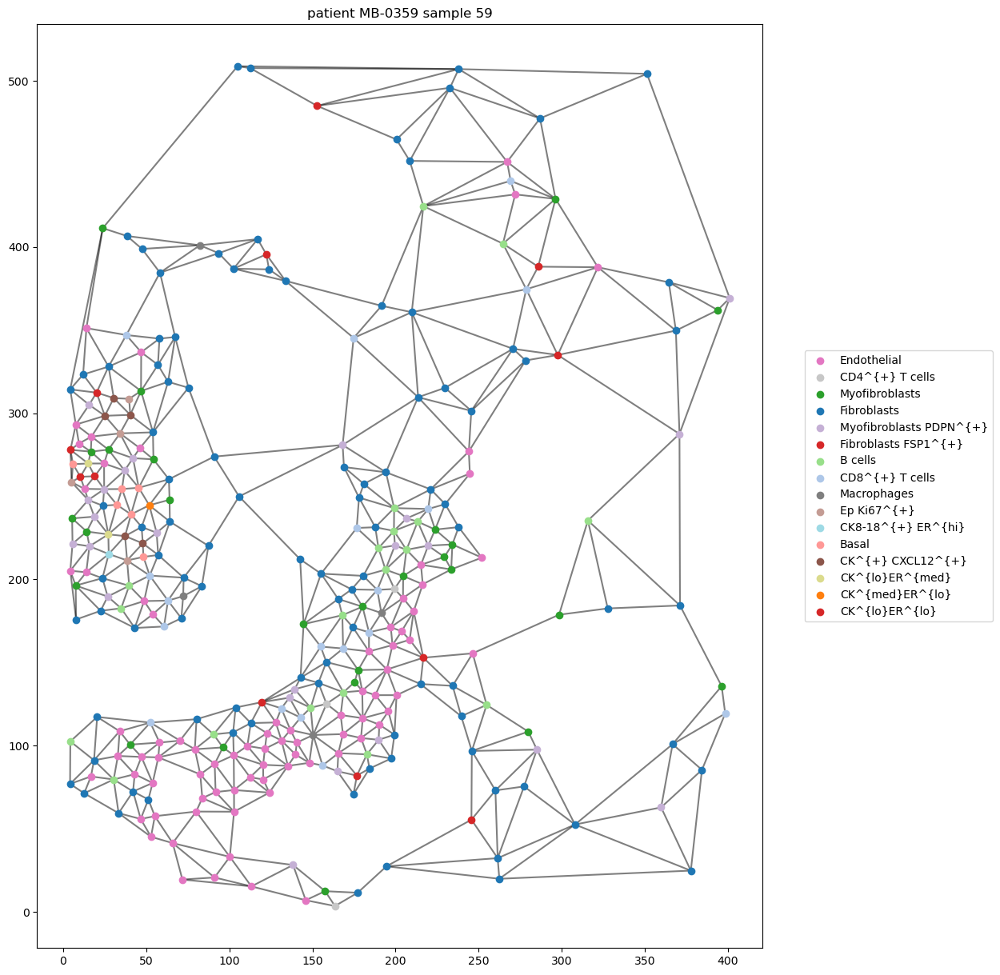

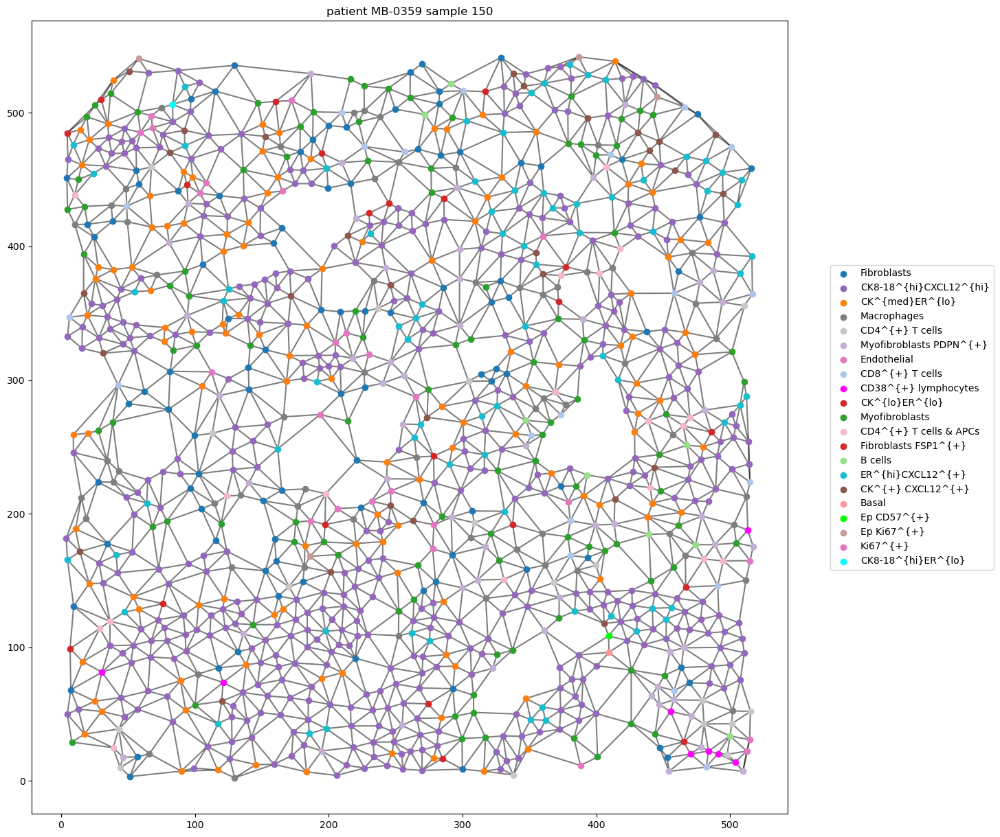

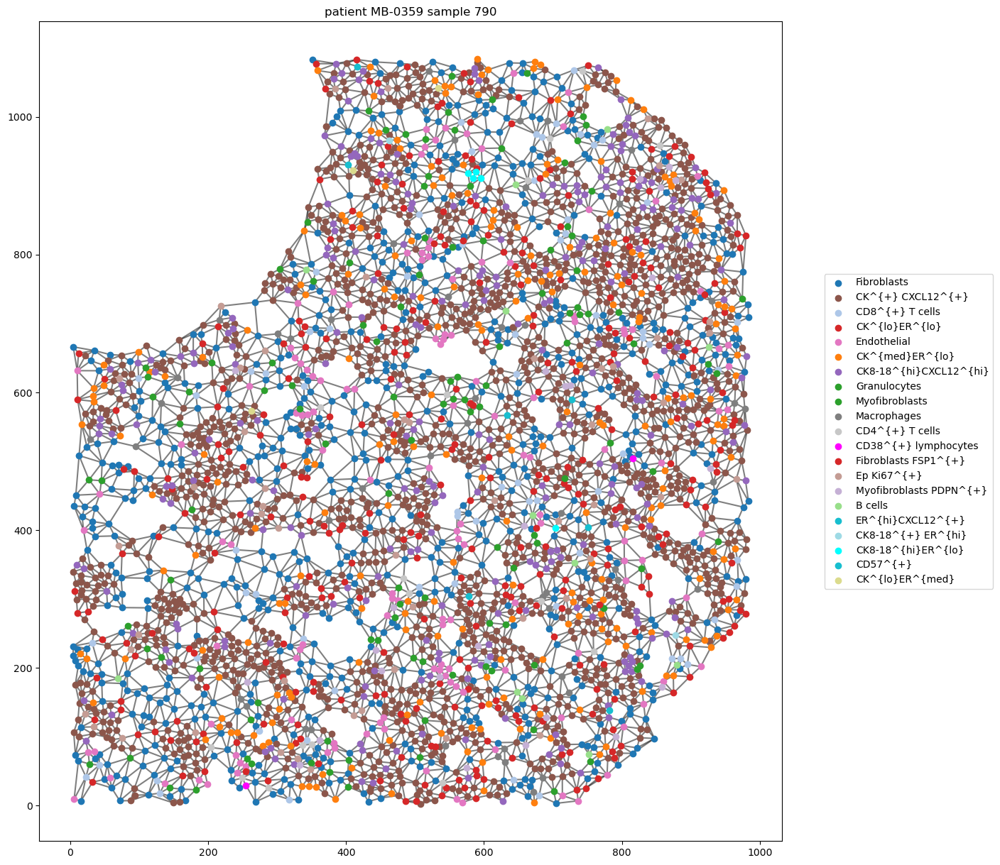

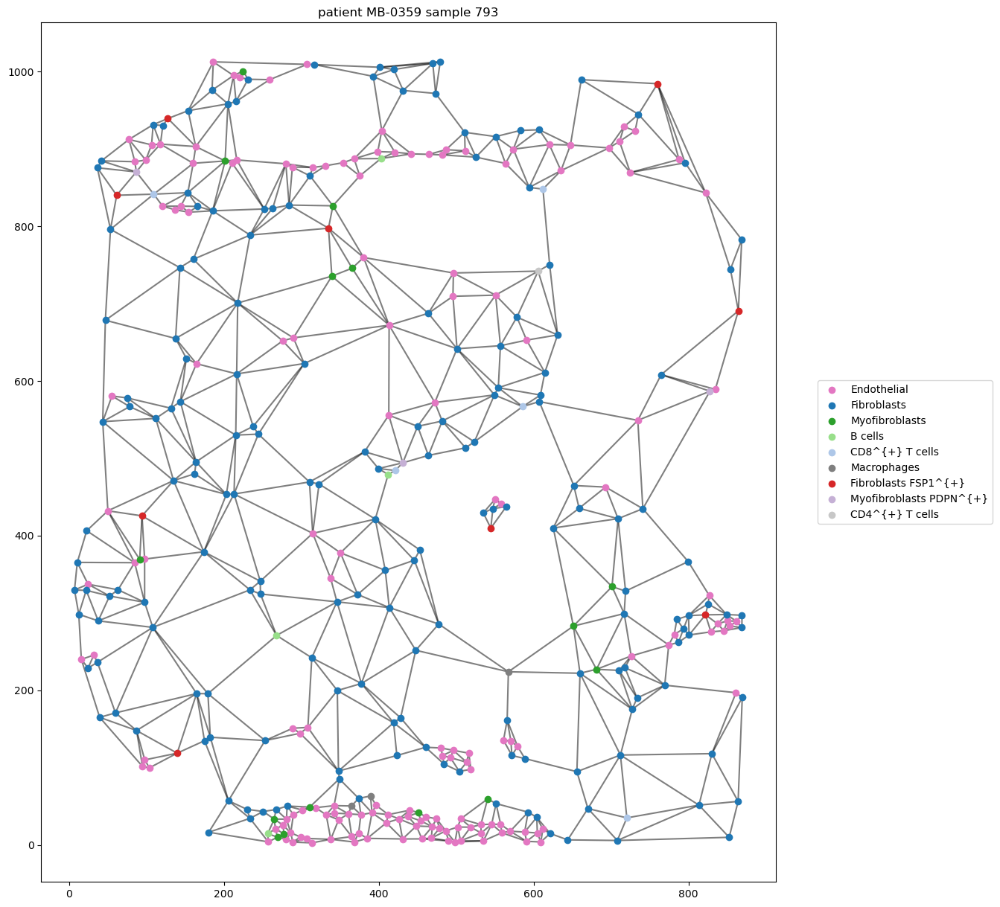

In [116]:
patient_id = 'MB-0359'  # this person has 4 samples
select_patient = obj[patient_col] == patient_id
sample_names = obj.loc[select_patient, sample_col].unique()  # look for the several samples per patient
for sample_name in sample_names:
    print("processing sample {}".format(sample_name))
    select_sample = obj[sample_col] == sample_name
    nodes = obj.loc[select_patient & select_sample, net_cols]
    coords = nodes[pos_cols].values
    pairs = ty.build_delaunay(coords)
    # we want to avoid isolated cells, so we link them to their 3 closest neighbors
    pairs = link_solitaries(coords, pairs, method='delaunay', min_neighbors=3)

    fig, ax = plot_network(
        coords, pairs, labels=nodes[pheno_col],
        color_mapper=celltypes_color_mapper, 
        legend_opt={'loc': 'center left', 'bbox_to_anchor': (1.05, 0.5)},
        )
    plt.title("patient {} sample {}".format(patient_id, sample_name))

### All samples network reconstruction

#### Plot spatial networks

In [117]:
processed_dir = Path('../data/processed/IMC_breast_cancer')
dir_fig_save = processed_dir / 'figures'

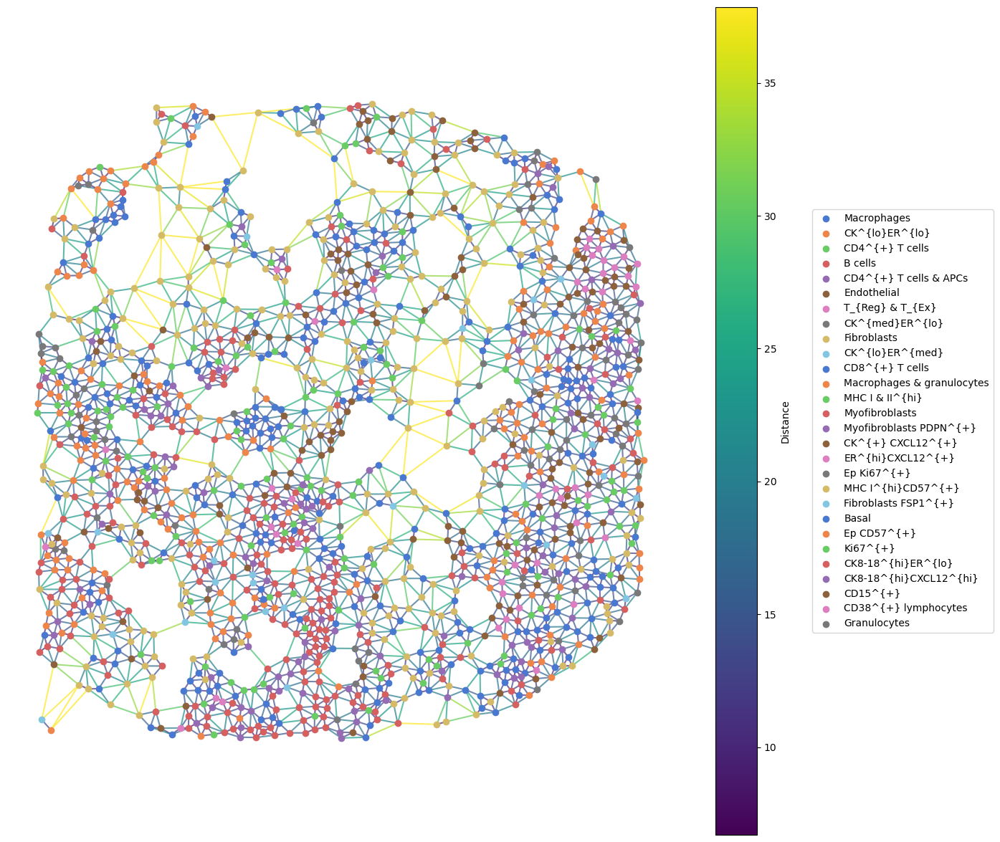

    processing sample 9
    there are 1/1209 nodes with < 3 edges
(1209, 2)
(3429, 2)
(3429,)
(1209,)


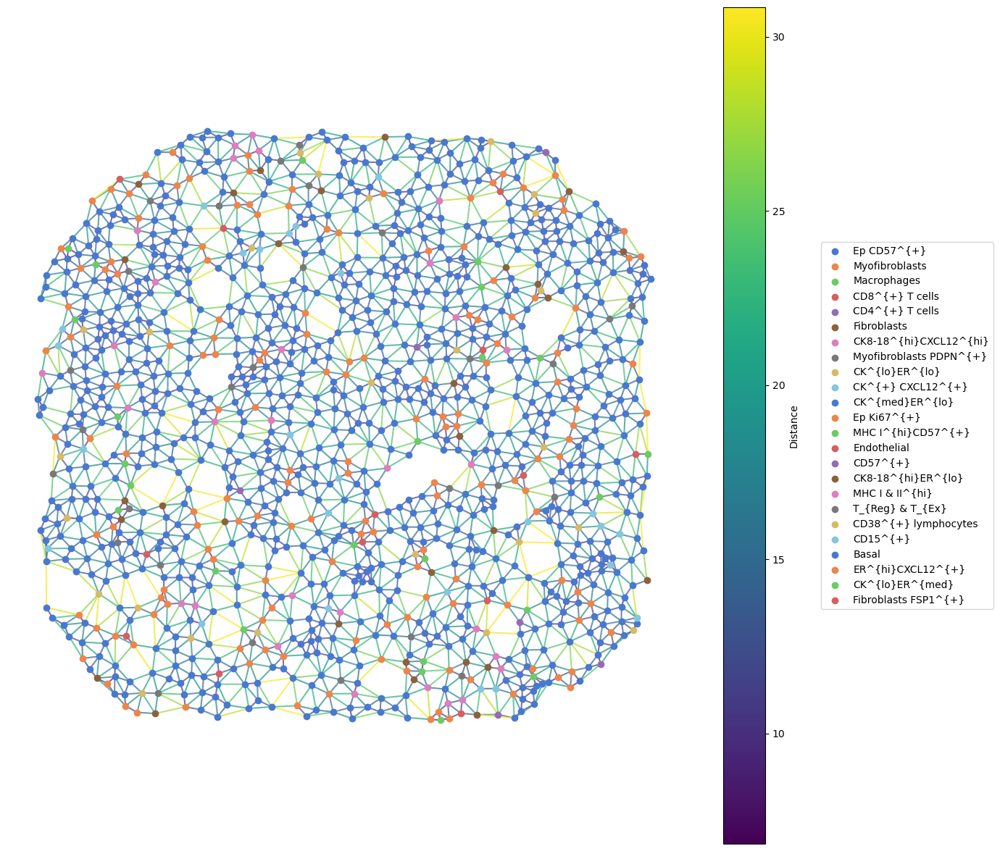

    processing sample 10
    there are 1/1373 nodes with < 3 edges
(1373, 2)
(3842, 2)
(3842,)
(1373,)


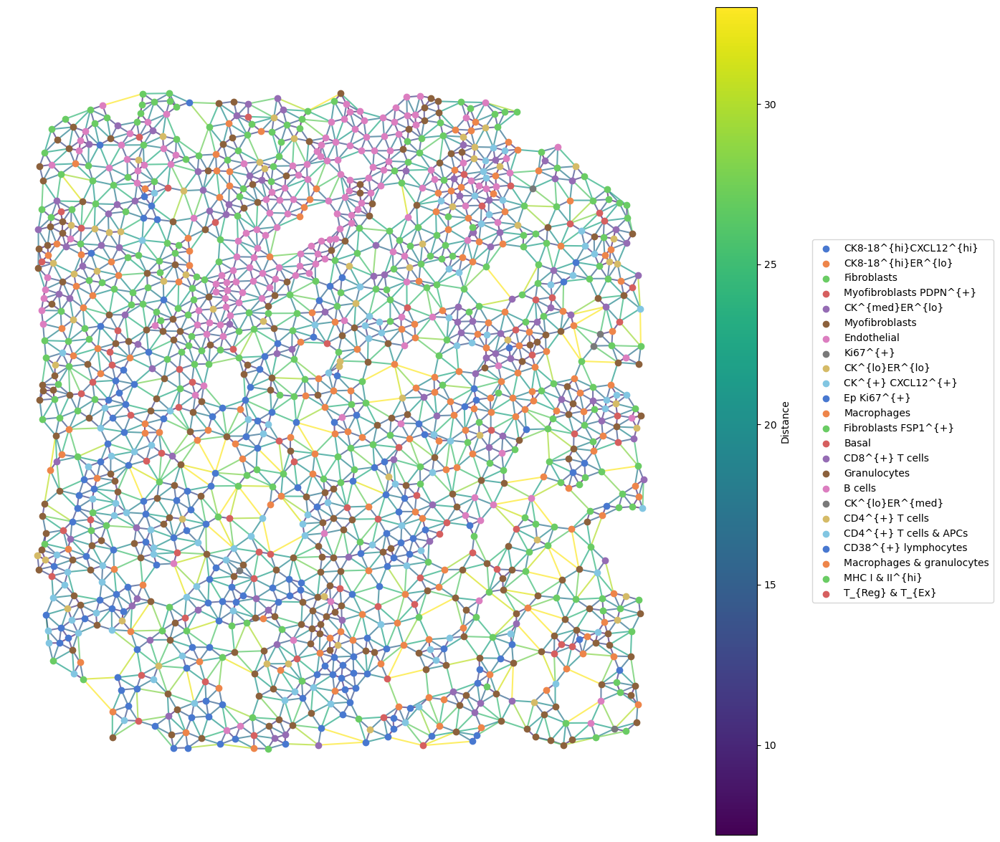

In [126]:
# Choose optimal distance threshold for edge trimming

trim_dist = 200 # or 'percentile_size'
min_neighbors = 3 # number of nearest nodes to connect for each unconneted node

save_dir = processed_dir / f"samples_networks_xy_choose_distance_trim_dist-{trim_dist}_solitary-{min_neighbors}"
save_dir.mkdir(parents=True, exist_ok=True)

# use few networks
samples_dst = obj[sample_col].unique()[:10]

if RUN_LONG:
    for sample_name in samples_dst:
        print("    processing sample {}".format(sample_name))
        select_sample = obj[sample_col] == sample_name
        all_cols = list(set(all_cols))
        nodes = obj.loc[select_sample, all_cols]
        coords = nodes[pos_cols].values
        pairs = build_delaunay(
            coords, 
            node_adaptive_trimming=True, 
            n_edges=3, 
            trim_dist_ratio=2,
            min_dist=0, 
            trim_dist=trim_dist,
            )
        print("    ", end="")

        if min_neighbors > 0:
            pairs = link_solitaries(
                coords, 
                pairs, 
                min_neighbors=min_neighbors,
                )
        distances = distance_neighbors(coords, pairs)

        print(coords.shape)
        print(pairs.shape)
        print(distances.shape)
        print(nodes[pheno_col].shape)

        fig, ax = ty.plot_network_distances(
            coords, pairs, distances, labels=nodes[pheno_col],
            legend_opt={'loc': 'center left', 'bbox_to_anchor': (1.2, 0.5)}
            )
        plt.axis('off');
        title = f"network_distances_sample-{sample_name}"
        plt.savefig(str(save_dir / title) + '.png', bbox_inches='tight', facecolor='white')
        plt.show()

In [156]:
trim_dist = 200 # or 'percentile_size'
min_neighbors = 3 # number of nearest nodes to connect for each unconneted node

reconst_dir = processed_dir / f"samples_networks_xy_min_size-{net_size_threshold}_solitary-{min_neighbors}"
save_dir = reconst_dir / "networks_images_common_cmap_saturated_first"
save_dir.mkdir(parents=True, exist_ok=True)
edges_dir = reconst_dir
nodes_dir = reconst_dir

In [ ]:
if RUN_LONG:
    # avoid displaying networks in notebook and using more memory
    plt.ioff()
    for i, patient_id in enumerate(uniq_patients):
        print(f"processing patient {patient_id} {i}/{len(uniq_patients)}")
        select_patient = obj[patient_col] == patient_id
        samples = obj.loc[select_patient, sample_col].unique()
        for sample in samples:
            print(f"    processing sample {sample}")
            select_sample = obj[sample_col] == sample
            nodes = obj.loc[select_patient & select_sample, all_cols]
            coords = nodes[pos_cols].values
            pairs = build_delaunay(
                coords, 
                node_adaptive_trimming=True, 
                n_edges=3, 
                trim_dist_ratio=2,
                min_dist=0, 
                trim_dist=trim_dist,
                )
            
            if min_neighbors > 0:
                pairs = link_solitaries(
                    coords, 
                    pairs, 
                    min_neighbors=min_neighbors,
                    )

            fig, ax = plot_network(coords, pairs, labels=nodes[pheno_col],
                                      color_mapper=celltypes_color_mapper, 
                                      legend_opt={'loc': 'center left', 'bbox_to_anchor': (1.05, 0.5)})
            plt.axis('off');
            title = f"patient-{patient_id}_sample-{sample}_network_delaunay"
            plt.savefig(str(save_dir / title) + '.png', bbox_inches='tight', facecolor='white')
            # plt.show()
            plt.close(fig)
    plt.ion()

#### Merge all samples

In [160]:
nodes_dir

PosixPath('../data/processed/IMC_breast_cancer/samples_networks_xy_min_size-150_solitary-3')

In [157]:
plt.ion()

In [158]:
n_uniq_patients = len(uniq_patients)
n_uniq_samples = len(uniq_samples)

In [ ]:
# sample_patient_mapper = {}
# for patient_id in uniq_patients:
#     select_patient = obj[patient_col] == patient_id
#     samples = obj.loc[select_patient, sample_col].unique()
#     for sample in samples:
#         sample_patient_mapper[sample] = patient_id

In [132]:
# save networks in separate files
if RUN_LONG:
    for i, patient_id in enumerate(uniq_patients):
        print(f"processing patient {patient_id} {i+1}/{n_uniq_patients}")
        select_patient = obj[patient_col] == patient_id
        samples = obj.loc[select_patient, sample_col].unique()
        for j, sample in enumerate(samples):
            print(f"    processing sample {sample} {i+j+1}/{n_uniq_samples}")
            select_sample = obj[sample_col] == sample
            nodes = obj.loc[select_patient & select_sample, :]
            coords = nodes[pos_cols].values
            pairs = build_delaunay(
                coords, 
                node_adaptive_trimming=True, 
                n_edges=3, 
                trim_dist_ratio=2,
                min_dist=0, 
                trim_dist=trim_dist,
                )
            
            if min_neighbors > 0:
                pairs = link_solitaries(
                    coords, 
                    pairs, 
                    min_neighbors=min_neighbors,
                    verbose=0,
                    )

            edges = pd.DataFrame(data=pairs, columns=['source', 'target'])
            edges.to_parquet(edges_dir / f'edges_patient-{patient_id}_sample-{sample}.parquet', index=False)

            nodes.to_parquet(nodes_dir / f'nodes_patient-{patient_id}_sample-{sample}.parquet', index=False)

processing patient MB-0282 1/683
    processing sample 1 1/756
all nodes have at least 3 edges
processing patient MB-0099 2/683
    processing sample 2 2/756
processing patient MB-0598 3/683
    processing sample 3 3/756
all nodes have at least 3 edges
processing patient MB-0606 4/683
    processing sample 4 4/756
processing patient MB-0190 5/683
    processing sample 5 5/756
all nodes have at least 3 edges
    processing sample 282 6/756
processing patient MB-0201 6/683
    processing sample 6 6/756
processing patient MB-0247 7/683
    processing sample 7 7/756
all nodes have at least 3 edges
processing patient MB-0528 8/683
    processing sample 8 8/756
processing patient MB-0091 9/683
    processing sample 9 9/756
processing patient MB-0211 10/683
    processing sample 10 10/756
processing patient MB-0442 11/683
    processing sample 11 11/756
    processing sample 779 12/756
processing patient MB-0222 12/683
    processing sample 12 12/756
all nodes have at least 3 edges
processing

### Data transfomation and batch correction

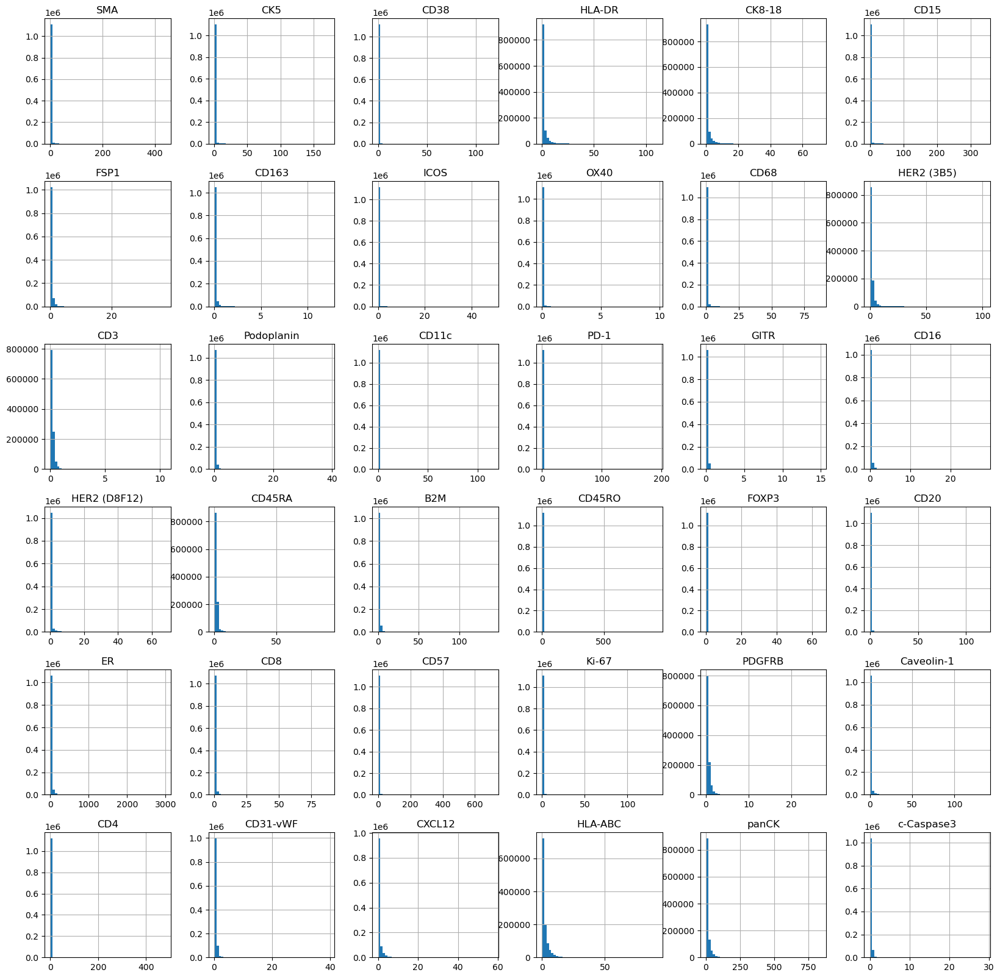

In [133]:
obj[marker_cols].hist(bins=50, figsize=(20, 20));

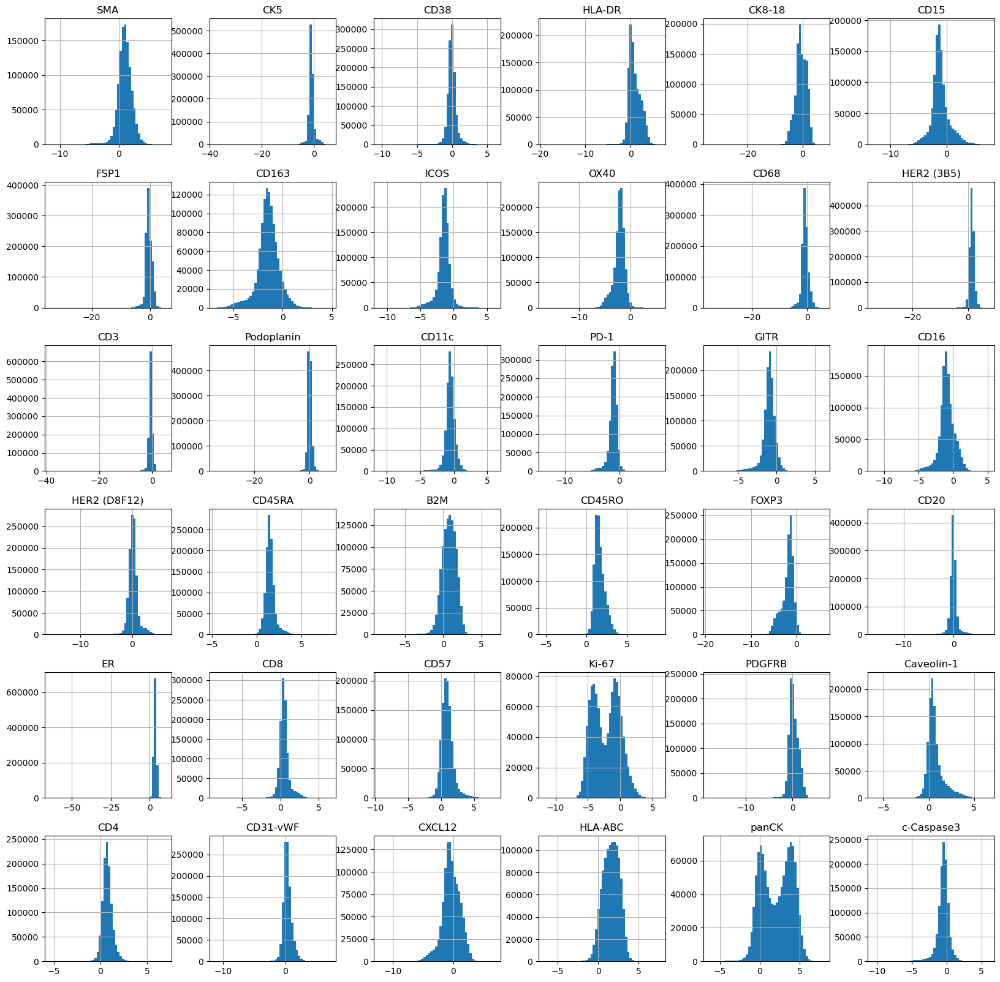

In [134]:
obj_transfo = mosna.transform_data(
    data=obj, 
    groups=sample_col,
    use_cols=marker_cols,
    method='clr')

obj_transfo[marker_cols].hist(bins=50, figsize=(20, 20));
del obj_transfo

In [170]:
nodes_dir = '../data/processed/IMC_breast_cancer/samples_networks_xy_min_size-150_solitary-3/nodes'

In [171]:
nodes_dir = mosna.transform_nodes(
    nodes_dir=nodes_dir,
    id_level_1='patient',
    id_level_2='sample', 
    use_cols=marker_cols,
    method='clr',
    save_dir='auto',
)

### Batch corrrection

#### make UMAP before batch correction

In [172]:
nodes_dir = nodes_dir / 'transfo-clr'
print(nodes_dir)

../data/processed/IMC_breast_cancer/samples_networks_xy_min_size-150_solitary-3/nodes/transfo-clr/transfo-clr


In [180]:
nodes_dir = '../data/processed/IMC_breast_cancer/samples_networks_xy_min_size-150_solitary-3'

In [181]:
reload(mosna)
nodes_agg = mosna.aggregate_nodes(
    nodes_dir=nodes_dir,
    use_cols=marker_cols,
)

In [182]:
# nodes_agg = nodes
print(nodes_agg[marker_cols].shape)
embed_viz, _ = mosna.get_reducer(nodes_agg[marker_cols], nodes_dir)
embed_viz.shape

(1120100, 36)
Computing dimensionality reduction


(1120100, 2)

In [184]:
print(nodes_agg.columns)
nodes_agg.head(2)

Index(['SMA', 'CK5', 'CD38', 'HLA-DR', 'CK8-18', 'CD15', 'FSP1', 'CD163',
       'ICOS', 'OX40', 'CD68', 'HER2 (3B5)', 'CD3', 'Podoplanin', 'CD11c',
       'PD-1', 'GITR', 'CD16', 'HER2 (D8F12)', 'CD45RA', 'B2M', 'CD45RO',
       'FOXP3', 'CD20', 'ER', 'CD8', 'CD57', 'Ki-67', 'PDGFRB', 'Caveolin-1',
       'CD4', 'CD31-vWF', 'CXCL12', 'HLA-ABC', 'panCK', 'c-Caspase3',
       'patient', 'sample'],
      dtype='object')


,SMA,CK5,CD38,HLA-DR,CK8-18,CD15,FSP1,CD163,ICOS,OX40,...,PDGFRB,Caveolin-1,CD4,CD31-vWF,CXCL12,HLA-ABC,panCK,c-Caspase3,patient,sample
0,0.289165,0.094487,0.129224,0.040425,0.105978,0.02680,0.027740,0.026896,0.000000,0.013203,...,0.485309,3.050117,0.047699,0.557617,0.011187,1.019674,0.065495,0.020995,MB-0175,760
1,0.125592,0.099221,0.271576,0.166319,0.298019,0.05158,0.082581,0.064303,0.085092,0.029223,...,0.074623,0.256442,0.309414,0.685215,0.157009,0.295866,4.185409,0.088866,MB-0175,760


In [185]:
print(embed_viz.shape)
print(nodes_agg.shape)

(1120100, 2)
(1120100, 38)


embed_viz (1120100, 2)
select 0          False
1          False
2          False
3          False
4          False
           ...  
1120095    False
1120096    False
1120097    False
1120098    False
1120099    False
Name: patient, Length: 1120100, dtype: bool
select.value_counts patient
False    1108052
True       12048
Name: count, dtype: int64
embed_viz (1120100, 2)
select 0          False
1          False
2          False
3          False
4          False
           ...  
1120095    False
1120096    False
1120097    False
1120098    False
1120099    False
Name: patient, Length: 1120100, dtype: bool
select.value_counts patient
False    1108869
True       11231
Name: count, dtype: int64
embed_viz (1120100, 2)
select 0          False
1          False
2          False
3          False
4          False
           ...  
1120095    False
1120096    False
1120097    False
1120098    False
1120099    False
Name: patient, Length: 1120100, dtype: bool
select.value_counts patient
False    1110

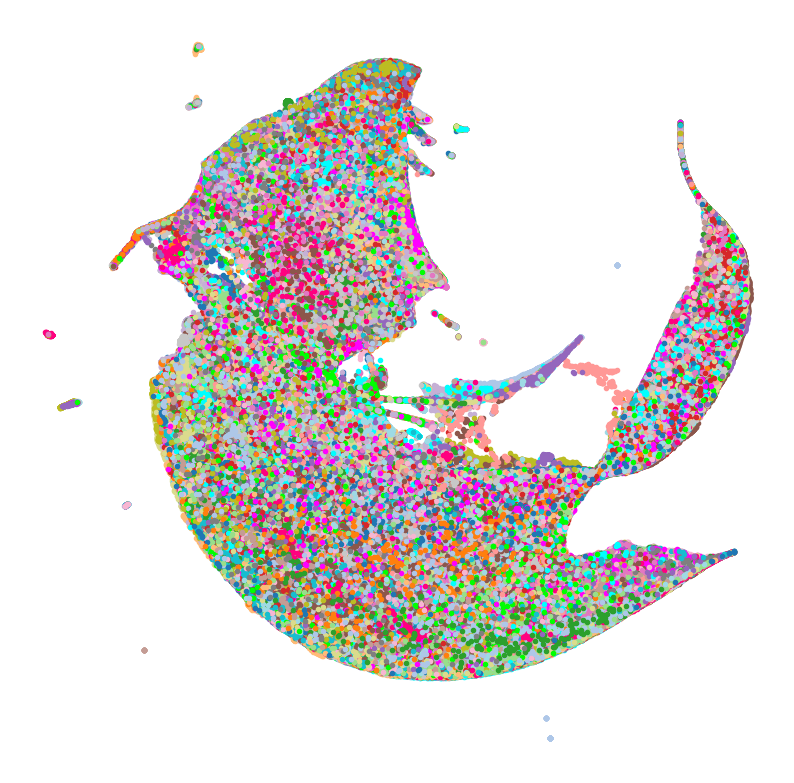

In [196]:
reload(mosna)
fig, ax, color_mapper = mosna.plot_clusters(
    embed_viz, 
    cluster_labels=nodes_agg['patient'], 
    save_dir=None,
    return_cmap=True,
    show_id=False,
    legend=False,
    )

embed_viz (1120100, 2)
select 0          False
1          False
2          False
3          False
4          False
           ...  
1120095    False
1120096    False
1120097    False
1120098    False
1120099    False
Name: sample, Length: 1120100, dtype: bool
select.value_counts sample
False    1110524
True        9576
Name: count, dtype: int64
embed_viz (1120100, 2)
select 0          False
1          False
2          False
3          False
4          False
           ...  
1120095    False
1120096    False
1120097    False
1120098    False
1120099    False
Name: sample, Length: 1120100, dtype: bool
select.value_counts sample
False    1112240
True        7860
Name: count, dtype: int64
embed_viz (1120100, 2)
select 0          False
1          False
2          False
3          False
4          False
           ...  
1120095    False
1120096    False
1120097    False
1120098    False
1120099    False
Name: sample, Length: 1120100, dtype: bool
select.value_counts sample
False    1112741
Tr

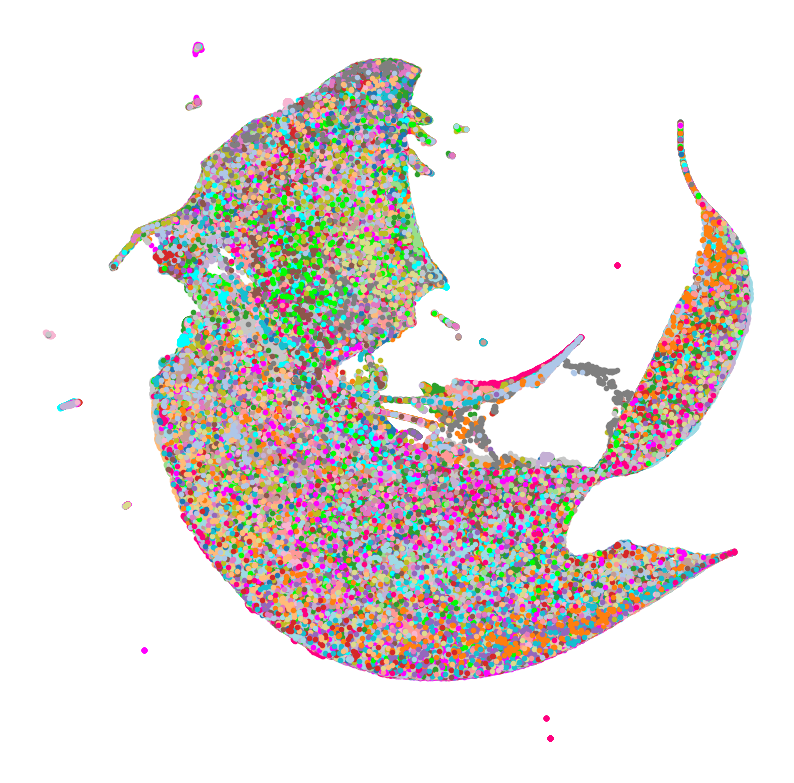

In [194]:
reload(mosna)
fig, ax, color_mapper = mosna.plot_clusters(
    embed_viz, 
    cluster_labels=nodes_agg['patient'], 
    save_dir=None,
    return_cmap=True,
    show_id=False,
    legend=False,
    )

In [197]:
! pip install scanorama

#### Perform batch correction

In [ ]:
reload(mosna)
import scanorama
nodes_dir, nodes_corr = mosna.batch_correct_nodes(
    nodes_dir=nodes_dir,
    use_cols=marker_cols,
    batch_key='patient',
    return_nodes=True,
)

In [205]:
# embed_viz, _ = mosna.get_reducer(nodes_corr[marker_cols], nodes_dir)
embed_viz, _ = mosna.get_reducer(nodes_agg[marker_cols], nodes_dir)
print(nodes_agg.columns)

Loading reducer object and reduced coordinates
Index(['SMA', 'CK5', 'CD38', 'HLA-DR', 'CK8-18', 'CD15', 'FSP1', 'CD163',
       'ICOS', 'OX40', 'CD68', 'HER2 (3B5)', 'CD3', 'Podoplanin', 'CD11c',
       'PD-1', 'GITR', 'CD16', 'HER2 (D8F12)', 'CD45RA', 'B2M', 'CD45RO',
       'FOXP3', 'CD20', 'ER', 'CD8', 'CD57', 'Ki-67', 'PDGFRB', 'Caveolin-1',
       'CD4', 'CD31-vWF', 'CXCL12', 'HLA-ABC', 'panCK', 'c-Caspase3',
       'patient', 'sample'],
      dtype='object')


embed_viz (1120100, 2)
select 0          False
1          False
2          False
3          False
4          False
           ...  
1120095    False
1120096    False
1120097    False
1120098    False
1120099    False
Name: patient, Length: 1120100, dtype: bool
select.value_counts patient
False    1108052
True       12048
Name: count, dtype: int64
embed_viz (1120100, 2)
select 0          False
1          False
2          False
3          False
4          False
           ...  
1120095    False
1120096    False
1120097    False
1120098    False
1120099    False
Name: patient, Length: 1120100, dtype: bool
select.value_counts patient
False    1108869
True       11231
Name: count, dtype: int64
embed_viz (1120100, 2)
select 0          False
1          False
2          False
3          False
4          False
           ...  
1120095    False
1120096    False
1120097    False
1120098    False
1120099    False
Name: patient, Length: 1120100, dtype: bool
select.value_counts patient
False    1110

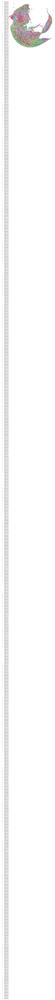

In [206]:
fig, ax, color_mapper = mosna.plot_clusters(
    embed_viz, 
    cluster_labels=nodes_agg['patient'], 
    save_dir=None,
    return_cmap=True,
    show_id=False,
    )

## Response groups characteristics and survival analysis

We will look at what variables define or explain response to therapy or longer survival.  
For this, we will start with the simplest statistics, like proportions of cell types or marker-positive cells, and we will gradulally increase the complexity of variables, looking at interactions between cell types and finally discovering spatial neighborhoods, or "niches", potentially predictive of response to therapy.

### Cell types proportions

In [207]:
# we add attributes to nodes to color network figures
nodes_all = obj[pos_cols + [pheno_col]].copy()
nodes_all = nodes_all.join(pd.get_dummies(obj[pheno_col]))
uniq_phenotypes = nodes_all[pheno_col].unique()  # 'attribute_uniq' in other notebooks

In [208]:
# here we don't use `sample_col` but `patient_col` in the group / unstack procedure to aggregate 
# statistics per patient and condition rather than per sample.

count_types = obj[[patient_col, pheno_col, sample_col]].groupby([patient_col, pheno_col]).count().unstack()
count_types.columns = count_types.columns.droplevel()
count_types = count_types.fillna(value=0).astype(int)
# count_types.index.name = 'sample'
count_types.to_csv(save_dir / 'count_types_per_patient.csv')
count_types

cellPhenotype,B cells,Basal,CD15^{+},CD38^{+} lymphocytes,CD4^{+} T cells,CD4^{+} T cells & APCs,CD57^{+},CD8^{+} T cells,CK8-18^{+} ER^{hi},CK8-18^{hi}CXCL12^{hi},...,HER2^{+},Ki67^{+},MHC I & II^{hi},MHC I^{hi}CD57^{+},MHC^{hi}CD15^{+},Macrophages,Macrophages & granulocytes,Myofibroblasts,Myofibroblasts PDPN^{+},T_{Reg} & T_{Ex}
metabric_id,,,,,,,,,,,,,,,,,,,,,
MB-0000,1,0,0,0,0,0,0,4,1,10,...,0,0,0,0,0,3,0,4,0,0
MB-0002,0,0,1,0,2,0,0,7,0,892,...,0,0,0,0,0,8,0,287,5,0
MB-0005,1,0,706,0,0,0,0,11,1,19,...,3,0,0,0,0,8,3,460,6,0
MB-0006,1,17,0,5,4,0,0,4,0,94,...,0,0,0,0,0,7,0,86,0,0
MB-0010,1,0,2,6,13,5,0,8,1018,0,...,0,3,7,1,0,50,0,63,45,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MB-3824,3,1,20,3,5,0,0,1,0,3,...,1,0,0,0,0,28,0,106,6,0
MB-3838,0,0,130,0,1,0,2,9,0,14,...,0,0,0,0,0,1,0,68,5,1
MB-3854,0,1,85,0,11,0,0,15,1,7,...,0,0,0,0,0,6,0,40,6,0


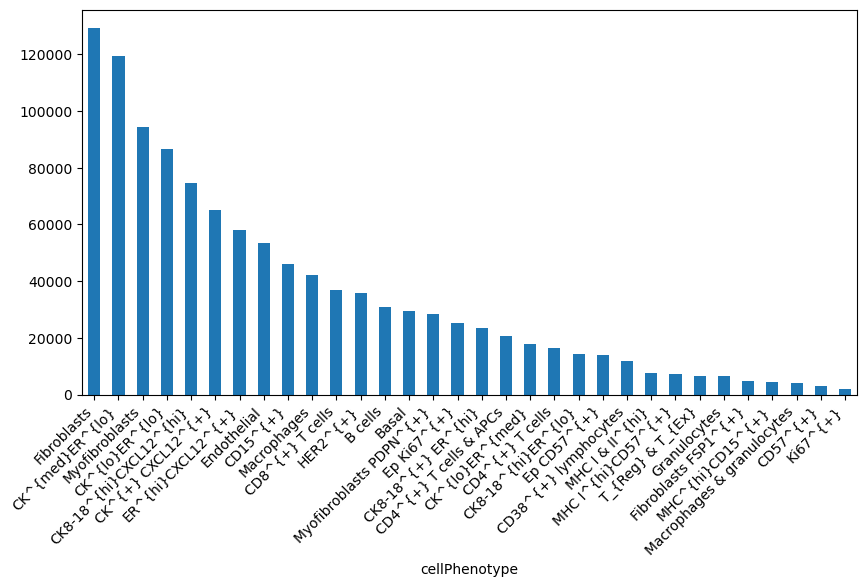

In [209]:
total_count_types = count_types.sum().sort_values(ascending=False)
ax = total_count_types.plot.bar(figsize=(10, 5))
plt.xticks(rotation=45, ha='right');
plt.savefig(save_dir / 'cell_types_counts.jpg', bbox_inches='tight', facecolor='white', dpi=600)

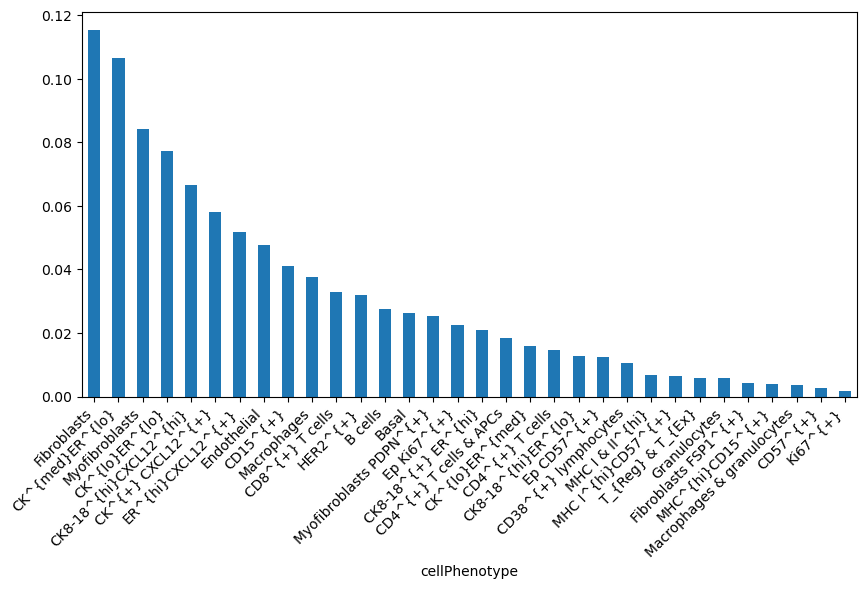

In [210]:
total_prop_types = total_count_types / total_count_types.sum()
ax = total_prop_types.plot.bar(figsize=(10, 5))
plt.xticks(rotation=45, ha='right');
plt.savefig(save_dir / 'cell_types_proportions.jpg', bbox_inches='tight', facecolor='white', dpi=600)

In [211]:
total_prop_types

cellPhenotype
Fibroblasts                   0.115381
CK^{med}ER^{lo}               0.106503
Myofibroblasts                0.084309
CK^{lo}ER^{lo}                0.077268
CK8-18^{hi}CXCL12^{hi}        0.066699
CK^{+} CXCL12^{+}             0.057945
ER^{hi}CXCL12^{+}             0.051871
Endothelial                   0.047712
CD15^{+}                      0.041180
Macrophages                   0.037662
CD8^{+} T cells               0.033002
HER2^{+}                      0.032066
B cells                       0.027448
Basal                         0.026411
Myofibroblasts PDPN^{+}       0.025333
Ep Ki67^{+}                   0.022492
CK8-18^{+} ER^{hi}            0.020960
CD4^{+} T cells & APCs        0.018287
CK^{lo}ER^{med}               0.015993
CD4^{+} T cells               0.014650
CK8-18^{hi}ER^{lo}            0.012790
Ep CD57^{+}                   0.012332
CD38^{+} lymphocytes          0.010551
MHC I & II^{hi}               0.006785
MHC I^{hi}CD57^{+}            0.006449
T_{Reg} & T

Instead of counts we use proportions of cell types per patient and condition.

In [212]:
prop_types = count_types.div(count_types.sum(axis=1), axis=0)
prop_types

cellPhenotype,B cells,Basal,CD15^{+},CD38^{+} lymphocytes,CD4^{+} T cells,CD4^{+} T cells & APCs,CD57^{+},CD8^{+} T cells,CK8-18^{+} ER^{hi},CK8-18^{hi}CXCL12^{hi},...,HER2^{+},Ki67^{+},MHC I & II^{hi},MHC I^{hi}CD57^{+},MHC^{hi}CD15^{+},Macrophages,Macrophages & granulocytes,Myofibroblasts,Myofibroblasts PDPN^{+},T_{Reg} & T_{Ex}
metabric_id,,,,,,,,,,,,,,,,,,,,,
MB-0000,0.003968,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.015873,0.003968,0.039683,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.011905,0.000000,0.015873,0.000000,0.000000
MB-0002,0.000000,0.000000,0.000473,0.000000,0.000946,0.000000,0.000000,0.003310,0.000000,0.421749,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.003783,0.000000,0.135697,0.002364,0.000000
MB-0005,0.000641,0.000000,0.452854,0.000000,0.000000,0.000000,0.000000,0.007056,0.000641,0.012187,...,0.001924,0.000000,0.000000,0.000000,0.000000,0.005131,0.001924,0.295061,0.003849,0.000000
MB-0006,0.001235,0.020988,0.000000,0.006173,0.004938,0.000000,0.000000,0.004938,0.000000,0.116049,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.008642,0.000000,0.106173,0.000000,0.000000
MB-0010,0.000716,0.000000,0.001433,0.004298,0.009312,0.003582,0.000000,0.005731,0.729226,0.000000,...,0.000000,0.002149,0.005014,0.000716,0.000000,0.035817,0.000000,0.045129,0.032235,0.000716
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MB-3824,0.005736,0.001912,0.038241,0.005736,0.009560,0.000000,0.000000,0.001912,0.000000,0.005736,...,0.001912,0.000000,0.000000,0.000000,0.000000,0.053537,0.000000,0.202677,0.011472,0.000000
MB-3838,0.000000,0.000000,0.275424,0.000000,0.002119,0.000000,0.004237,0.019068,0.000000,0.029661,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.002119,0.000000,0.144068,0.010593,0.002119
MB-3854,0.000000,0.002342,0.199063,0.000000,0.025761,0.000000,0.000000,0.035129,0.002342,0.016393,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.014052,0.000000,0.093677,0.014052,0.000000


In [213]:
surv_orig = surv.copy()
surv = surv.loc[~surv['isValidation'], :]
surv.drop(columns=['isValidation'], inplace=True)

In [214]:
surv

,ERStatus,LymphNodesOrdinal,sizeOrdinal,Grade,ERBB2_pos,yearsToStatus,DeathBreast,PAM50,IntClust
metabric_id,,,,,,,,,
MB-0000,pos,7+,20-50mm,3.0,False,11.540041,0,Normal-like,IntClust 4+
MB-0002,pos,0,5-10mm,3.0,False,6.951403,0,Luminal A,IntClust 4+
MB-0005,pos,1,10-20mm,2.0,False,13.445585,1,Luminal B,IntClust 3
MB-0006,pos,2-3,20-50mm,2.0,False,13.546886,0,Luminal B,IntClust 9
MB-0008,pos,7+,20-50mm,3.0,False,3.397673,1,Luminal B,IntClust 9
...,...,...,...,...,...,...,...,...,...
MB-3688,pos,0,20-50mm,3.0,NaN,2.179329,1,NaN,NaN
MB-3692,pos,1,20-50mm,3.0,NaN,5.089665,1,NaN,NaN
MB-3747,pos,0,20-50mm,2.0,NaN,18.877481,0,NaN,NaN


In [215]:
# replace some values with numbers for fitting
mapper_str = {
    'pos': 1,
    'neg': 0,
    np.nan: np.nan,
}
surv.loc[:, 'ERStatus'] = surv['ERStatus'].map(mapper_str)

mapper_bool = {
    True: 1,
    False: 0,
    np.nan: np.nan,
}
surv.loc[:, 'ERBB2_pos'] = surv['ERBB2_pos'].map(mapper_bool)

In [216]:
surv.sample(3)

,ERStatus,LymphNodesOrdinal,sizeOrdinal,Grade,ERBB2_pos,yearsToStatus,DeathBreast,PAM50,IntClust
metabric_id,,,,,,,,,
MB-0574,1.0,1,20-50mm,3.0,0.0,9.839836,0,Luminal A,IntClust 2
MB-0421,1.0,0,20-50mm,3.0,1.0,7.638604,0,HER2,IntClust 5+
MB-0662,1.0,0,10-20mm,3.0,1.0,5.733060,1,Normal-like,IntClust 5+


In [217]:
duration_col = 'yearsToStatus'
event_col = 'DeathBreast'
covariates = ['ERStatus'] #, 'ERBB2_pos'] # else []
strata = 'ERStatus'
drop_last_column = True   # because we use proportions last column is fully determined
drop_nan = True
if drop_last_column:
    df_surv = prop_types.iloc[:, :-1].join(surv[[duration_col, event_col] + covariates], how='inner')
else:
    df_surv = prop_types.join(surv[[duration_col, event_col] + covariates], how='inner')
if drop_nan:
    n_obs_orig = len(df_surv)
    df_surv.dropna(axis=0, inplace=True)
    n_obs = len(df_surv)
    if n_obs != n_obs_orig:
        print(f'discarded {n_obs_orig - n_obs} / {n_obs_orig} observations with NaN')

discarded 15 / 509 observations with NaN


In [218]:
df_surv

,B cells,Basal,CD15^{+},CD38^{+} lymphocytes,CD4^{+} T cells,CD4^{+} T cells & APCs,CD57^{+},CD8^{+} T cells,CK8-18^{+} ER^{hi},CK8-18^{hi}CXCL12^{hi},...,MHC I & II^{hi},MHC I^{hi}CD57^{+},MHC^{hi}CD15^{+},Macrophages,Macrophages & granulocytes,Myofibroblasts,Myofibroblasts PDPN^{+},yearsToStatus,DeathBreast,ERStatus
metabric_id,,,,,,,,,,,,,,,,,,,,,
MB-0000,0.003968,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.015873,0.003968,0.039683,...,0.000000,0.000000,0.000000,0.011905,0.000000,0.015873,0.000000,11.540041,0,1.0
MB-0002,0.000000,0.000000,0.000473,0.000000,0.000946,0.000000,0.0,0.003310,0.000000,0.421749,...,0.000000,0.000000,0.000000,0.003783,0.000000,0.135697,0.002364,6.951403,0,1.0
MB-0005,0.000641,0.000000,0.452854,0.000000,0.000000,0.000000,0.0,0.007056,0.000641,0.012187,...,0.000000,0.000000,0.000000,0.005131,0.001924,0.295061,0.003849,13.445585,1,1.0
MB-0006,0.001235,0.020988,0.000000,0.006173,0.004938,0.000000,0.0,0.004938,0.000000,0.116049,...,0.000000,0.000000,0.000000,0.008642,0.000000,0.106173,0.000000,13.546886,0,1.0
MB-0010,0.000716,0.000000,0.001433,0.004298,0.009312,0.003582,0.0,0.005731,0.729226,0.000000,...,0.005014,0.000716,0.000000,0.035817,0.000000,0.045129,0.032235,0.640657,1,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MB-3688,0.000429,0.002575,0.000858,0.000000,0.014163,0.008155,0.0,0.014592,0.000000,0.000000,...,0.001717,0.000000,0.000000,0.020601,0.000000,0.297425,0.057511,2.179329,1,1.0
MB-3692,0.019431,0.000000,0.006161,0.155450,0.009953,0.099052,0.0,0.059242,0.000000,0.027488,...,0.011848,0.000948,0.000948,0.024645,0.017062,0.045972,0.067773,5.089665,1,1.0
MB-3747,0.000000,0.000000,0.000000,0.000000,0.000808,0.000000,0.0,0.012126,0.000000,0.383994,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.172191,0.000808,18.877481,0,1.0


In [219]:
cph = CoxPHFitter(penalizer=0.0001)
if strata is None:
    cph.fit(df_surv, duration_col=duration_col, event_col=event_col)
else:
    cph.fit(df_surv, duration_col=duration_col, event_col=event_col, strata=strata)

# if convergence fails, use CoxPHFitter(penalizer=0.1).fit(…)
cph.print_summary()

/home/abdelmounim.essabbar/anaconda3/lib/python3.11/site-packages/lifelines/utils/__init__.py:1100: ConvergenceWarning: Column(s) ['Fibroblasts FSP1^{+}', 'Ki67^{+}'] have very low variance. This may harm convergence. 1) Are you using formula's? Did you mean to add '-1' to the end. 2) Try dropping this redundant column before fitting if convergence fails.

  warnings.warn(dedent(warning_text), ConvergenceWarning)


model,lifelines.CoxPHFitter
duration col,'yearsToStatus'
event col,'DeathBreast'
penalizer,0.0001
l1 ratio,0.0
strata,ERStatus
baseline estimation,breslow
number of observations,494
number of events observed,155
partial log-likelihood,-756.55
time fit was run,2024-05-30 11:19:17 UTC


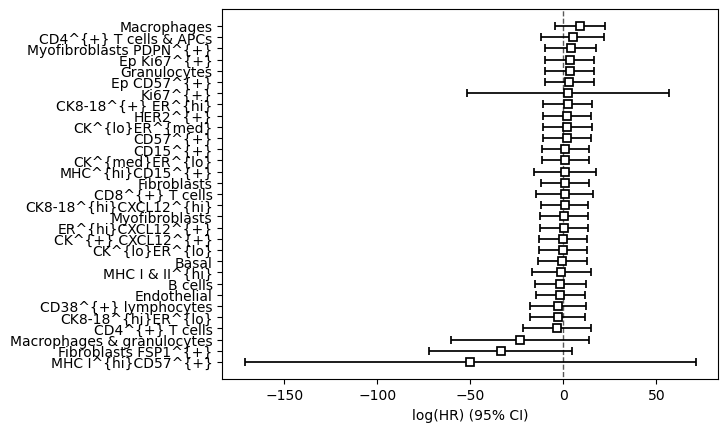

In [220]:
cph.plot();

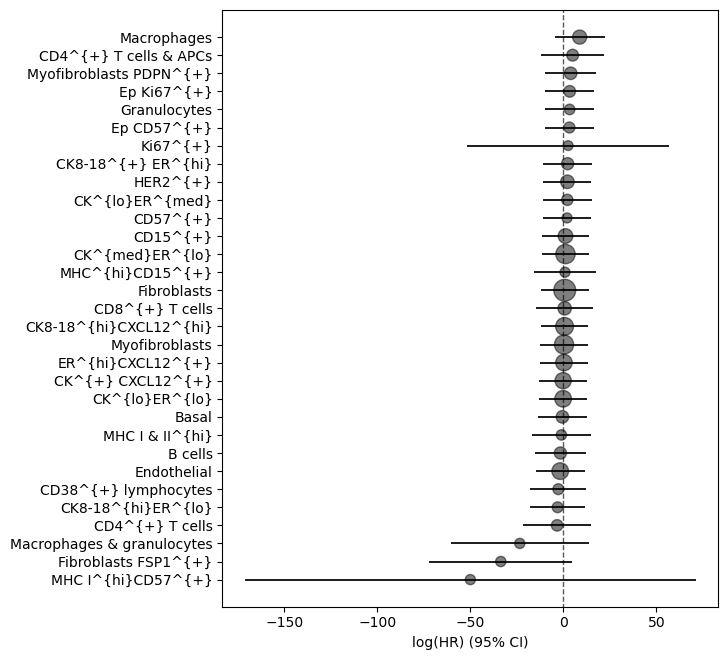

In [223]:
# Plot coefficients
ax = mosna.plot_survival_coeffs(
    model=cph, 
    data=df_surv,
    )
# ax.set_title(f'n sig: {n_sig} {str_params}')
figname = f"cell_types_proportions_CoxPH_coefficients.jpg"
plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

# for variable_name in coefs_sig:
#     best_thresh, best_perc, best_p_val = mosna.find_best_survival_threshold(df_surv, variable_name, duration_col, event_col)
#     print(variable_name)
#     print(f'best_thresh: {best_thresh:.3g}')
#     print(f'best_perc: {best_perc:.3g}')
#     print(f'best_p_val: {best_p_val:.3g}')
#     mosna.plot_survival_threshold(df_surv, variable_name, duration_col, event_col, best_thresh)
#     if save_fig:
#         figname = f"{str_params}_survival_curve_{variable_name}.jpg"
#         plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
#     plt.show()

<Axes: >

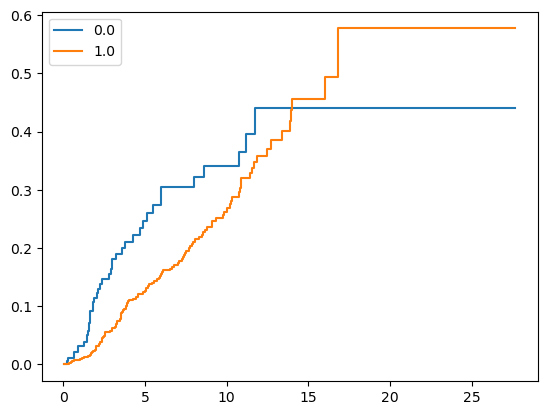

In [224]:
cph.baseline_cumulative_hazard_.plot(drawstyle="steps")

Try if better convergence by dropping low variance columns will help

In [225]:
col_exclude = ['Fibroblasts FSP1^{+}', 'Ki67^{+}']
use_cols = [x for x in prop_types.columns if x not in col_exclude]

drop_last_column = False   # we have already dropped some columns
drop_nan = True
if drop_last_column:
    df_surv = prop_types[use_cols].iloc[:, :-1].join(surv[[duration_col, event_col] + covariates], how='inner')
else:
    df_surv = prop_types[use_cols].join(surv[[duration_col, event_col] + covariates], how='inner')
if drop_nan:
    n_obs_orig = len(df_surv)
    df_surv.dropna(axis=0, inplace=True)
    n_obs = len(df_surv)
    if n_obs != n_obs_orig:
        print(f'discarded {n_obs_orig - n_obs} / {n_obs_orig} observations with NaN')

discarded 15 / 509 observations with NaN


In [226]:
# cph = CoxPHFitter()  # convergence warnings
cph = CoxPHFitter(penalizer=0.0001)  # solves the issue
if strata is None:
    cph.fit(df_surv, duration_col=duration_col, event_col=event_col)
else:
    cph.fit(df_surv, duration_col=duration_col, event_col=event_col, strata=strata)
# but changing step_size doesn't solve the convergence issue:
# cph.fit(df_surv, duration_col=duration_col, event_col=event_col, strata=['ERStatus'], 
#         fit_options={'step_size': 0.50})

# if convergence fails, use CoxPHFitter(penalizer=0.1).fit(…)
cph.print_summary()

model,lifelines.CoxPHFitter
duration col,'yearsToStatus'
event col,'DeathBreast'
penalizer,0.0001
l1 ratio,0.0
strata,ERStatus
baseline estimation,breslow
number of observations,494
number of events observed,155
partial log-likelihood,-757.96
time fit was run,2024-05-30 11:20:15 UTC


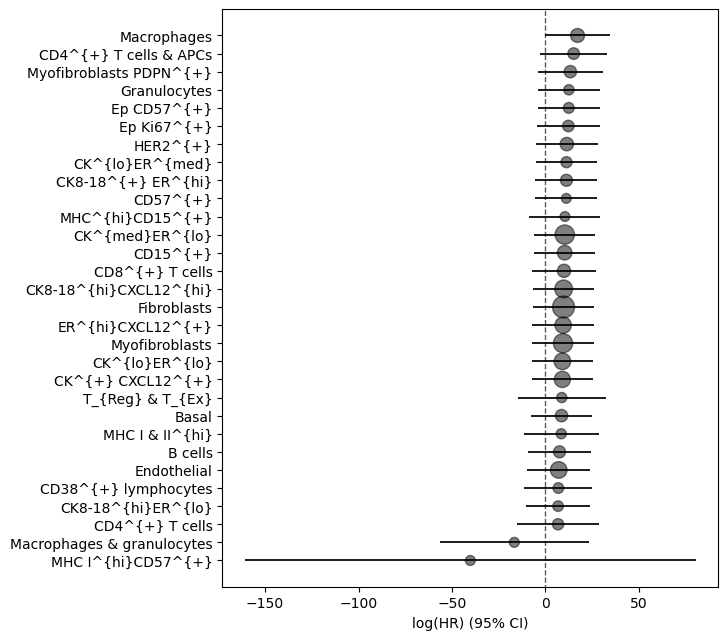

In [227]:
# Plot coefficients
ax = mosna.plot_survival_coeffs(
    model=cph, 
    data=df_surv,
    )
# ax.set_title(f'n sig: {n_sig} {str_params}')
figname = f"cell_types_proportions_better_convergence_CoxPH_coefficients.jpg"
plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

<Axes: >

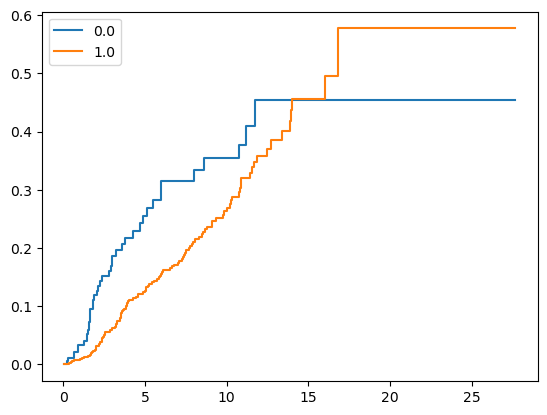

In [228]:
cph.baseline_cumulative_hazard_.plot(drawstyle="steps")

In [ ]:
# cph.variance_matrix_
# cph.params_
# cph.baseline_hazard_    # 473 × 2
# cph.baseline_cumulative_hazard_  # 473 × 2
# cph._predicted_partial_hazards_
# cph.standard_errors_
# cph.confidence_intervals_
# cph.baseline_survival_   # 473 × 2
# cph.concordance_index_  # float

In [229]:
if strata is not None:
    print(df_surv.groupby(strata).size())
# there is high class imbalance, but many observations from the smallest class

ERStatus
0.0     99
1.0    395
dtype: int64


Some cell type proportions seem nearly statistically significant

### Ratio of cell type proportions

In [230]:
# `find_DE_markers` can make composite variables, but we do it beforehand to reuse them
composed_variables = mosna.make_composed_variables(prop_types, order=1)
prop_types_comp = pd.concat([prop_types, composed_variables], axis=1)
# with survival data there is no pval to compute

In [231]:
# we need to clean-up data for further analyses and visualizations
# otherwise some visualization tools and ML models break with NaN and inf
prop_types_comp_cleaned, select_finite = mosna.clean_data(
    prop_types_comp, 
    method='mixed',
    thresh=0.9,
    )

There are 51421 non finite values (14.3%)
Imputing data


In [236]:
col_exclude = []
use_data_surv = prop_types_comp_cleaned
use_cols = [x for x in use_data_surv.columns if x not in col_exclude]

drop_last_column = False   # no need here
drop_nan = True
if drop_last_column:
    df_surv = use_data_surv[use_cols].iloc[:, :-1].join(surv[[duration_col, event_col] + covariates], how='inner')
else:
    df_surv = use_data_surv[use_cols].join(surv[[duration_col, event_col] + covariates], how='inner')
if drop_nan:
    n_obs_orig = len(df_surv)
    df_surv.dropna(axis=0, inplace=True)
    n_obs = len(df_surv)
    if n_obs != n_obs_orig:
        print(f'discarded {n_obs_orig - n_obs} / {n_obs_orig} observations with NaN')

discarded 15 / 509 observations with NaN


In [237]:
cph = CoxPHFitter() 
if strata is None:
    cph.fit(df_surv, duration_col=duration_col, event_col=event_col)
else:
    cph.fit(df_surv, duration_col=duration_col, event_col=event_col, strata=strata)
cph.print_summary()

/home/abdelmounim.essabbar/anaconda3/lib/python3.11/site-packages/lifelines/utils/__init__.py:1100: ConvergenceWarning: Column(s) ['Fibroblasts FSP1^{+}', 'Ki67^{+}'] have very low variance. This may harm convergence. 1) Are you using formula's? Did you mean to add '-1' to the end. 2) Try dropping this redundant column before fitting if convergence fails.

  warnings.warn(dedent(warning_text), ConvergenceWarning)
/home/abdelmounim.essabbar/anaconda3/lib/python3.11/site-packages/lifelines/utils/__init__.py:990: ConvergenceWarning: Your dataset has more variables than samples. Even with a penalizer (which you must use), convergence is not guaranteed.

  warnings.warn(warning_text, ConvergenceWarning)


ConvergenceError: Convergence halted due to matrix inversion problems. Suspicion is high collinearity. Please see the following tips in the lifelines documentation: https://lifelines.readthedocs.io/en/latest/Examples.html#problems-with-convergence-in-the-cox-proportional-hazard-modelMatrix is singular.

Let's see what this particular variable look like:

In [234]:
events = df_surv['DeathBreast'].astype(bool)
print(df_surv.loc[events, 'CD57^{+} / MHC^{hi}CD15^{+}'].var())
print(df_surv.loc[~events, 'CD57^{+} / MHC^{hi}CD15^{+}'].var())

# A very low variance means that the column CD57^{+} / MHC^{hi}CD15^{+} completely determines whether a subject dies or not. 

KeyError: 'CD57^{+} / MHC^{hi}CD15^{+}'

In [235]:
# dataframe of predictive variable(s)
pred_cols = ['CD57^{+} / MHC^{hi}CD15^{+}']
df_predvar = df_surv[pred_cols]
df_predvar['events'] = events
print(df_surv.loc[~events, 'CD57^{+} / MHC^{hi}CD15^{+}'].mean())
print(df_surv.loc[events, 'CD57^{+} / MHC^{hi}CD15^{+}'].mean())
df_predvar.hist(bins=20)

KeyError: "None of [Index(['CD57^{+} / MHC^{hi}CD15^{+}'], dtype='object')] are in the [columns]"

In [ ]:
sns.boxplot(df_predvar, y=pred_cols[0],
            hue='events', palette=["m", "g"])

In [238]:
# use_data_surv = prop_types_comp_cleaned
use_data_surv = prop_types_comp
use_cols = [x for x in use_data_surv.columns if x not in col_exclude]

drop_last_column = False   # no need here
drop_nan = False
if drop_last_column:
    df_surv = use_data_surv[use_cols].iloc[:, :-1].join(surv[[duration_col, event_col] + covariates], how='inner')
else:
    df_surv = use_data_surv[use_cols].join(surv[[duration_col, event_col] + covariates], how='inner')
if drop_nan:
    n_obs_orig = len(df_surv)
    df_surv.dropna(axis=0, inplace=True)
    n_obs = len(df_surv)
    if n_obs != n_obs_orig:
        print(f'discarded {n_obs_orig - n_obs} / {n_obs_orig} observations with NaN')

In [239]:
df_surv[pred_cols].isna().sum()

KeyError: "None of [Index(['CD57^{+} / MHC^{hi}CD15^{+}'], dtype='object')] are in the [columns]"

In [240]:
df_surv[pred_cols].value_counts()

KeyError: "None of [Index(['CD57^{+} / MHC^{hi}CD15^{+}'], dtype='object')] are in the [columns]"

The ratios of cell types proportions can have many non finite values and can reach extreme values, we may want to not use it.

In [241]:
col_exclude = ['CD57^{+} / MHC^{hi}CD15^{+}', 'MHC I^{hi}CD57^{+} / Macrophages', 'MHC I^{hi}CD57^{+} / Myofibroblasts']
use_prop_types_comp = prop_types_comp
use_cols = [x for x in use_prop_types_comp.columns if x not in col_exclude]

# we need to clean-up data for further analyses and visualizations
# otherwise some visualization tools and ML models break with NaN and inf
prop_types_comp_cleaned, select_finite = mosna.clean_data(
    use_prop_types_comp.loc[:, use_cols], 
    method='mixed',
    thresh=0.9,
    )

There are 51421 non finite values (14.3%)
Imputing data


In [242]:
use_data_surv = prop_types_comp_cleaned

drop_last_column = False   # no need here
drop_nan = True
if drop_last_column:
    df_surv = use_data_surv[use_cols].iloc[:, :-1].join(surv[[duration_col, event_col] + covariates], how='inner')
else:
    df_surv = use_data_surv[use_cols].join(surv[[duration_col, event_col] + covariates], how='inner')
if drop_nan:
    n_obs_orig = len(df_surv)
    df_surv.dropna(axis=0, inplace=True)
    n_obs = len(df_surv)
    if n_obs != n_obs_orig:
        print(f'discarded {n_obs_orig - n_obs} / {n_obs_orig} observations with NaN')

discarded 15 / 509 observations with NaN


In [243]:
cph = CoxPHFitter(penalizer=0.0001) 
if strata is None:
    cph.fit(df_surv, duration_col=duration_col, event_col=event_col)
else:
    cph.fit(df_surv, duration_col=duration_col, event_col=event_col, strata=strata)
cph.print_summary()

/home/abdelmounim.essabbar/anaconda3/lib/python3.11/site-packages/lifelines/utils/__init__.py:1100: ConvergenceWarning: Column(s) ['Fibroblasts FSP1^{+}', 'Ki67^{+}'] have very low variance. This may harm convergence. 1) Are you using formula's? Did you mean to add '-1' to the end. 2) Try dropping this redundant column before fitting if convergence fails.

  warnings.warn(dedent(warning_text), ConvergenceWarning)
/home/abdelmounim.essabbar/anaconda3/lib/python3.11/site-packages/lifelines/utils/__init__.py:990: ConvergenceWarning: Your dataset has more variables than samples. Even with a penalizer (which you must use), convergence is not guaranteed.

  warnings.warn(warning_text, ConvergenceWarning)
/home/abdelmounim.essabbar/anaconda3/lib/python3.11/site-packages/lifelines/fitters/coxph_fitter.py:1614: ConvergenceWarning: Newton-Raphson failed to converge sufficiently. Please see the following tips in the lifelines documentation: https://lifelines.readthedocs.io/en/latest/Examples.html

model,lifelines.CoxPHFitter
duration col,'yearsToStatus'
event col,'DeathBreast'
penalizer,0.0001
l1 ratio,0.0
strata,ERStatus
baseline estimation,breslow
number of observations,494
number of events observed,155
partial log-likelihood,-653.87
time fit was run,2024-05-30 11:22:58 UTC


In [244]:
# Get significant coefficients only
coefs_sig = mosna.get_significant_coefficients(cph.confidence_intervals_)
n_sig_coefs = len(coefs_sig)
print(f'There are {n_sig_coefs} significant coefficients in the CoxPH model.')

There are 0 significant coefficients in the CoxPH model.


## Cell types interactions

We compute cell types interactions per sample to aggregate latter per patient or condition.

###  Assortativity and Mixing Matrix

#### Computation of assortativity

In [246]:
grouping = sample_col
n_shuffle = 50
load_dir = reconst_dir
save_dir = load_dir / "assortativity"
filename = save_dir / f'network_interactions_stats_grouping-{grouping}_n_shuffle-{n_shuffle}.csv'

# reconst_dir / f'edges_patient-{patient_id}_sample-{sample}.parquet'
if RUN_LONG or not filename.exists():
    print("Computing z-scored assortativity")
    start = time()
    net_stats = mosna.groups_assort_mixmat(
        net_dir=reconst_dir, 
        attributes_col=pheno_col, 
        make_onehot=True,
        id_level_1='patient',
        id_level_2='sample', 
        extension='parquet',
        n_shuffle=n_shuffle,
        parallel_groups='max',  # or False
        save_intermediate_results=True)
    end = time()
    duration = end - start
    print(f"Assortativity took {duration:.3f}s for n_suffle {n_shuffle}")

    net_stats.index = net_stats['id']
    net_stats.drop(columns=['id'], inplace=True)

    if not os.path.exists(save_dir):
        os.makedirs(save_dir)
    net_stats.to_csv(filename)
else:
    print("Loading z-scored assortativity")
    net_stats = pd.read_csv(filename, index_col=0)

Computing z-scored assortativity


2024-05-30 13:37:16,291 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-05-30 13:37:18,142 - distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
2024-05-30 13:38:05,959 - distributed.nanny - WARNING - Worker process still alive after 3.1999986267089846 seconds, killing
2024-05-30 13:38:05,985 - distributed.nanny - WARNING - Worker process still alive after 3.199999694824219 seconds, killing
2024-05-30 13:38:05,989 - distributed.nanny - WARNING - Worker process still alive after 3.1999995422363288 seconds, killing
2024-05-30 13:38:05,992 - distributed.nanny - WARNING - Worker process still alive after 3.199999694824219 seconds, killing
2024-05-30 13:38:05,995 - distributed.nanny - WARNING - Worker process still alive after 3.199999694824219 seconds, killing
2024-05-30 13:38:05,996 - distributed.nanny - WARNING - Worker process still alive after 3.199999694824219 seconds, ki

Assortativity took 669.451s for n_suffle 50


In [247]:
net_stats

,# total,% CD8^{+} T cells,% CK8-18^{+} ER^{hi},% CK8-18^{hi}CXCL12^{hi},% CK8-18^{hi}ER^{lo},% CK^{+} CXCL12^{+},% CK^{lo}ER^{lo},% CK^{lo}ER^{med},% CK^{med}ER^{lo},% ER^{hi}CXCL12^{+},...,CK8-18^{hi}CXCL12^{hi} - CD57^{+} STD,CK8-18^{hi}CXCL12^{hi} - CD57^{+} Z,MHC^{hi}CD15^{+} - CK8-18^{hi}CXCL12^{hi} RAW,MHC^{hi}CD15^{+} - CK8-18^{hi}CXCL12^{hi} MEAN,MHC^{hi}CD15^{+} - CK8-18^{hi}CXCL12^{hi} STD,MHC^{hi}CD15^{+} - CK8-18^{hi}CXCL12^{hi} Z,CK8-18^{+} ER^{hi} - CD57^{+} RAW,CK8-18^{+} ER^{hi} - CD57^{+} MEAN,CK8-18^{+} ER^{hi} - CD57^{+} STD,CK8-18^{+} ER^{hi} - CD57^{+} Z
id,,,,,,,,,,,,,,,,,,,,,
patient-MB-0366_sample-181,1783,0.003926,0.009534,0.708357,0.002243,0.07908,0.009534,0.000561,0.051038,0.014582,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-MB-3355_sample-692,990,0.00303,NaN,NaN,NaN,NaN,0.016162,NaN,0.015152,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-MB-0141_sample-237,211,NaN,NaN,0.2891,NaN,0.047393,0.052133,0.009479,0.270142,0.113744,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-MB-0119_sample-492,1602,0.014981,NaN,0.065543,NaN,0.03995,0.025593,0.000624,0.209114,0.377653,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-MB-2632_sample-562,1937,0.051626,NaN,NaN,NaN,0.003614,0.013939,0.000516,0.011874,0.001033,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
patient-MB-0340_sample-462,2136,0.004682,NaN,0.000468,0.007491,NaN,0.002809,NaN,0.051966,0.001404,...,NaN,NaN,0.000323,0.000116,0.000084,2.456095,NaN,NaN,NaN,NaN
patient-MB-0433_sample-400,953,0.084995,0.016789,0.044071,0.001049,0.087093,0.041973,0.009444,0.129066,0.167891,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-MB-0345_sample-35,1078,0.045455,NaN,0.062152,NaN,0.050093,0.120594,NaN,0.03154,0.000928,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


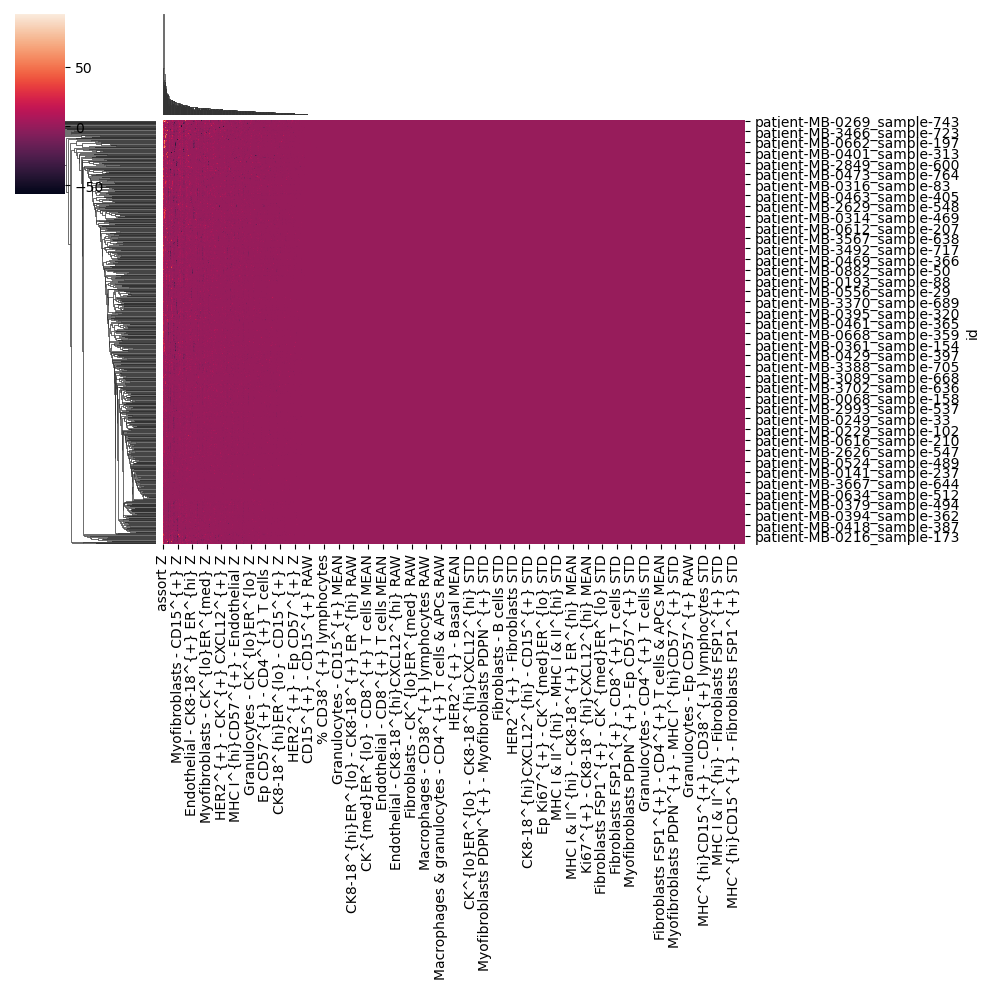

In [261]:
net_stats_ = net_stats.iloc[:,1:].replace([np.inf, -np.inf], 0).fillna(0)

sns.clustermap(net_stats_)


<Axes: ylabel='id'>

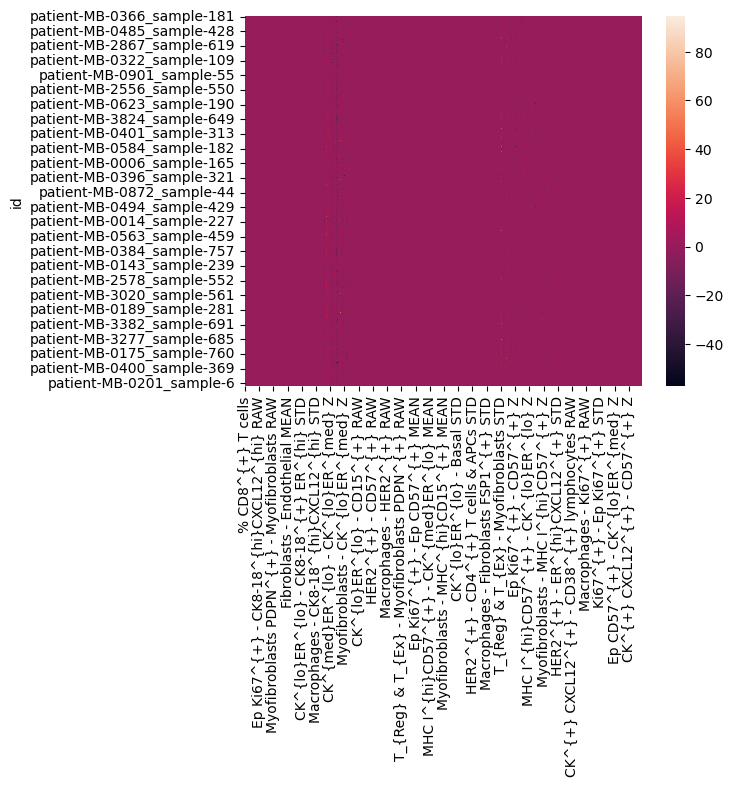

In [263]:
sns.heatmap(net_stats_.fillna(0))

#### Example of Mixing Matrix

In [264]:
sample_id = 'patient-MB-0901_sample-55'
# raw_cols = [x for x in net_stats.columns if x.endswith('RAW') and not x.startswith('assort')]
# raw_cols = net_stats.iloc[:, 26:257].columns
z_cols = [x for x in net_stats.columns if x.endswith('Z') and not x.startswith('assort')]

# mixmat_raw = mosna.series_to_mixmat(net_stats.loc[sample_id, raw_cols], discard=' RAW').astype(float)
mixmat_z = mosna.series_to_mixmat(net_stats.loc[sample_id, z_cols], discard=' Z').astype(float)
# assort_raw = net_stats.loc[sample_id, "assort"]
assort_z = net_stats.loc[sample_id, "assort Z"]

# select_cols = np.logical_and(mixmat_raw.isna(axis=0) == 0, mixmat_z.isna(axis=0) == 0)

Z-scored assortativity by cell types: 19.26


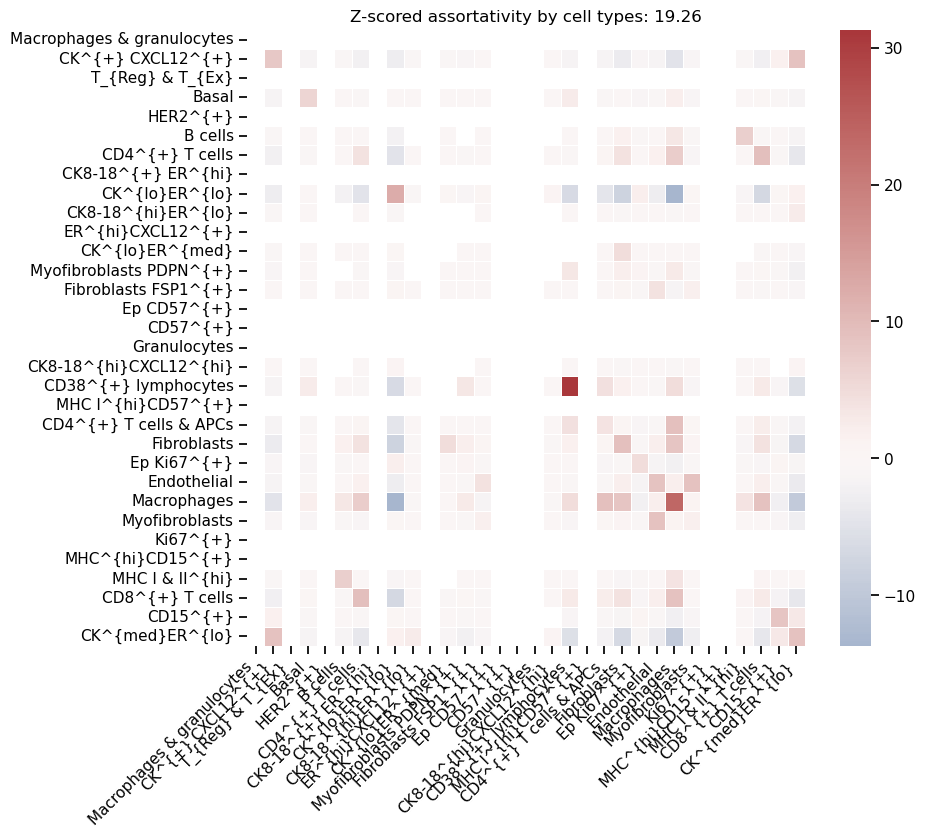

In [265]:
# sns.set_context('talk')
sns.set_context("notebook")
figsize = (9, 8)

# title = "Raw assortativity by cell types: {:.2f}".format(assort_raw)
# print(title)
# f, ax = plt.subplots(figsize=figsize)
# sns.heatmap(mixmat_raw, center=0, cmap="vlag", annot=False, linewidths=.5, ax=ax)
# ax.set_title(title)
# plt.xticks(rotation=30, ha='right');
# plt.xticks(rotation=30, ha='right');
# # plt.xticks(rotation=30, ha='right', fontsize=20);
# # plt.yticks(fontsize=20);
# plt.savefig(save_dir / f"assortativity_raw_sample-{sample_id}", bbox_inches='tight', facecolor='white')

title = "Z-scored assortativity by cell types: {:.2f}".format(assort_z)
print(title)
f, ax = plt.subplots(figsize=figsize)
sns.heatmap(mixmat_z, center=0, cmap="vlag", annot=False, linewidths=.5, ax=ax)
ax.set_title(title)
plt.xticks(rotation=45, ha='right');
plt.savefig(save_dir / "assortativity_z-scored_sample-{sample_id}", bbox_inches='tight', facecolor='white')

Z-scored assortativity by cell types: 19.26


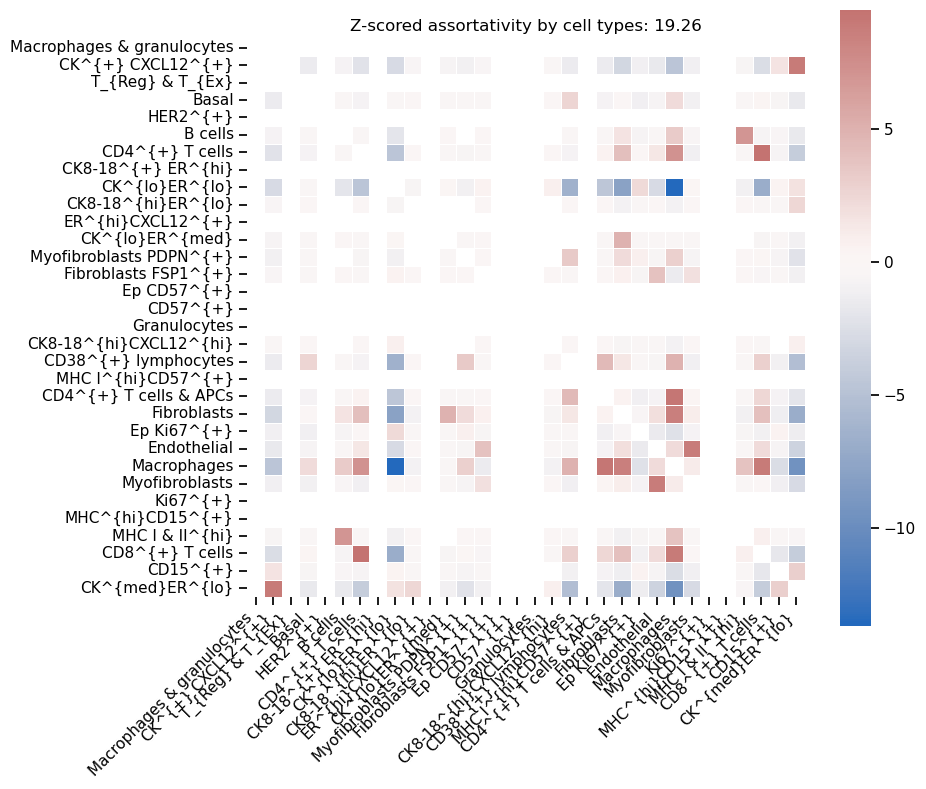

In [266]:
# Hide diagonal

# # Generate a mask for the upper triangle
# mask = np.triu(np.ones_like(mixmat_raw, dtype=bool))

# Generate a mask for the diagonal
mask = np.eye(mixmat_z.shape[0], dtype=bool)

# sns.set_context('talk')
sns.set_context("notebook")
figsize = (9, 8)

# title = "Raw assortativity by cell types: {:.2f}".format(assort_raw)
# print(title)
# f, ax = plt.subplots(figsize=figsize)
# sns.heatmap(mixmat_raw, mask=mask, center=0, cmap="vlag", annot=False, square=True, linewidths=.5, ax=ax)
# ax.set_title(title)
# plt.xticks(rotation=30, ha='right');
# plt.xticks(rotation=30, ha='right');#, fontsize=20);
# # plt.yticks(fontsize=20);
# plt.savefig(save_dir / f"assortativity_raw_sample-{sample_id}_diagonal", bbox_inches='tight', facecolor='white')

title = "Z-scored assortativity by cell types: {:.2f}".format(assort_z)
print(title)
f, ax = plt.subplots(figsize=figsize)
sns.heatmap(mixmat_z, mask=mask, center=0, cmap="vlag", annot=False, square=True, linewidths=.5, ax=ax)
ax.set_title(title)
plt.xticks(rotation=45, ha='right');
plt.savefig(save_dir / "assortativity_z-scored_sample-{sample_id}_diagonal", bbox_inches='tight', facecolor='white')

#### Assortativity and patients survival

In [267]:
z_cols = [x for x in net_stats.columns if x.endswith('Z')]
z_net_stats = net_stats[z_cols].astype(float)

##### Per sample

In [268]:
z_net_stats

,assort Z,CD8^{+} T cells - CD8^{+} T cells Z,CK8-18^{+} ER^{hi} - CD8^{+} T cells Z,CK8-18^{+} ER^{hi} - CK8-18^{+} ER^{hi} Z,CK8-18^{hi}CXCL12^{hi} - CD8^{+} T cells Z,CK8-18^{hi}CXCL12^{hi} - CK8-18^{+} ER^{hi} Z,CK8-18^{hi}CXCL12^{hi} - CK8-18^{hi}CXCL12^{hi} Z,CK8-18^{hi}ER^{lo} - CD8^{+} T cells Z,CK8-18^{hi}ER^{lo} - CK8-18^{+} ER^{hi} Z,CK8-18^{hi}ER^{lo} - CK8-18^{hi}CXCL12^{hi} Z,...,MHC I^{hi}CD57^{+} - CK^{lo}ER^{med} Z,MHC I^{hi}CD57^{+} - ER^{hi}CXCL12^{+} Z,MHC^{hi}CD15^{+} - CK8-18^{+} ER^{hi} Z,MHC I^{hi}CD57^{+} - CK8-18^{hi}CXCL12^{hi} Z,MHC I^{hi}CD57^{+} - CK8-18^{hi}ER^{lo} Z,MHC I^{hi}CD57^{+} - Ki67^{+} Z,Macrophages & granulocytes - CK8-18^{+} ER^{hi} Z,CK8-18^{hi}CXCL12^{hi} - CD57^{+} Z,MHC^{hi}CD15^{+} - CK8-18^{hi}CXCL12^{hi} Z,CK8-18^{+} ER^{hi} - CD57^{+} Z
id,,,,,,,,,,,,,,,,,,,,,
patient-MB-0366_sample-181,25.166146,4.898979,-0.616250,2.620265,-5.903139,-3.714024,20.304511,-0.277350,-0.500000,0.311947,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-MB-3355_sample-692,28.344543,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-MB-0141_sample-237,8.617140,NaN,NaN,NaN,NaN,NaN,4.658904,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-MB-0119_sample-492,15.260308,0.202824,NaN,NaN,-1.011300,NaN,3.128248,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
patient-MB-2632_sample-562,76.622919,19.855537,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
patient-MB-0340_sample-462,33.929755,2.291288,NaN,NaN,-0.204124,NaN,NaN,-0.870388,NaN,-0.252646,...,NaN,NaN,NaN,NaN,-0.294884,NaN,NaN,NaN,2.456095,NaN
patient-MB-0433_sample-400,25.106788,6.300273,-0.852856,1.129915,-2.723696,0.737865,4.261332,0.716253,-0.531085,-0.717741,...,NaN,NaN,NaN,NaN,NaN,NaN,2.306227,NaN,NaN,NaN
patient-MB-0345_sample-35,24.047012,3.188007,NaN,NaN,-3.408178,NaN,14.333326,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [269]:
# Have a look at nan values
for name, value in z_net_stats.isna().sum(axis=0).items():
    print(name, ' ' * (52- len(name)), value)

assort Z                                              0
CD8^{+} T cells - CD8^{+} T cells Z                   134
CK8-18^{+} ER^{hi} - CD8^{+} T cells Z                476
CK8-18^{+} ER^{hi} - CK8-18^{+} ER^{hi} Z             553
CK8-18^{hi}CXCL12^{hi} - CD8^{+} T cells Z            250
CK8-18^{hi}CXCL12^{hi} - CK8-18^{+} ER^{hi} Z         490
CK8-18^{hi}CXCL12^{hi} - CK8-18^{hi}CXCL12^{hi} Z     293
CK8-18^{hi}ER^{lo} - CD8^{+} T cells Z                514
CK8-18^{hi}ER^{lo} - CK8-18^{+} ER^{hi} Z             576
CK8-18^{hi}ER^{lo} - CK8-18^{hi}CXCL12^{hi} Z         521
CK8-18^{hi}ER^{lo} - CK8-18^{hi}ER^{lo} Z             598
CK^{+} CXCL12^{+} - CD8^{+} T cells Z                 188
CK^{+} CXCL12^{+} - CK8-18^{+} ER^{hi} Z              477
CK^{+} CXCL12^{+} - CK8-18^{hi}CXCL12^{hi} Z          242
CK^{+} CXCL12^{+} - CK8-18^{hi}ER^{lo} Z              504
CK^{+} CXCL12^{+} - CK^{+} CXCL12^{+} Z               191
CK^{lo}ER^{lo} - CD8^{+} T cells Z                    87
CK^{lo}ER^{lo} - 

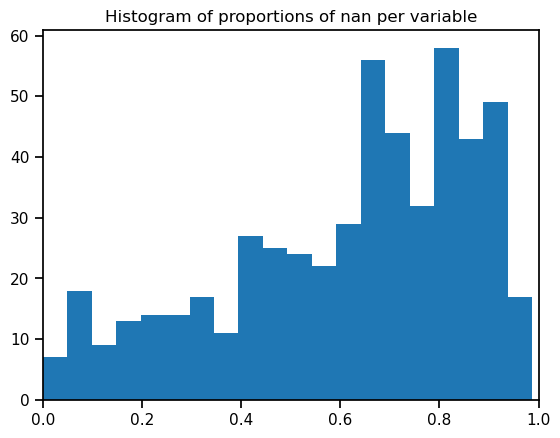

In [270]:
plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0], bins=20);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');

Many levels of interaction between cell types have non finite values.

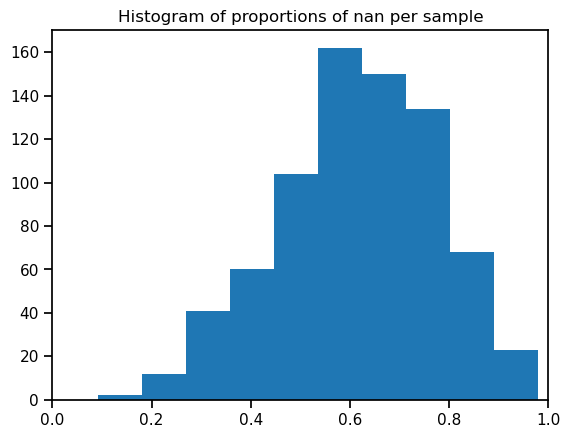

In [271]:
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

Many generated columns have a high proportion of nan.  
mosna can clean data by discarding variables with the highest proportion of nan, and then impute (guess) missing data with a KNNImputer. However for best accuracy, we prefer to first *drop* columns with too many nan, relatively aggressively, then drop observations (samples) much less aggressively (clinical data is precious!), then impute data. 

Before dropping variables z_net_stats shape: (756, 529)
There are 246979 non finite values (61.8%)
Final z_net_stats shape: (756, 103)
There are 426 variables discarded


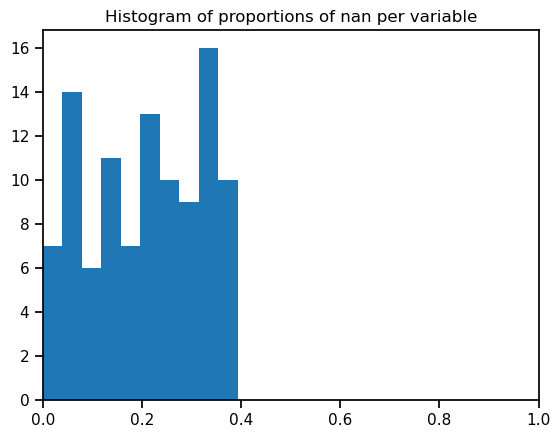

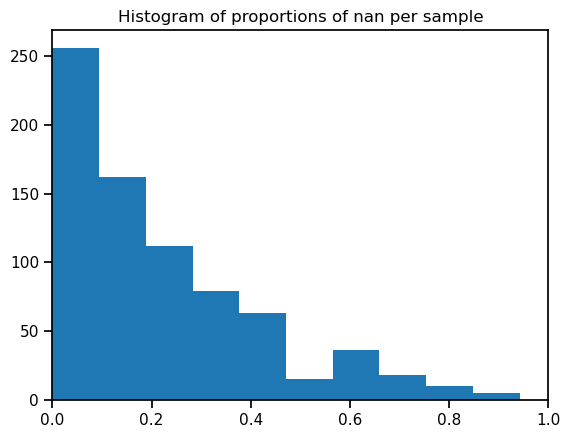

In [272]:
print("Before dropping variables z_net_stats shape:", z_net_stats.shape)

# drop columns
z_net_stats, select_finite = mosna.clean_data(
    z_net_stats, 
    method='drop',
    thresh=0.4,
    axis=0,
    )
print("Final z_net_stats shape:", z_net_stats.shape)
unselected = ~select_finite
print(f"There are {unselected.sum()} variables discarded")

plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');
plt.figure()
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

Before dropping samples z_net_stats shape: (756, 103)
There are 16086 non finite values (20.7%)
Final z_net_stats shape: (745, 103)
There are 11 observations discarded


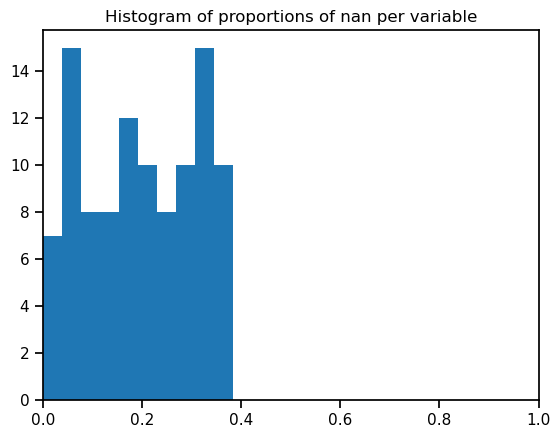

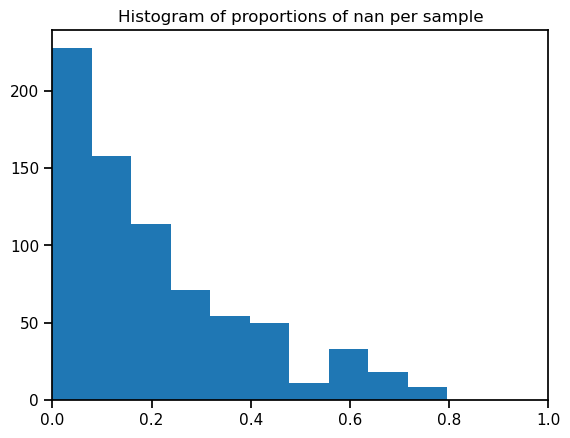

In [273]:
print("Before dropping samples z_net_stats shape:", z_net_stats.shape)

# drop samples
z_net_stats, select_finite = mosna.clean_data(
    z_net_stats, 
    method='drop',
    thresh=0.8,
    axis=1,
    )
print("Final z_net_stats shape:", z_net_stats.shape)
unselected = ~select_finite
print(f"There are {unselected.sum()} observations discarded")

plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');
plt.figure()
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

In [274]:
# impute non finite values in data for further analyses and visualizations
z_net_stats_cleaned, select_finite = mosna.clean_data(
    z_net_stats, 
    method='mixed',
    thresh=0.8,
    )
print("Final z_net_stats shape:", z_net_stats_cleaned.shape)

There are 15116 non finite values (19.7%)
Imputing data
Final z_net_stats shape: (745, 103)


In [275]:
# Add back patient id to the network stats dataframe
def parse_patient(s):
    return s.split('_')[0][8:]

if patient_col not in z_net_stats_cleaned.columns:
    z_net_stats_cleaned[patient_col] = [parse_patient(s) for s in z_net_stats_cleaned.index]

# Add back sample id to the network stats dataframe
def parse_sample(s):
    return s.split('_')[1][7:]

if sample_col not in z_net_stats_cleaned.columns:
    z_net_stats_cleaned[sample_col] = [parse_sample(s) for s in z_net_stats_cleaned.index]

In [276]:
duration_col = 'yearsToStatus'
event_col = 'DeathBreast'
covariates = ['ERStatus'] #, 'ERBB2_pos'] # else []
strata = 'ERStatus'

status = surv[[duration_col, event_col] + covariates]
status

,yearsToStatus,DeathBreast,ERStatus
metabric_id,,,
MB-0000,11.540041,0,1.0
MB-0002,6.951403,0,1.0
MB-0005,13.445585,1,1.0
MB-0006,13.546886,0,1.0
MB-0008,3.397673,1,1.0
...,...,...,...
MB-3688,2.179329,1,1.0
MB-3692,5.089665,1,1.0
MB-3747,18.877481,0,1.0


In [277]:
drop_nan = True

df_surv = z_net_stats_cleaned.merge(status, how='inner', on=patient_col)

if drop_nan:
    n_obs_orig = len(df_surv)
    df_surv.dropna(axis=0, inplace=True)
    n_obs = len(df_surv)
    if n_obs != n_obs_orig:
        print(f'discarded {n_obs_orig - n_obs} / {n_obs_orig} observations with NaN')

discarded 15 / 570 observations with NaN


In [278]:
non_pred_cols = [patient_col, sample_col]
pred_cols = [x for x in df_surv if x not in non_pred_cols]

In [383]:
df_surv.to_csv('~/Desktop/IMC_BC.csv')

In [384]:
df_surv.sample(4)

,B cells,Basal,CD15^{+},CD38^{+} lymphocytes,CD4^{+} T cells,CD4^{+} T cells & APCs,CD57^{+},CD8^{+} T cells,CK8-18^{+} ER^{hi},CK8-18^{hi}CXCL12^{hi},...,MHC I & II^{hi},MHC I^{hi}CD57^{+},MHC^{hi}CD15^{+},Macrophages,Macrophages & granulocytes,Myofibroblasts,Myofibroblasts PDPN^{+},yearsToStatus,DeathBreast,ERStatus
metabric_id,,,,,,,,,,,,,,,,,,,,,
MB-0384,0.000151,0.001057,0.010725,0.000000,0.003625,0.005136,0.000151,0.009517,0.008157,0.230514,...,0.00000,0.000000,0.000000,0.034592,0.000151,0.071148,0.020091,5.018480,1,1.0
MB-3089,0.067725,0.000000,0.000000,0.010582,0.015873,0.248677,0.000000,0.201058,0.000000,0.000000,...,0.01164,0.001058,0.002116,0.125926,0.025397,0.068783,0.029630,20.687201,0,0.0
MB-0537,0.000791,0.000000,0.000000,0.000791,0.000791,0.000000,0.000000,0.004743,0.000000,0.260870,...,0.00000,0.000000,0.000000,0.003162,0.000000,0.026877,0.004743,9.327858,0,1.0
MB-0890,0.000000,0.159664,0.012605,0.002101,0.006303,0.000000,0.000000,0.029412,0.000000,0.000000,...,0.00000,0.000000,0.000000,0.002101,0.000000,0.107143,0.004202,13.566051,0,1.0


In [279]:
cph = CoxPHFitter(penalizer=0.0001)
if strata is None:
    cph.fit(df_surv[pred_cols], duration_col=duration_col, event_col=event_col)
else:
    cph.fit(df_surv[pred_cols], duration_col=duration_col, event_col=event_col, strata=strata)

# if convergence fails, use CoxPHFitter(penalizer=0.1).fit(…)
cph.print_summary()

model,lifelines.CoxPHFitter
duration col,'yearsToStatus'
event col,'DeathBreast'
penalizer,0.0001
l1 ratio,0.0
strata,ERStatus
baseline estimation,breslow
number of observations,555
number of events observed,171
partial log-likelihood,-820.91
time fit was run,2024-05-30 12:03:48 UTC


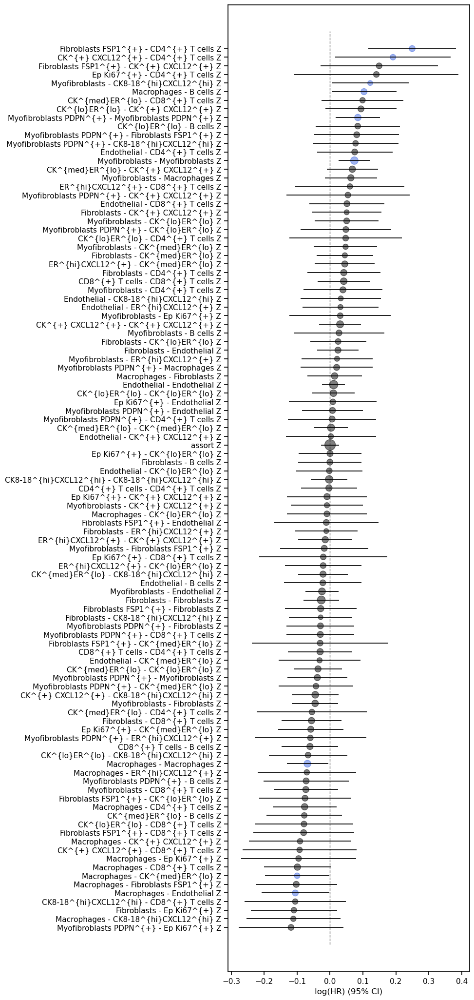

In [280]:
# Plot coefficients
ax = mosna.plot_survival_coeffs(
    model=cph, 
    data=df_surv,
    )
figname = f"assortativity_per_sample_CoxPH_coefficients.jpg"
plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

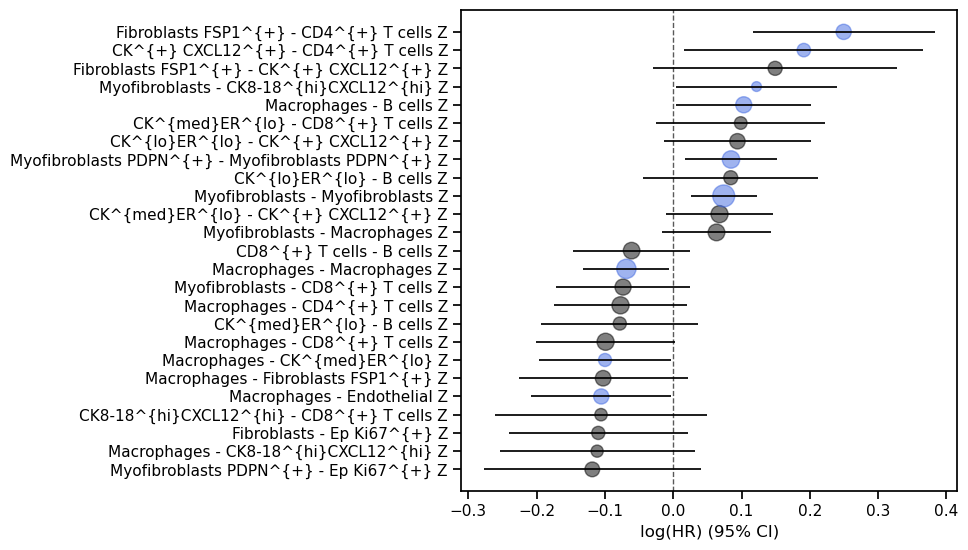

In [283]:
ax = mosna.plot_survival_coeffs(
    model=cph, 
    data=df_surv,
    p_thresh=0.2,
    )
p_thresh = 0.2
figname = f"assortativity_per_sample_CoxPH_coefficients_p_thresh-{p_thresh}.jpg"
plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

In [284]:
# Get significant coefficients only
coefs_sig = mosna.get_significant_coefficients(cph.confidence_intervals_)
print(coefs_sig)

['Macrophages - CK^{med}ER^{lo} Z' 'Macrophages - Endothelial Z'
 'Macrophages - Macrophages Z' 'Myofibroblasts - CK8-18^{hi}CXCL12^{hi} Z'
 'Myofibroblasts - Myofibroblasts Z'
 'Myofibroblasts PDPN^{+} - Myofibroblasts PDPN^{+} Z'
 'Fibroblasts FSP1^{+} - CD4^{+} T cells Z' 'Macrophages - B cells Z'
 'CK^{+} CXCL12^{+} - CD4^{+} T cells Z']


#### Plot survival curves with best threshold

Macrophages - CK^{med}ER^{lo} Z
best_thresh: -4.07
best_perc: 10
best_p_val: 0.101
Macrophages - Endothelial Z
best_thresh: 0.556
best_perc: 60
best_p_val: 0.36
Macrophages - Macrophages Z
best_thresh: 6.98
best_perc: 80
best_p_val: 0.15
Myofibroblasts - CK8-18^{hi}CXCL12^{hi} Z
best_thresh: -2.29
best_perc: 50
best_p_val: 0.0212
Myofibroblasts - Myofibroblasts Z
best_thresh: 15.5
best_perc: 90
best_p_val: 0.0736
Myofibroblasts PDPN^{+} - Myofibroblasts PDPN^{+} Z
best_thresh: 2.99
best_perc: 70
best_p_val: 0.00203
Fibroblasts FSP1^{+} - CD4^{+} T cells Z
best_thresh: 0.281
best_perc: 60
best_p_val: 0.00223
Macrophages - B cells Z
best_thresh: 1.97
best_perc: 70
best_p_val: 0.278
CK^{+} CXCL12^{+} - CD4^{+} T cells Z
best_thresh: -1.75
best_perc: 20
best_p_val: 0.0984


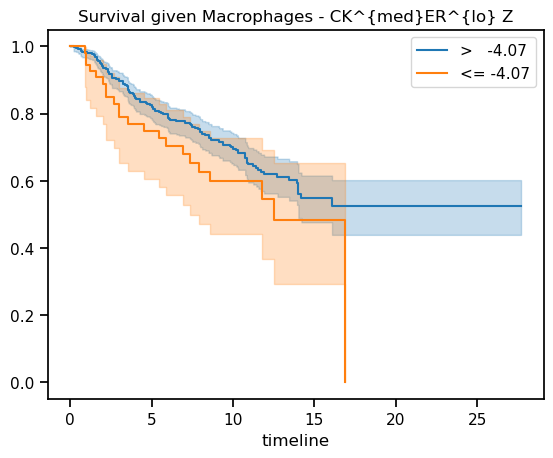

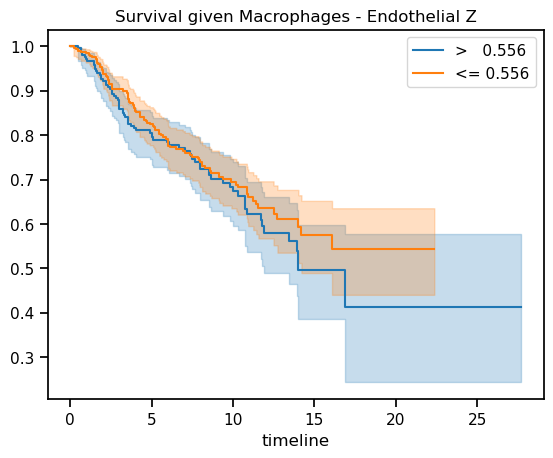

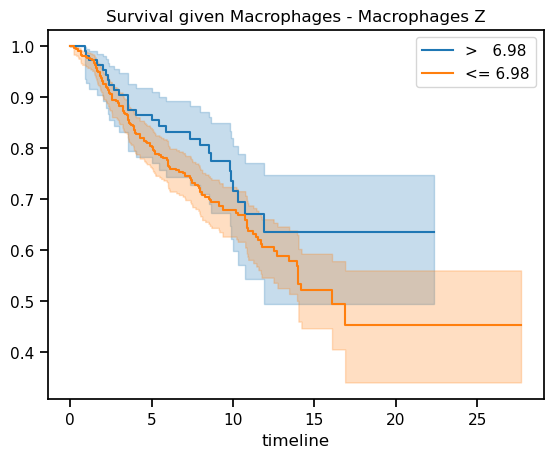

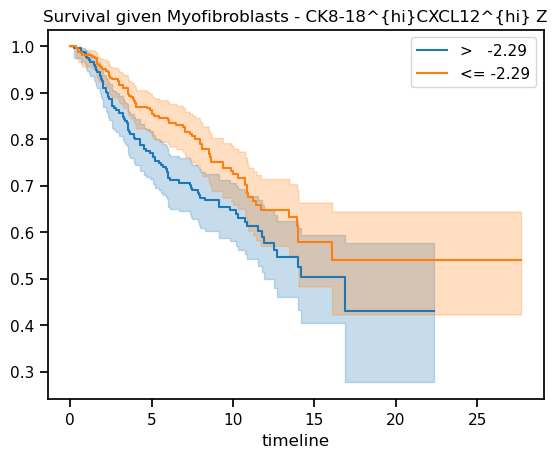

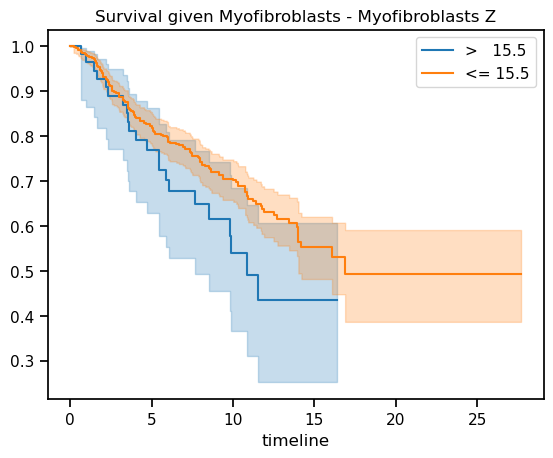

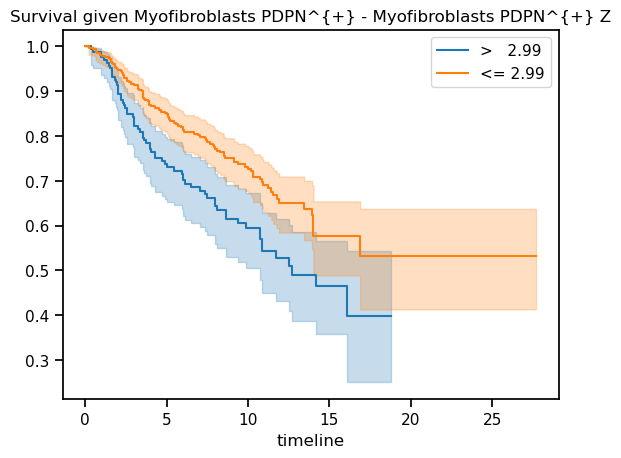

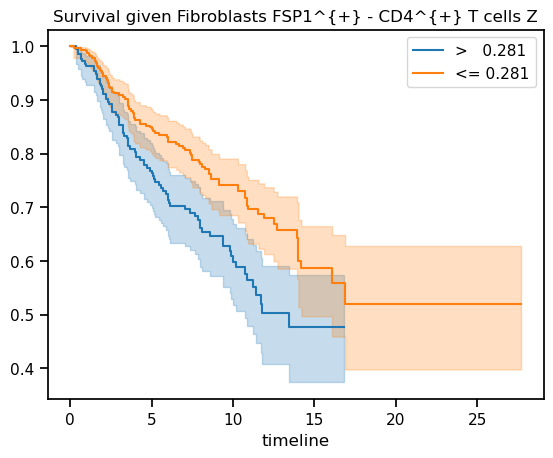

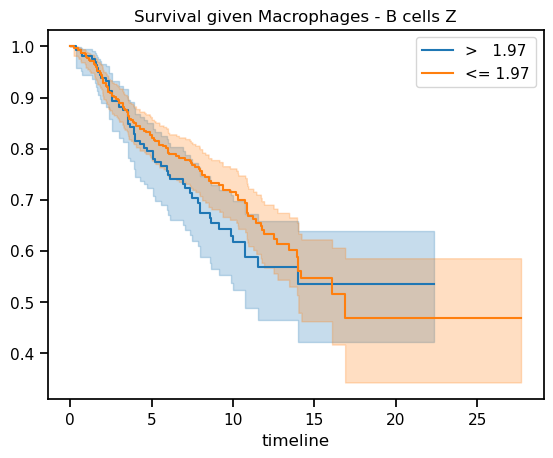

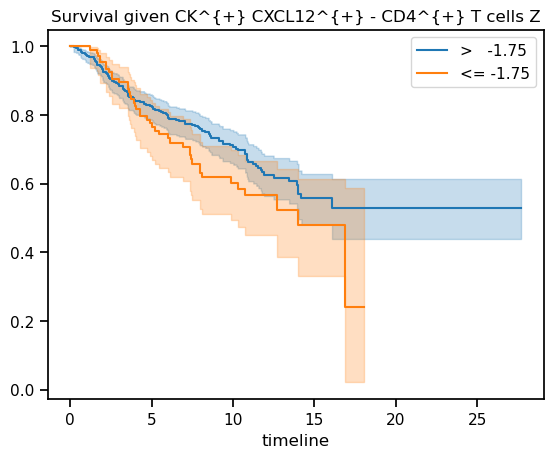

In [285]:
for variable_name in coefs_sig:

    best_thresh, best_perc, best_p_val = mosna.find_best_survival_threshold(df_surv, variable_name, duration_col, event_col)
    print(variable_name)
    print(f'best_thresh: {best_thresh:.3g}')
    print(f'best_perc: {best_perc:.3g}')
    print(f'best_p_val: {best_p_val:.3g}')

    mosna.plot_survival_threshold(df_surv, variable_name, duration_col, event_col, best_thresh)

Macrophages - CK^{med}ER^{lo} Z
best_thresh: -4.07
best_perc: 10
best_p_val: 0.101
Macrophages - Endothelial Z
best_thresh: 0.556
best_perc: 60
best_p_val: 0.36
Macrophages - Macrophages Z
best_thresh: 6.98
best_perc: 80
best_p_val: 0.15
Myofibroblasts - CK8-18^{hi}CXCL12^{hi} Z
best_thresh: -2.29
best_perc: 50
best_p_val: 0.0212
Myofibroblasts - Myofibroblasts Z
best_thresh: 15.5
best_perc: 90
best_p_val: 0.0736
Myofibroblasts PDPN^{+} - Myofibroblasts PDPN^{+} Z
best_thresh: 2.99
best_perc: 70
best_p_val: 0.00203
Fibroblasts FSP1^{+} - CD4^{+} T cells Z
best_thresh: 0.281
best_perc: 60
best_p_val: 0.00223
Macrophages - B cells Z
best_thresh: 1.97
best_perc: 70
best_p_val: 0.278
CK^{+} CXCL12^{+} - CD4^{+} T cells Z
best_thresh: -1.75
best_perc: 20
best_p_val: 0.0984


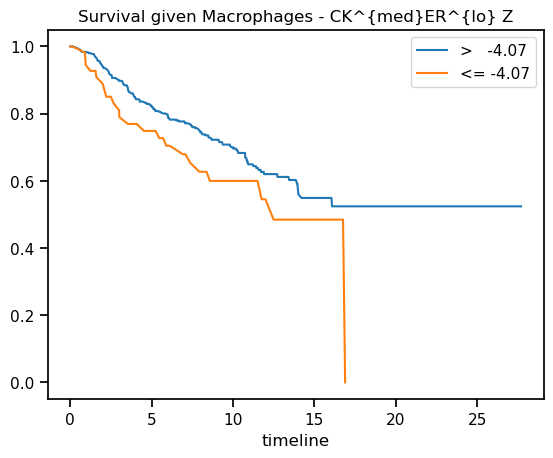

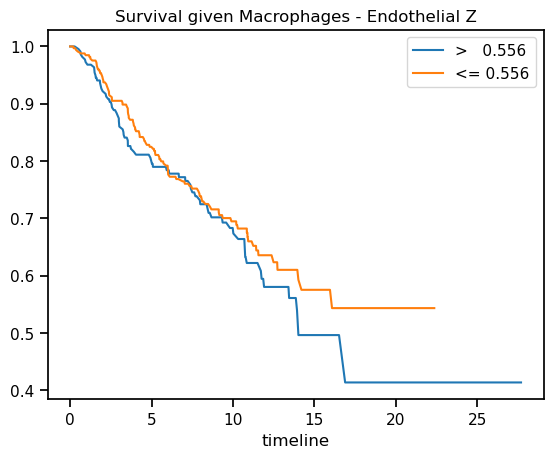

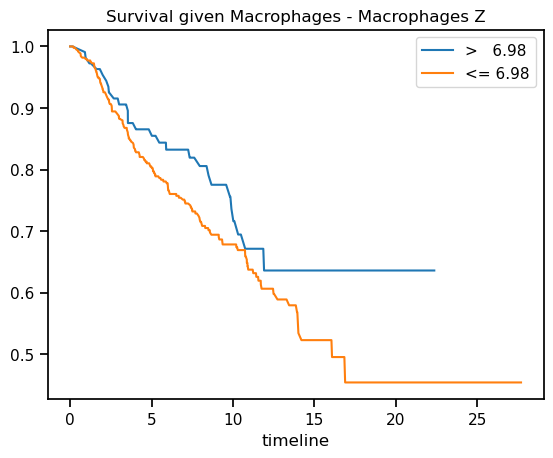

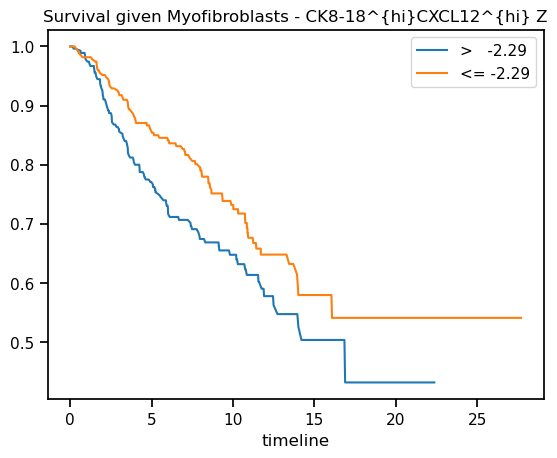

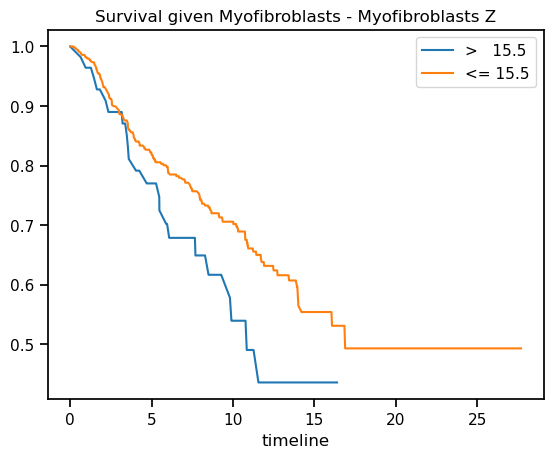

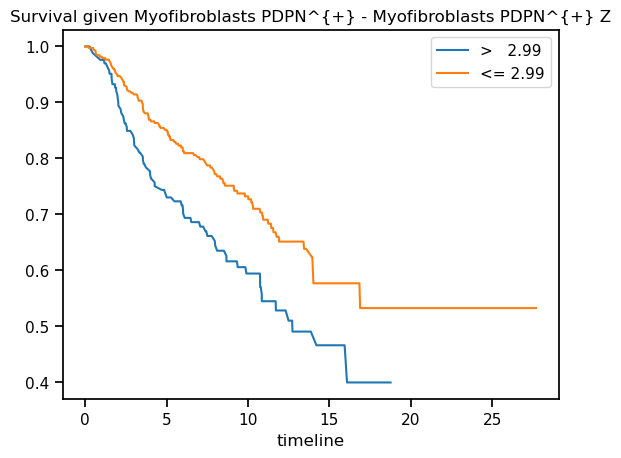

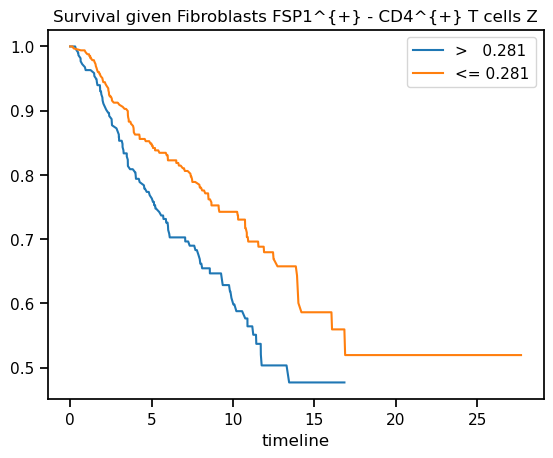

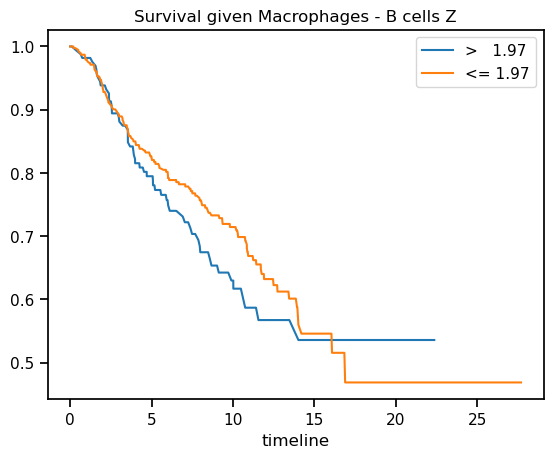

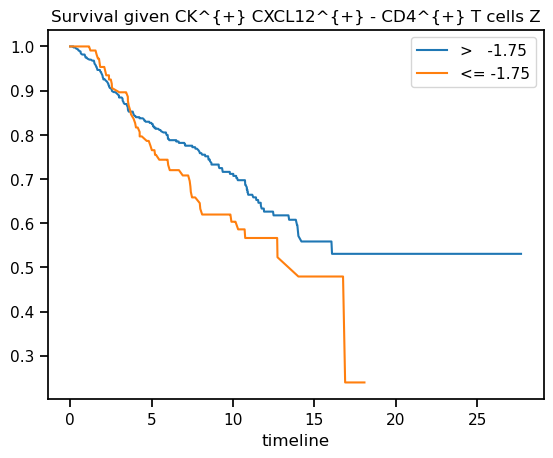

In [286]:
for variable_name in coefs_sig:

    best_thresh, best_perc, best_p_val = mosna.find_best_survival_threshold(df_surv, variable_name, duration_col, event_col)
    print(variable_name)
    print(f'best_thresh: {best_thresh:.3g}')
    print(f'best_perc: {best_perc:.3g}')
    print(f'best_p_val: {best_p_val:.3g}')

    mosna.plot_survival_threshold(df_surv, variable_name, duration_col, event_col, best_thresh, with_confidence=False)

##### Per patient

In [287]:
z_net_stats = net_stats[z_cols].copy().astype(float)

# Add back patient id to the network stats dataframe
def parse_patient(s):
    return s.split('_')[0][8:]

if patient_col not in z_net_stats.columns:
    z_net_stats[patient_col] = [parse_patient(s) for s in z_net_stats.index]

# # Add back sample id to the network stats dataframe
# def parse_sample(s):
#     return s.split('_')[1][7:]

# if sample_col not in z_net_stats.columns:
#     z_net_stats[sample_col] = [parse_sample(s) for s in z_net_stats.index]

In [288]:
z_net_stats = z_net_stats.groupby([patient_col]).mean()
z_net_stats

,assort Z,CD8^{+} T cells - CD8^{+} T cells Z,CK8-18^{+} ER^{hi} - CD8^{+} T cells Z,CK8-18^{+} ER^{hi} - CK8-18^{+} ER^{hi} Z,CK8-18^{hi}CXCL12^{hi} - CD8^{+} T cells Z,CK8-18^{hi}CXCL12^{hi} - CK8-18^{+} ER^{hi} Z,CK8-18^{hi}CXCL12^{hi} - CK8-18^{hi}CXCL12^{hi} Z,CK8-18^{hi}ER^{lo} - CD8^{+} T cells Z,CK8-18^{hi}ER^{lo} - CK8-18^{+} ER^{hi} Z,CK8-18^{hi}ER^{lo} - CK8-18^{hi}CXCL12^{hi} Z,...,MHC I^{hi}CD57^{+} - CK^{lo}ER^{med} Z,MHC I^{hi}CD57^{+} - ER^{hi}CXCL12^{+} Z,MHC^{hi}CD15^{+} - CK8-18^{+} ER^{hi} Z,MHC I^{hi}CD57^{+} - CK8-18^{hi}CXCL12^{hi} Z,MHC I^{hi}CD57^{+} - CK8-18^{hi}ER^{lo} Z,MHC I^{hi}CD57^{+} - Ki67^{+} Z,Macrophages & granulocytes - CK8-18^{+} ER^{hi} Z,CK8-18^{hi}CXCL12^{hi} - CD57^{+} Z,MHC^{hi}CD15^{+} - CK8-18^{hi}CXCL12^{hi} Z,CK8-18^{+} ER^{hi} - CD57^{+} Z
metabric_id,,,,,,,,,,,,,,,,,,,,,
MB-0000,11.546560,2.478479,-0.403473,NaN,-0.916555,2.134375,1.444188,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
MB-0002,32.501551,3.391165,NaN,NaN,-4.863976,NaN,22.144739,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
MB-0005,32.037666,2.306227,4.898979,NaN,-1.032796,-0.294884,5.209488,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
MB-0006,26.013329,-0.294884,NaN,NaN,-1.715616,NaN,12.359441,-0.142857,NaN,0.789542,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
MB-0010,9.859295,-0.333333,-2.646326,8.01402,NaN,NaN,NaN,NaN,NaN,NaN,...,-0.142857,NaN,NaN,NaN,NaN,-0.142857,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MB-3824,14.241358,NaN,NaN,NaN,-0.204124,NaN,-0.294884,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
MB-3838,13.946699,0.789542,NaN,NaN,-1.368494,NaN,-0.039253,-0.333333,NaN,-0.277350,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-0.696526,NaN,NaN
MB-3854,12.830867,0.462250,-0.333333,NaN,-1.160229,-0.369274,-0.623610,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [289]:
# Have a look at nan values
for name, value in z_net_stats.isna().sum(axis=0).items():
    print(name, ' ' * (52- len(name)), value)

assort Z                                              0
CD8^{+} T cells - CD8^{+} T cells Z                   113
CK8-18^{+} ER^{hi} - CD8^{+} T cells Z                426
CK8-18^{+} ER^{hi} - CK8-18^{+} ER^{hi} Z             493
CK8-18^{hi}CXCL12^{hi} - CD8^{+} T cells Z            223
CK8-18^{hi}CXCL12^{hi} - CK8-18^{+} ER^{hi} Z         436
CK8-18^{hi}CXCL12^{hi} - CK8-18^{hi}CXCL12^{hi} Z     264
CK8-18^{hi}ER^{lo} - CD8^{+} T cells Z                453
CK8-18^{hi}ER^{lo} - CK8-18^{+} ER^{hi} Z             513
CK8-18^{hi}ER^{lo} - CK8-18^{hi}CXCL12^{hi} Z         462
CK8-18^{hi}ER^{lo} - CK8-18^{hi}ER^{lo} Z             533
CK^{+} CXCL12^{+} - CD8^{+} T cells Z                 163
CK^{+} CXCL12^{+} - CK8-18^{+} ER^{hi} Z              424
CK^{+} CXCL12^{+} - CK8-18^{hi}CXCL12^{hi} Z          216
CK^{+} CXCL12^{+} - CK8-18^{hi}ER^{lo} Z              445
CK^{+} CXCL12^{+} - CK^{+} CXCL12^{+} Z               169
CK^{lo}ER^{lo} - CD8^{+} T cells Z                    75
CK^{lo}ER^{lo} - 

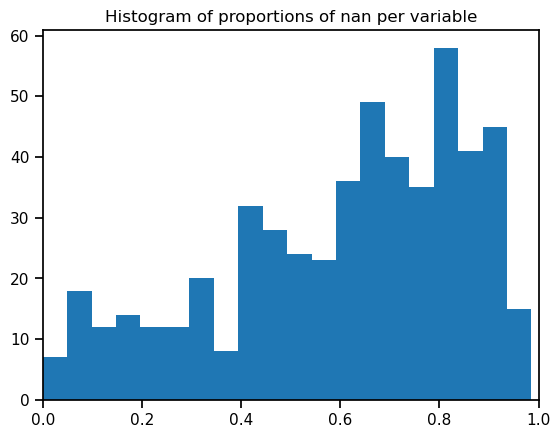

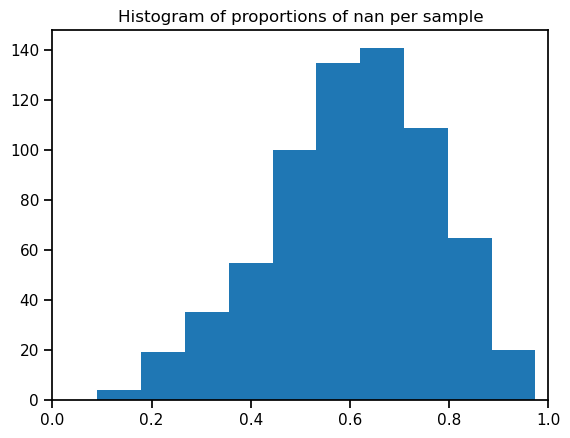

In [290]:
plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0], bins=20);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');
plt.figure()
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

Before dropping variables z_net_stats shape: (683, 529)
There are 219091 non finite values (60.6%)
Final z_net_stats shape: (683, 109)
There are 420 variables discarded


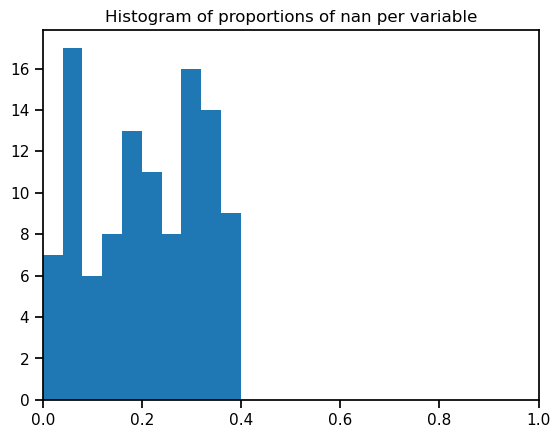

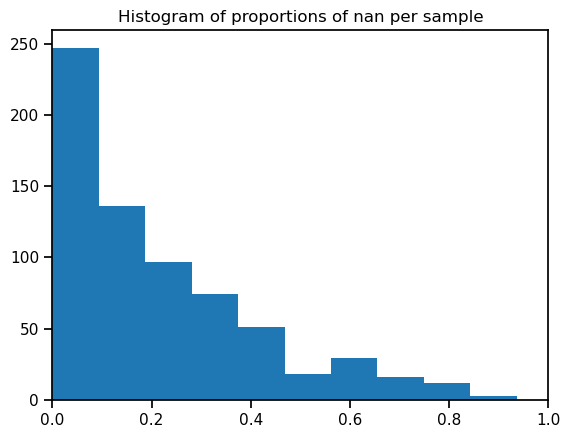

In [291]:
print("Before dropping variables z_net_stats shape:", z_net_stats.shape)

# drop columns
z_net_stats, select_finite = mosna.clean_data(
    z_net_stats, 
    method='drop',
    thresh=0.4,
    axis=0,
    )
print("Final z_net_stats shape:", z_net_stats.shape)
unselected = ~select_finite
print(f"There are {unselected.sum()} variables discarded")

plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');
plt.figure()
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

Before dropping samples z_net_stats shape: (683, 109)
There are 15662 non finite values (21.0%)
Final z_net_stats shape: (675, 109)
There are 8 observations discarded


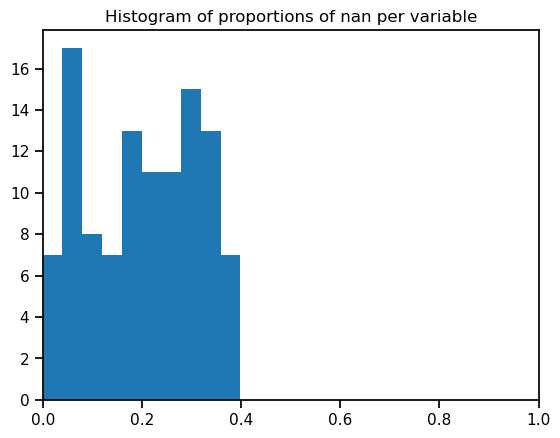

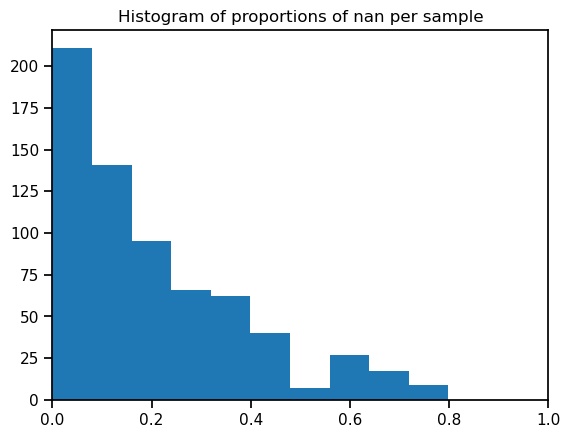

In [292]:
print("Before dropping samples z_net_stats shape:", z_net_stats.shape)

# drop samples
z_net_stats, select_finite = mosna.clean_data(
    z_net_stats, 
    method='drop',
    thresh=0.8,
    axis=1,
    )
print("Final z_net_stats shape:", z_net_stats.shape)
unselected = ~select_finite
print(f"There are {unselected.sum()} observations discarded")

plt.hist(z_net_stats.isna().sum(axis=0) / z_net_stats.shape[0]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per variable');
plt.figure()
plt.hist(z_net_stats.isna().sum(axis=1) / z_net_stats.shape[1]);
plt.xlim([0, 1])
plt.title('Histogram of proportions of nan per sample');

In [293]:
# impute non finite values in data for further analyses and visualizations
z_net_stats_cleaned, select_finite = mosna.clean_data(
    z_net_stats, 
    method='mixed',
    thresh=0.8,
    )
print("Final z_net_stats shape:", z_net_stats_cleaned.shape)

There are 14924 non finite values (20.3%)
Imputing data
Final z_net_stats shape: (675, 109)


In [294]:
duration_col = 'yearsToStatus'
event_col = 'DeathBreast'
covariates = ['ERStatus'] #, 'ERBB2_pos'] # else []
strata = 'ERStatus'

status = surv[[duration_col, event_col] + covariates]
status

,yearsToStatus,DeathBreast,ERStatus
metabric_id,,,
MB-0000,11.540041,0,1.0
MB-0002,6.951403,0,1.0
MB-0005,13.445585,1,1.0
MB-0006,13.546886,0,1.0
MB-0008,3.397673,1,1.0
...,...,...,...
MB-3688,2.179329,1,1.0
MB-3692,5.089665,1,1.0
MB-3747,18.877481,0,1.0


In [295]:
drop_nan = True

df_surv = z_net_stats_cleaned.merge(status, how='inner', on=patient_col)

if drop_nan:
    n_obs_orig = len(df_surv)
    df_surv.dropna(axis=0, inplace=True)
    n_obs = len(df_surv)
    if n_obs != n_obs_orig:
        print(f'discarded {n_obs_orig - n_obs} / {n_obs_orig} observations with NaN')

discarded 15 / 502 observations with NaN


In [296]:
non_pred_cols = [patient_col, sample_col]
pred_cols = [x for x in df_surv if x not in non_pred_cols]

In [297]:
cph = CoxPHFitter(penalizer=0.0001)
if strata is None:
    cph.fit(df_surv[pred_cols], duration_col=duration_col, event_col=event_col)
else:
    cph.fit(df_surv[pred_cols], duration_col=duration_col, event_col=event_col, strata=strata)

# if convergence fails, use CoxPHFitter(penalizer=0.1).fit(…)
cph.print_summary()

model,lifelines.CoxPHFitter
duration col,'yearsToStatus'
event col,'DeathBreast'
penalizer,0.0001
l1 ratio,0.0
strata,ERStatus
baseline estimation,breslow
number of observations,487
number of events observed,153
partial log-likelihood,-699.01
time fit was run,2024-05-30 12:05:11 UTC


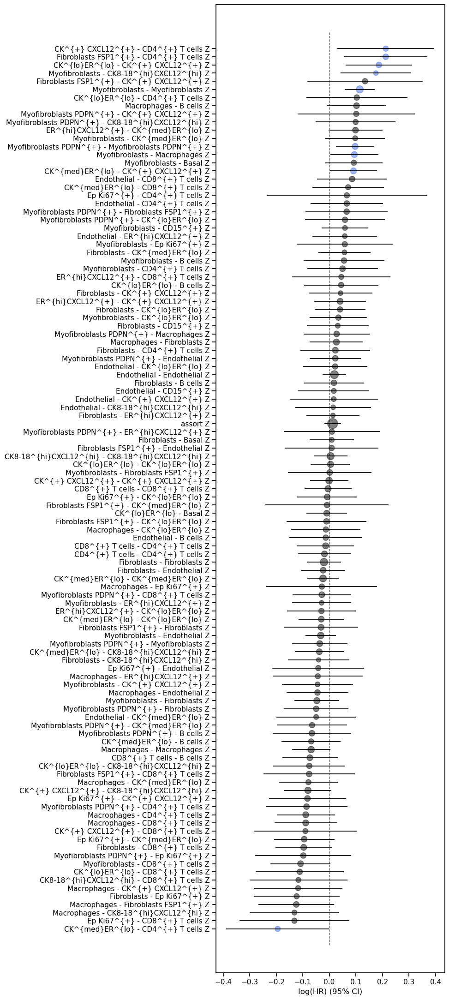

In [298]:
# Plot coefficients
ax = mosna.plot_survival_coeffs(
    model=cph, 
    data=df_surv,
    )
# ax.set_title(f'n sig: {n_sig} {str_params}')
figname = f"assortativity_per_patient_CoxPH_coefficients.jpg"
plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

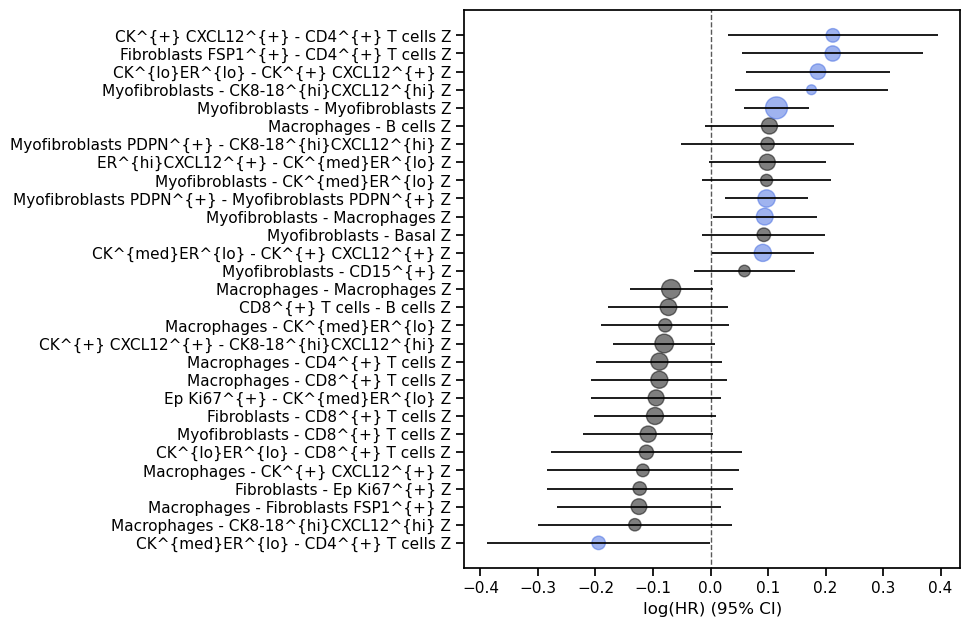

In [299]:
p_thresh = 0.20

ax = mosna.plot_survival_coeffs(
    model=cph, 
    data=df_surv,
    p_thresh=p_thresh,
    )

figname = f"assortativity_per_patient_CoxPH_coefficients_p_thresh-{p_thresh}.jpg"
plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

In [300]:
# Get significant coefficients only
coefs_sig = mosna.get_significant_coefficients(cph.confidence_intervals_)
print(coefs_sig)

['CK^{lo}ER^{lo} - CK^{+} CXCL12^{+} Z'
 'CK^{med}ER^{lo} - CK^{+} CXCL12^{+} Z'
 'Myofibroblasts - CK8-18^{hi}CXCL12^{hi} Z'
 'Myofibroblasts - Macrophages Z' 'Myofibroblasts - Myofibroblasts Z'
 'Myofibroblasts PDPN^{+} - Myofibroblasts PDPN^{+} Z'
 'CK^{med}ER^{lo} - CD4^{+} T cells Z'
 'Fibroblasts FSP1^{+} - CD4^{+} T cells Z'
 'CK^{+} CXCL12^{+} - CD4^{+} T cells Z']


#### Plot survival curves with best threshold

CK^{lo}ER^{lo} - CK^{+} CXCL12^{+} Z
best_thresh: -0.474
best_perc: 30
best_p_val: 0.0171
CK^{med}ER^{lo} - CK^{+} CXCL12^{+} Z
best_thresh: 5.73
best_perc: 90
best_p_val: 0.383
Myofibroblasts - CK8-18^{hi}CXCL12^{hi} Z
best_thresh: -1.9
best_perc: 60
best_p_val: 0.0132
Myofibroblasts - Macrophages Z
best_thresh: 3.72
best_perc: 80
best_p_val: 0.00608
Myofibroblasts - Myofibroblasts Z
best_thresh: 9.28
best_perc: 70
best_p_val: 0.052
Myofibroblasts PDPN^{+} - Myofibroblasts PDPN^{+} Z
best_thresh: 3
best_perc: 70
best_p_val: 0.000828
CK^{med}ER^{lo} - CD4^{+} T cells Z
best_thresh: -3.17
best_perc: 10
best_p_val: 0.00425
Fibroblasts FSP1^{+} - CD4^{+} T cells Z
best_thresh: 1.9
best_perc: 90
best_p_val: 0.011
CK^{+} CXCL12^{+} - CD4^{+} T cells Z
best_thresh: -1.8
best_perc: 20
best_p_val: 0.154


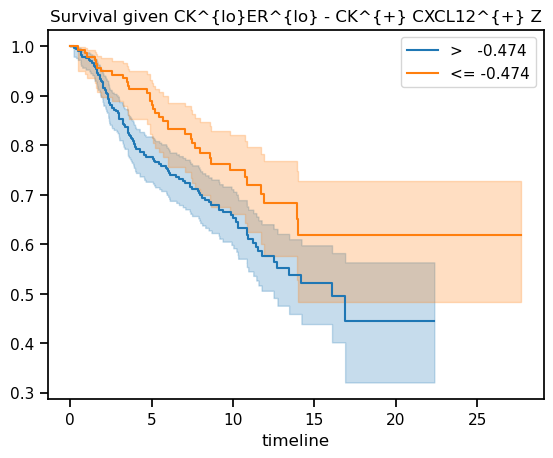

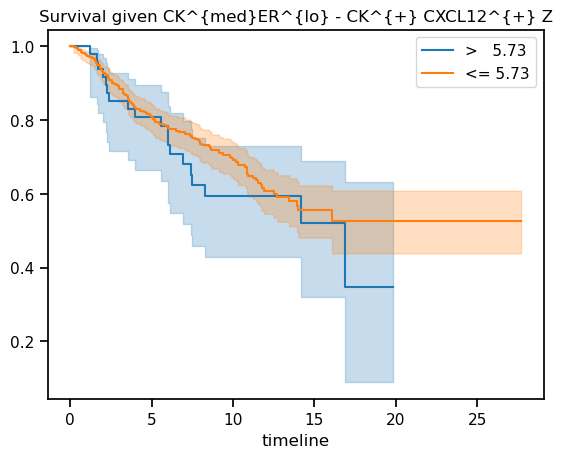

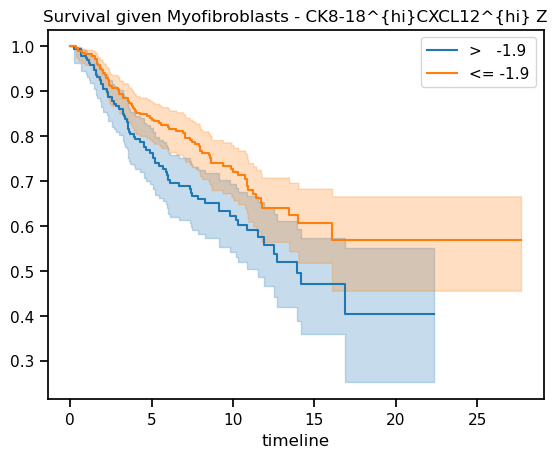

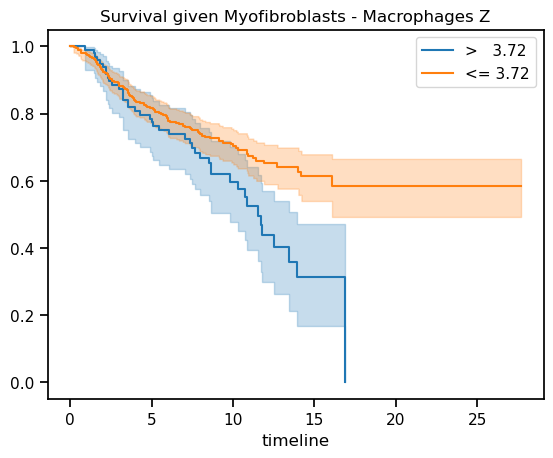

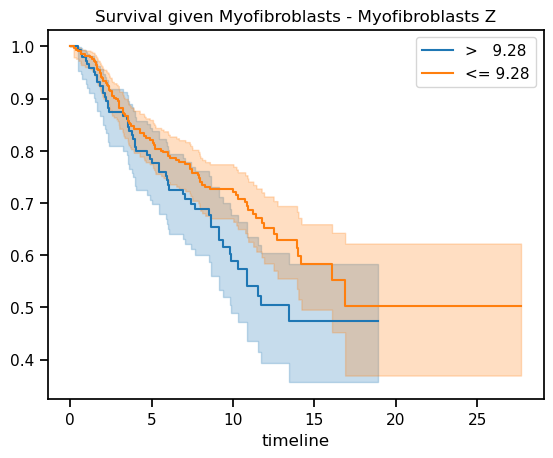

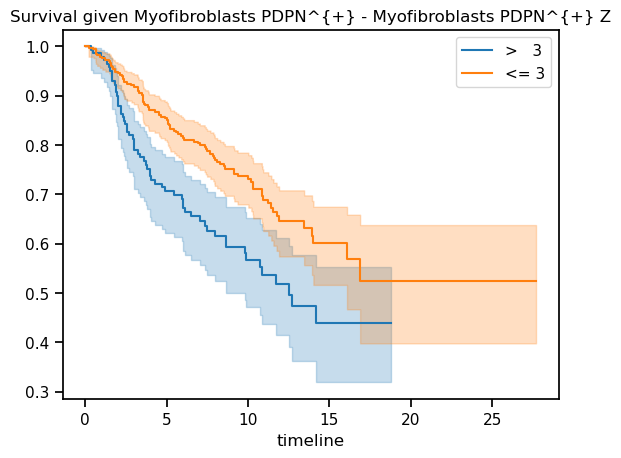

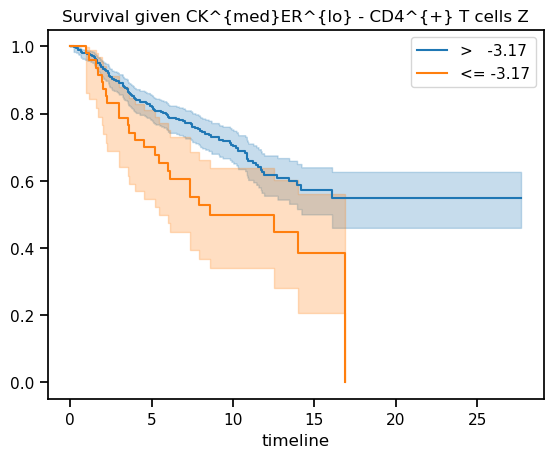

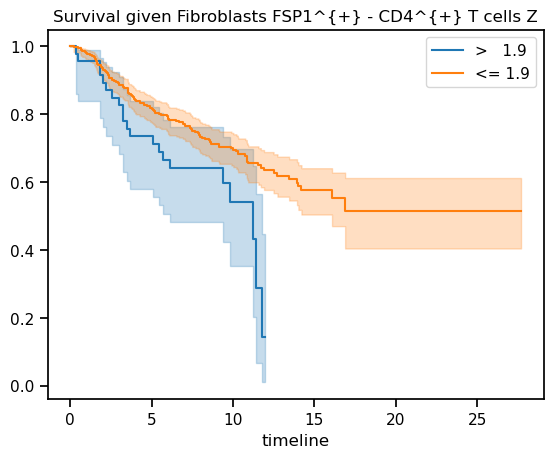

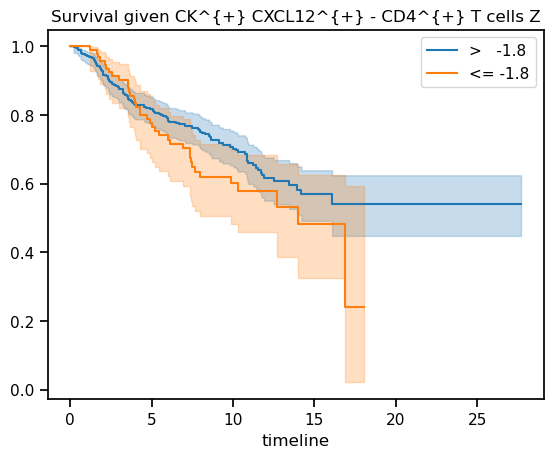

In [301]:
for variable_name in coefs_sig:

    best_thresh, best_perc, best_p_val = mosna.find_best_survival_threshold(df_surv, variable_name, duration_col, event_col)
    print(variable_name)
    print(f'best_thresh: {best_thresh:.3g}')
    print(f'best_perc: {best_perc:.3g}')
    print(f'best_p_val: {best_p_val:.3g}')

    mosna.plot_survival_threshold(df_surv, variable_name, duration_col, event_col, best_thresh)

CK^{lo}ER^{lo} - CK^{+} CXCL12^{+} Z
best_thresh: -0.474
best_perc: 30
best_p_val: 0.0171
CK^{med}ER^{lo} - CK^{+} CXCL12^{+} Z
best_thresh: 5.73
best_perc: 90
best_p_val: 0.383
Myofibroblasts - CK8-18^{hi}CXCL12^{hi} Z
best_thresh: -1.9
best_perc: 60
best_p_val: 0.0132
Myofibroblasts - Macrophages Z
best_thresh: 3.72
best_perc: 80
best_p_val: 0.00608
Myofibroblasts - Myofibroblasts Z
best_thresh: 9.28
best_perc: 70
best_p_val: 0.052
Myofibroblasts PDPN^{+} - Myofibroblasts PDPN^{+} Z
best_thresh: 3
best_perc: 70
best_p_val: 0.000828
CK^{med}ER^{lo} - CD4^{+} T cells Z
best_thresh: -3.17
best_perc: 10
best_p_val: 0.00425
Fibroblasts FSP1^{+} - CD4^{+} T cells Z
best_thresh: 1.9
best_perc: 90
best_p_val: 0.011
CK^{+} CXCL12^{+} - CD4^{+} T cells Z
best_thresh: -1.8
best_perc: 20
best_p_val: 0.154


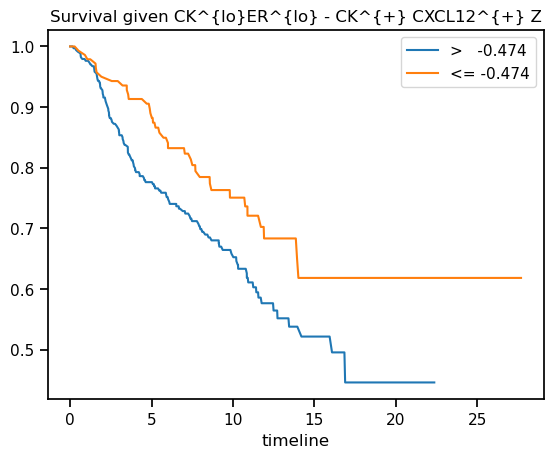

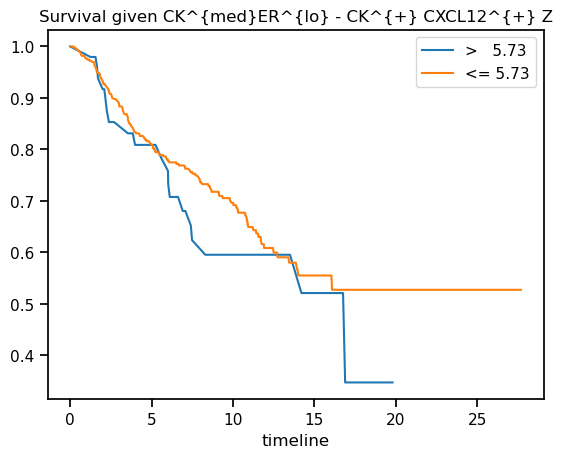

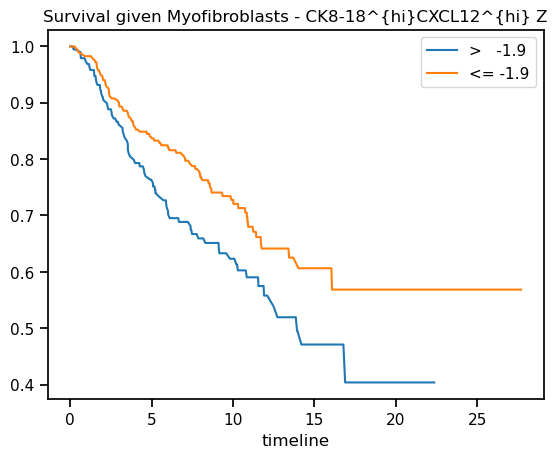

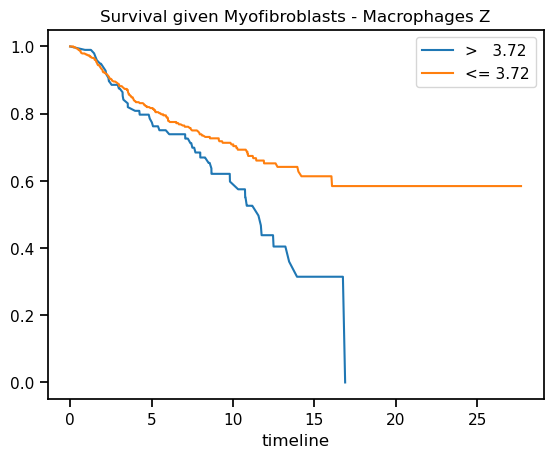

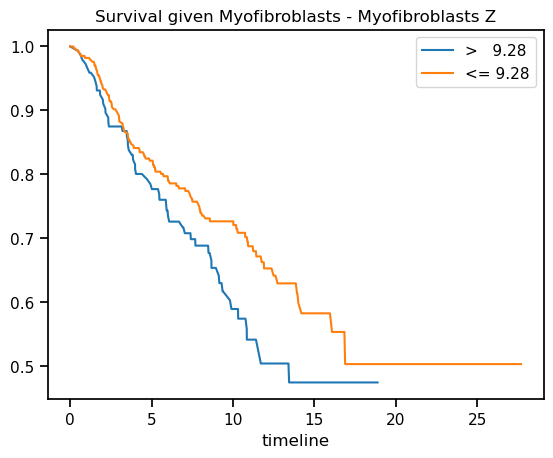

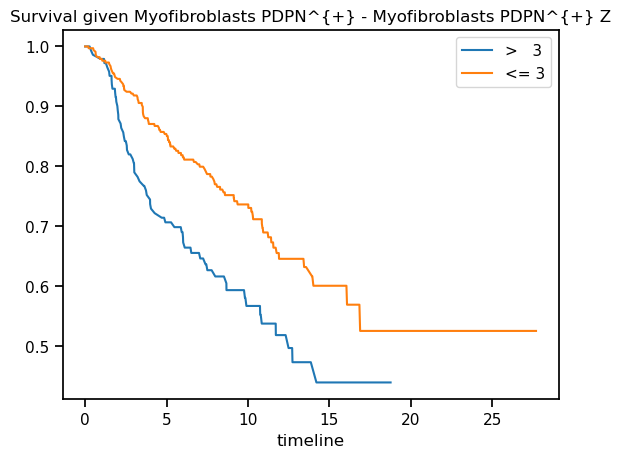

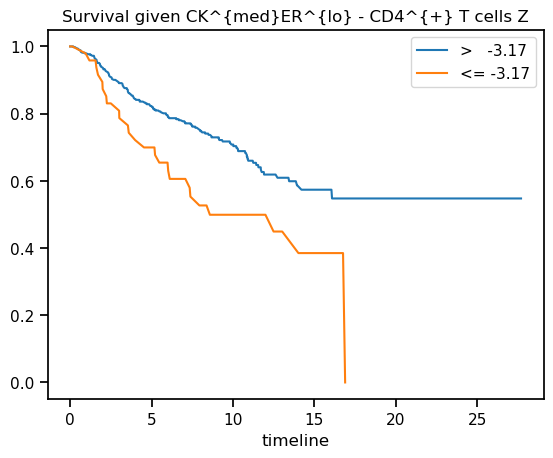

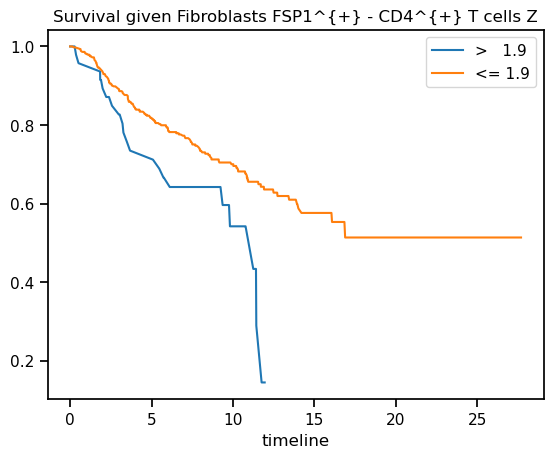

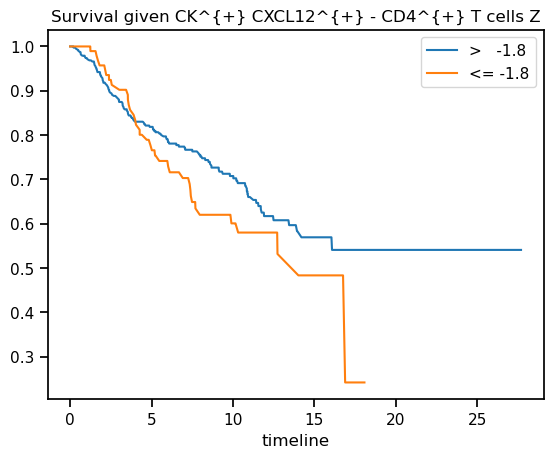

In [302]:
for variable_name in coefs_sig:

    best_thresh, best_perc, best_p_val = mosna.find_best_survival_threshold(df_surv, variable_name, duration_col, event_col)
    print(variable_name)
    print(f'best_thresh: {best_thresh:.3g}')
    print(f'best_perc: {best_perc:.3g}')
    print(f'best_p_val: {best_p_val:.3g}')

    mosna.plot_survival_threshold(df_surv, variable_name, duration_col, event_col, best_thresh, with_confidence=False)

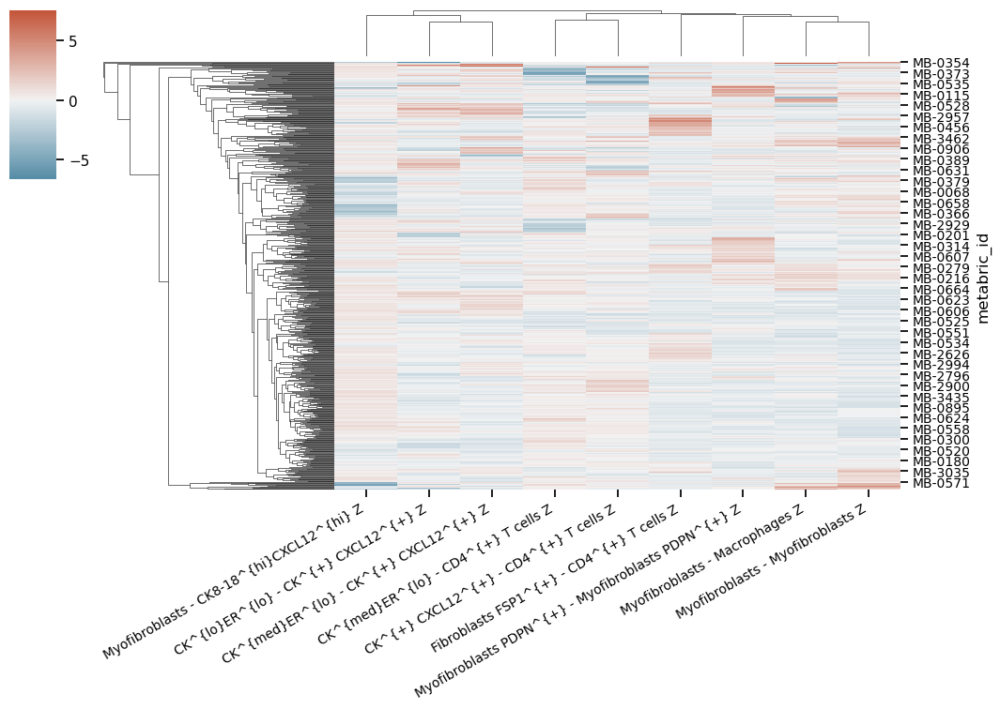

In [303]:
# It is possible to have a look at the clustering of these coefficients
# but in this case we don't see an obvious clustering of patients

mosna.plot_heatmap(
    z_net_stats_cleaned[coefs_sig].reset_index(), 
    obs_labels=patient_col, 
    group_var=None, 
    groups=None,
    # figsize=(20, 12),
    dendrogram_ratio=[0.3, 0.1],
    cbar_pos=(-0.07, 0.8, 0.05, 0.18)
    )

## Pre-loading

In [314]:
import warnings
from sklearn.exceptions import ConvergenceWarning, FitFailedWarning
warnings.simplefilter('ignore', FitFailedWarning)
warnings.simplefilter('ignore', ConvergenceWarning)
warnings.simplefilter('ignore', FutureWarning)
warnings.simplefilter('ignore', DeprecationWarning)
warnings.simplefilter('ignore', UserWarning)
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
from time import time
import warnings
import joblib
from pathlib import Path
from time import time
from tqdm import tqdm
import copy
import matplotlib as mpl
import napari
import colorcet as cc
import composition_stats as cs
from sklearn.impute import KNNImputer
from lifelines import KaplanMeierFitter, CoxPHFitter
from sksurv.linear_model import CoxPHSurvivalAnalysis, CoxnetSurvivalAnalysis
from sksurv.preprocessing import OneHotEncoder
from sklearn.model_selection import GridSearchCV, KFold
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
import warnings
from sklearn.exceptions import FitFailedWarning
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from importlib import reload

# from tysserand import tysserand as ty
# from mosna import mosna

import matplotlib as mpl
mpl.rcParams["figure.facecolor"] = 'white'
mpl.rcParams["axes.facecolor"] = 'white'
mpl.rcParams["savefig.facecolor"] = 'white'

print('loading data')
data_dir = Path("../../data/raw/IMC_Breast_cancer_Danenberg_2022")
objects_path = data_dir / "SingleCells.csv"
objects_path
if objects_path.with_suffix('.parquet').exists():
    obj = pd.read_parquet(objects_path.with_suffix('.parquet'))
else:
    obj = pd.read_csv(objects_path)
    # for latter use
    obj.to_parquet(objects_path.with_suffix('.parquet'))

loading data


In [315]:

obj.rename(columns={'Location_Center_X': 'x', 'Location_Center_Y': 'y'}, inplace=True)
sample_col = 'ImageNumber'  # != from `sample_cols`
patient_col = 'metabric_id'
pheno_col = 'cellPhenotype'
sample_cols = [sample_col, patient_col, pheno_col, 'ObjectNumber']
# this file contains 'c-Caspase3c-PARP' instead of 'c-Caspase3c' as in the dataframe
# all_epitopes = pd.read_csv(data_dir / 'markerStackOrder.csv').iloc[:, 1].values
# so instead we directly do:
all_epitopes = obj.columns[11:50].values
# remove Histone H3 and DNA markers
marker_cols = list(all_epitopes[1:-2])
pos_cols = ['x', 'y']
cell_type_cols = [
    'is_epithelial',
    'is_tumour',
    'is_normal',
    'is_dcis',
    'is_interface',
    'is_perivascular',
    'is_hotAggregate',
    ]
nb_phenotypes = obj[pheno_col].unique().size
all_cols = sample_cols + marker_cols + pos_cols + cell_type_cols + [pheno_col]
# columns we want to include in network data
net_cols = pos_cols + [pheno_col] + cell_type_cols + marker_cols

print(f'nb phenotypes: {nb_phenotypes}')
print(f'nb used markers: {len(marker_cols)}')

# Show number of cells per sample
sample_sizes = obj[['ImageNumber', 'ObjectNumber']].groupby(['ImageNumber']).count()

# # aggregate unique pairs of patients and image IDs
# sample_patient_counts = obj[sample_cols].groupby([sample_col, patient_col]).count()
# print(sample_patient_counts)

# # count occurrences of patient IDs in patient / image pairs
# occ = sample_patient_counts.index.get_level_values(1).value_counts()
# print(occ)

# n_patient_multiple = np.sum(occ.values != 1)
# print(f'There are {n_patient_multiple} patients with multiple samples')

# sample_patient_mapper = dict(sample_patient_counts.index.values)

# ------ Survival data ------


nb phenotypes: 32
nb used markers: 36


In [316]:

survival_path = data_dir / "IMCClinical.csv"
surv = pd.read_csv(survival_path, index_col=0)

net_size_threshold = 150

select = sample_sizes['ObjectNumber'] >= net_size_threshold
print(f"there are {select.sum()} samples with > {net_size_threshold} cells, discarding {len(select) - select.sum()} samples")
sample_sizes = sample_sizes.loc[select, :]
uniq_samples = sample_sizes.index.values

print(f"filtering small samples, full dataframe dropping from {len(obj)} cells to", end=' ')
obj = obj.query("ImageNumber in @uniq_samples")
print(f'{len(obj)} cells')

print(f"survival data dropping from {len(surv)} patients to", end=' ')
uniq_patients = obj['metabric_id'].unique()
surv = surv.query("metabric_id in @uniq_patients")
print(f'{len(surv)} patients')

# make common color mapper
cycle_cmap = False

nodes_labels = obj[pheno_col]
uniq = pd.Series(nodes_labels).value_counts().index

if nodes_labels is not None:
    nb_clust = nodes_labels.max()
    uniq = pd.Series(nodes_labels).value_counts().index

    # choose colormap
    clusters_cmap = mosna.make_cluster_cmap(uniq)
    # make color mapper
    # series to sort by decreasing order
    n_colors = len(clusters_cmap)
    celltypes_color_mapper = {x: clusters_cmap[i % n_colors] for i, x in enumerate(uniq)}


# ------ All samples network reconstruction ------

processed_dir = Path('../data/processed/IMC_breast_cancer')
dir_fig_save = processed_dir / 'figures'

trim_dist = 200 # or 'percentile_size'
min_neighbors = 3 # number of nearest nodes to connect for each unconneted node

reconst_dir = processed_dir / f"samples_networks_xy_min_size-{net_size_threshold}_solitary-{min_neighbors}"
save_dir = reconst_dir / "networks_images_common_cmap_saturated_first"
save_dir.mkdir(parents=True, exist_ok=True)
edges_dir = reconst_dir
nodes_dir = reconst_dir

n_uniq_patients = len(uniq_patients)
n_uniq_samples = len(uniq_samples)

# ------ Response groups characteristics and survival analysis ------

# we add attributes to nodes to color network figures
nodes_all = obj[pos_cols + [pheno_col]].copy()
nodes_all = nodes_all.join(pd.get_dummies(obj[pheno_col]))
uniq_phenotypes = nodes_all[pheno_col].unique()  # 'attribute_uniq' in other notebooks

# here we don't use `sample_col` but `patient_col` in the group / unstack procedure to aggregate 
# statistics per patient and condition rather than per sample.

count_types = obj[[patient_col, pheno_col, sample_col]].groupby([patient_col, pheno_col]).count().unstack()
count_types.columns = count_types.columns.droplevel()
count_types = count_types.fillna(value=0).astype(int)
# count_types.index.name = 'sample'
count_types.to_csv(save_dir / 'count_types_per_patient.csv')

total_count_types = count_types.sum().sort_values(ascending=False)

prop_types = count_types.div(count_types.sum(axis=1), axis=0)

surv_orig = surv.copy()
surv = surv.loc[~surv['isValidation'], :]
surv.drop(columns=['isValidation'], inplace=True)

# replace some values with numbers for fitting
mapper_str = {
    'pos': 1,
    'neg': 0,
    np.nan: np.nan,
}
surv.loc[:, 'ERStatus'] = surv['ERStatus'].map(mapper_str)

mapper_bool = {
    True: 1,
    False: 0,
    np.nan: np.nan,
}
surv.loc[:, 'ERBB2_pos'] = surv['ERBB2_pos'].map(mapper_bool)

duration_col = 'yearsToStatus'
event_col = 'DeathBreast'
covariates = ['ERStatus'] #, 'ERBB2_pos'] # else []
strata = 'ERStatus'
drop_last_column = True   # because we use proportions last column is fully determined
drop_nan = True
if drop_last_column:
    df_surv = prop_types.iloc[:, :-1].join(surv[[duration_col, event_col] + covariates], how='inner')
else:
    df_surv = prop_types.join(surv[[duration_col, event_col] + covariates], how='inner')
if drop_nan:
    n_obs_orig = len(df_surv)
    df_surv.dropna(axis=0, inplace=True)
    n_obs = len(df_surv)
    if n_obs != n_obs_orig:
        print(f'discarded {n_obs_orig - n_obs} / {n_obs_orig} observations with NaN')

there are 756 samples with > 150 cells, discarding 38 samples
filtering small samples, full dataframe dropping from 1123466 cells to 1120100 cells
survival data dropping from 709 patients to 672 patients
discarded 15 / 509 observations with NaN


## Cellular neighborhoods

In [317]:
method = 'NAS'
# method = 'SCAN-IT'

order = 1
var_type = 'cell-types'
# stat_names = 'mean-std'
stat_funcs = np.mean
stat_names = 'mean'
# aggreg_vars = pheno_cols

# as we use cell types, we don't need to save data in a folder dedicated to a particular nodes data transformation
nodes_dir = edges_dir

# directory of spatial omic features
if method == 'NAS':
    sof_dir = nodes_dir / f"nas_on-{var_type}_stats-{stat_names}_order-{order}"    
    sof_dir.mkdir(parents=True, exist_ok=True)
elif method == 'SCAN-IT':
    sof_dir = nodes_dir / f"scanit_on-{var_type}"    
    sof_dir.mkdir(parents=True, exist_ok=True)

# For UMAP visualization
marker = '.'
size_points = 10

In [318]:
edges_dir

PosixPath('../data/processed/IMC_breast_cancer/samples_networks_xy_min_size-150_solitary-3')

In [319]:
filename = sof_dir / f'aggregation_statistics.parquet'

if filename.exists():
    print('Load aggregation statistics')
    var_aggreg = pd.read_parquet(filename)
else:
    print('Compute aggregation statistics')
    var_aggreg = mosna.compute_spatial_omic_features_all_networks(
        method=method,
        nodes_dir=nodes_dir,
        edges_dir=edges_dir, 
        attributes_col=pheno_col,
        use_attributes=uniq_phenotypes, 
        make_onehot=True,
        stat_funcs=stat_funcs,
        stat_names=stat_names,
        id_level_1='patient',
        id_level_2='sample', 
        parallel_groups=False, #'max', 
        memory_limit='max',
        save_intermediate_results=False, 
        dir_save_interm=None,
        verbose=1,
        )
    var_aggreg.to_parquet(filename, index=False)

Compute aggregation statistics


data: 100%|██████████| 756/756 [02:23<00:00,  5.27it/s]


In [320]:
var_aggreg

,CK^{med}ER^{lo} mean,ER^{hi}CXCL12^{+} mean,CD4^{+} T cells & APCs mean,CD4^{+} T cells mean,Endothelial mean,Fibroblasts mean,Myofibroblasts PDPN^{+} mean,CD8^{+} T cells mean,CK8-18^{hi}CXCL12^{hi} mean,Myofibroblasts mean,...,HER2^{+} mean,B cells mean,Basal mean,Fibroblasts FSP1^{+} mean,Granulocytes mean,MHC I^{hi}CD57^{+} mean,Ep CD57^{+} mean,MHC^{hi}CD15^{+} mean,patient,sample
0,0.25,0.0,0.0,0.0,0.00,0.000000,0.0,0.000000,0.500000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,MB-0366,181
1,0.00,0.0,0.0,0.0,0.25,0.250000,0.0,0.000000,0.250000,0.250000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,MB-0366,181
2,0.00,0.0,0.0,0.0,0.00,0.000000,0.0,0.000000,1.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,MB-0366,181
3,0.00,0.0,0.0,0.0,0.00,0.000000,0.0,0.000000,1.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,MB-0366,181
4,0.00,0.0,0.0,0.0,0.00,0.000000,0.0,0.000000,0.666667,0.166667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,MB-0366,181
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
351,0.00,0.0,0.0,0.0,0.00,0.800000,0.2,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,MB-0268,72
352,0.00,0.0,0.0,0.0,0.00,0.666667,0.0,0.166667,0.000000,0.166667,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,MB-0268,72
353,0.00,0.0,0.0,0.0,0.00,0.800000,0.0,0.000000,0.000000,0.200000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,MB-0268,72
354,0.00,0.0,0.0,0.0,0.00,0.600000,0.0,0.200000,0.000000,0.200000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,MB-0268,72


In [321]:
var_aggreg_samples_info = var_aggreg[['patient', 'sample']]
var_aggreg.drop(columns=['patient', 'sample'], inplace=True)

### Clustering directly on NAS

In [322]:
var_aggreg.shape

(1120100, 32)

In [ ]:
# cluster_params = {
#     'reducer_type': 'none', 
#     'avoid_neigh_overflow': False, 
#     'metric': 'manhattan',
#     'min_dist': 0.0,
#     'clusterer_type': 'leiden', 
#     'dim_clust': 2, 
#     'k_cluster': 15, 
#     'resolution_parameter': 0.00005,
# }

In [323]:
import leidenalg as la
from time import time

k_cluster = 15
metric = 'euclidean'
resolution = 0.005
embedding = var_aggreg.values

In [324]:
durations = []
sizes = []

for sub in [200, 150, 100, 75, 50, 30, 25, 20, 15, 10, 5]:
    size = len(embedding[::sub, :])
    sizes.append(size)
    start = time()
    embedding_pairs = ty.build_knn(embedding[::sub, :], k=k_cluster, metric=metric)
    duration = time() - start
    durations.append(duration)
    print(f'subsampling {sub}: {duration:.2f} s')

subsampling 200: 4.57 s
subsampling 150: 0.92 s
subsampling 100: 1.33 s
subsampling 75: 1.77 s
subsampling 50: 2.68 s
subsampling 30: 4.41 s
subsampling 25: 5.18 s
subsampling 20: 6.42 s
subsampling 15: 8.47 s
subsampling 10: 12.60 s
subsampling 5: 25.65 s


In [325]:
durations = pd.DataFrame(data=durations, index=sizes, columns=['duration'])

In [326]:
durations

,duration
5601,4.566563
7468,0.920237
11201,1.333751
14935,1.768557
22402,2.678736
37337,4.413990
44804,5.176506
56005,6.415416
74674,8.472283
112010,12.604844


<Axes: >

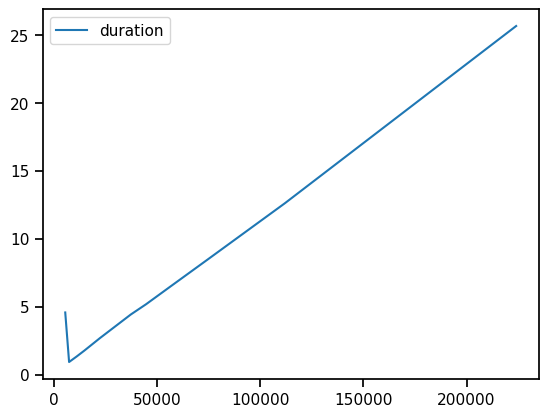

In [327]:
durations.plot()

The knn graph scales linearly with the data size

In [328]:
start = time()
embedding_pairs = ty.build_knn(embedding, k=k_cluster, metric=metric)
duration = time() - start
print(f'{duration:.2f} s')

130.96 s


In [329]:
edges_np = np.hstack((embedding_pairs, np.ones((len(embedding_pairs), 1)))).astype(np.int32)
edges = pd.DataFrame(edges_np, columns=['src', 'dst', 'weight'])
G = ty.to_iGraph(embedding, embedding_pairs)

In [330]:
resolutions = [0.05, 0.005, 0.0005]
n_clusters = []

for resolution in resolutions:
    print(f'resolution {resolution}', end=': ')
    partition = la.find_partition(G, la.RBConfigurationVertexPartition, resolution_parameter=resolution) #, seed=0)
    # or other partition such as la.RBERVertexPartition
    cluster_labels = np.array(partition.membership)
    cluster_labels = mosna.to_numpy(cluster_labels)
    n_clusters.append(cluster_labels.max())
    print(cluster_labels.max())

resolution 0.05: 2177
resolution 0.005: 1297
resolution 0.0005: 975


With 32 dimensions we have (too) many clusters

Try subsampling for comparison with clustering on UMAP of subsampled data

In [331]:
sub = 20
data = var_aggreg.values[::sub, :]

In [332]:
start = time()
embedding_pairs = ty.build_knn(data, k=k_cluster, metric=metric)
duration = time() - start
print(f'{duration:.2f} s')

edges_np = np.hstack((embedding_pairs, np.ones((len(embedding_pairs), 1)))).astype(np.int32)
edges = pd.DataFrame(edges_np, columns=['src', 'dst', 'weight'])
G = ty.to_iGraph(data, embedding_pairs)

6.50 s


In [333]:
resolutions = [0.05, 0.005, 0.0005]
n_clusters = []
niches_raw_sub = []

for resolution in resolutions:
    print(f'resolution {resolution}', end=': ')
    partition = la.find_partition(G, la.RBConfigurationVertexPartition, resolution_parameter=resolution) #, seed=0)
    # or other partition such as la.RBERVertexPartition
    cluster_labels = np.array(partition.membership)
    cluster_labels = mosna.to_numpy(cluster_labels)
    niches_raw_sub.append(cluster_labels)
    n_clusters.append(cluster_labels.max())
    print(cluster_labels.max())

resolution 0.05: 56
resolution 0.005: 20
resolution 0.0005: 8


Cluster on UMAP of subsampled data

In [334]:
from umap import UMAP

In [335]:
random_state = None
n_components = 2
n_neighbors=15
metric='manhattan'
min_dist=0.0

reducer = UMAP(
    random_state=random_state,
    n_components=n_components,
    n_neighbors=n_neighbors,
    metric=metric,
    min_dist=min_dist,
    )
if isinstance(data, pd.DataFrame):
    embedding = reducer.fit_transform(data.values)
else:
    embedding = reducer.fit_transform(data)

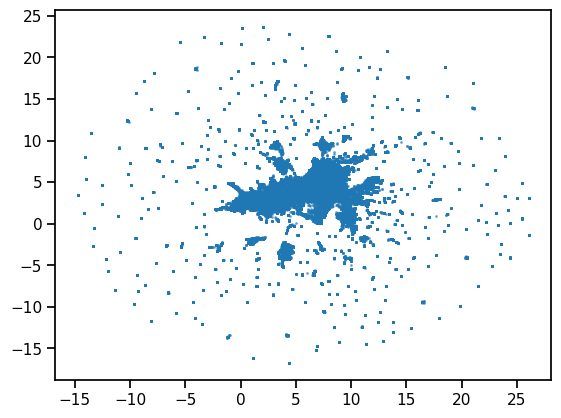

In [336]:
plt.scatter(embedding[:,0], embedding[:,1], marker='.', s=5, alpha=0.5)

Lower subsampling rate

In [337]:
sub = 10
data = var_aggreg.values[::sub, :]

In [338]:
start = time()
embedding_pairs = ty.build_knn(embedding, k=k_cluster, metric=metric)
duration = time() - start
print(f'{duration:.2f} s')

edges_np = np.hstack((embedding_pairs, np.ones((len(embedding_pairs), 1)))).astype(np.int32)
edges = pd.DataFrame(edges_np, columns=['src', 'dst', 'weight'])
G = ty.to_iGraph(embedding, embedding_pairs)

6.35 s


In [340]:
resolutions = [0.05, 0.005, 0.0005]
n_clusters = []
niches_dimred_sub = []

for resolution in resolutions:
    print(f'resolution {resolution}', end=': ')
    partition = la.find_partition(G, la.RBConfigurationVertexPartition, resolution_parameter=resolution) #, seed=0)
    # or other partition such as la.RBERVertexPartition
    cluster_labels = np.array(partition.membership)
    cluster_labels = mosna.to_numpy(cluster_labels)
    niches_dimred_sub.append(cluster_labels)
    n_clusters.append(cluster_labels.max())
    print(cluster_labels.max())

resolution 0.05: 370
resolution 0.005: 354
resolution 0.0005: 350


In [341]:
start = time()
embedding_pairs = ty.build_knn(data, k=k_cluster, metric=metric)
duration = time() - start
print(f'{duration:.2f} s')

edges_np = np.hstack((embedding_pairs, np.ones((len(embedding_pairs), 1)))).astype(np.int32)
edges = pd.DataFrame(edges_np, columns=['src', 'dst', 'weight'])
G = ty.to_iGraph(data, embedding_pairs)

12.53 s


In [342]:
resolutions = [0.05, 0.005, 0.0005]
n_clusters = []
niches_raw_sub = []

for resolution in resolutions:
    print(f'resolution {resolution}', end=': ')
    partition = la.find_partition(G, la.RBConfigurationVertexPartition, resolution_parameter=resolution) #, seed=0)
    # or other partition such as la.RBERVertexPartition
    cluster_labels = np.array(partition.membership)
    cluster_labels = mosna.to_numpy(cluster_labels)
    niches_raw_sub.append(cluster_labels)
    n_clusters.append(cluster_labels.max())
    print(cluster_labels.max())

resolution 0.05: 111
resolution 0.005: 50
resolution 0.0005: 31


In [343]:
random_state = None
n_components = 2
n_neighbors=15
metric='manhattan'
min_dist=0.0

reducer = UMAP(
    random_state=random_state,
    n_components=n_components,
    n_neighbors=n_neighbors,
    metric=metric,
    min_dist=min_dist,
    )
if isinstance(data, pd.DataFrame):
    embedding = reducer.fit_transform(data.values)
else:
    embedding = reducer.fit_transform(data)

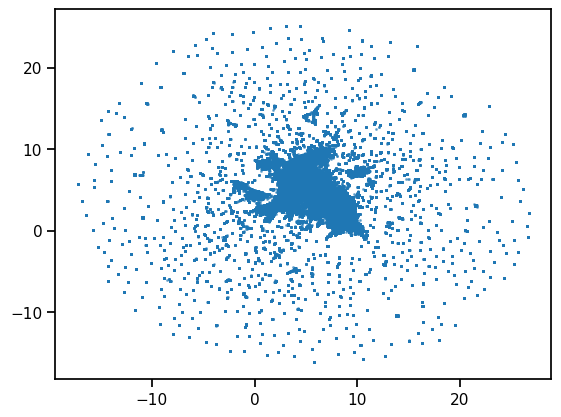

In [344]:
plt.scatter(embedding[:,0], embedding[:,1], marker='.', s=5, alpha=0.5)

In [345]:
start = time()
embedding_pairs = ty.build_knn(embedding, k=k_cluster, metric=metric)
duration = time() - start
print(f'{duration:.2f} s')

edges_np = np.hstack((embedding_pairs, np.ones((len(embedding_pairs), 1)))).astype(np.int32)
edges = pd.DataFrame(edges_np, columns=['src', 'dst', 'weight'])
G = ty.to_iGraph(embedding, embedding_pairs)

13.16 s


In [346]:
resolutions = [0.05, 0.005, 0.0005]
n_clusters = []
niches_dimred_sub = []

for resolution in resolutions:
    print(f'resolution {resolution}', end=': ')
    partition = la.find_partition(G, la.RBConfigurationVertexPartition, resolution_parameter=resolution) #, seed=0)
    # or other partition such as la.RBERVertexPartition
    cluster_labels = np.array(partition.membership)
    cluster_labels = mosna.to_numpy(cluster_labels)
    niches_dimred_sub.append(cluster_labels)
    n_clusters.append(cluster_labels.max())
    print(cluster_labels.max())

resolution 0.05: 897
resolution 0.005: 885
resolution 0.0005: 878


In [347]:
cluster_params = {
    'reducer_type': 'umap', 
    'n_neighbors': 15, 
    'metric': 'manhattan',
    'min_dist': 0.0,
    'clusterer_type': 'leiden', 
    'dim_clust': 2, 
    'k_cluster': 15, 
    'resolution_parameter': 0.00005,
}

embedding, _ = mosna.get_reducer(
    var_aggreg, 
    sof_dir, 
    reducer_type=cluster_params['reducer_type'], 
    n_neighbors=cluster_params['n_neighbors'], 
    metric=cluster_params['metric'],
    )

Computing dimensionality reduction


In [354]:
embedding

array([[  0.7856092 ,  -3.501268  ],
       [  6.1376114 ,  -2.1452508 ],
       [-12.722027  ,   4.969892  ],
       ...,
       [ -8.640811  ,  -0.845954  ],
       [-10.945938  ,   0.31335324],
       [  4.7184014 , -12.114058  ]], dtype=float32)

In [355]:
cluster_params = {
    'reducer_type': 'umap', 
    'n_neighbors': 15, 
    'metric': 'manhattan',
    'min_dist': 0.0,
    'clusterer_type': 'leiden', 
    'dim_clust': 2, 
    'k_cluster': 15, 
    'resolution_parameter': 0.00005,
}

cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)
print(cluster_labels, cluster_dir, nb_clust, _)

Loading reducer object and reduced coordinates
Performing clustering
Found 11514 clusters
[1658 1993    5 ...   27  251    4] ../data/processed/IMC_breast_cancer/samples_networks_xy_min_size-150_solitary-3/nas_on-cell-types_stats-mean_order-1/reducer-umap_dim-2_nneigh-15_metric-manhattan_min_dist-0.0/clusterer-leiden_n_neighbors-15 11514              src      dst  weight
0              0    13123       1
1              0   388270       1
2              0   500571       1
3              0   500694       1
4              0   501277       1
...          ...      ...     ...
9714607  1120003  1120025       1
9714608  1120005  1120051       1
9714609  1120007  1120010       1
9714610  1120061  1120065       1
9714611  1120071  1120097       1

[9714612 rows x 3 columns]


In [ ]:
# cluster_params = {
#     'reducer_type': 'umap', 
#     'n_neighbors': 15, 
#     'metric': 'manhattan',
#     'min_dist': 0.0,
#     'clusterer_type': 'leiden', 
#     'dim_clust': 2, 
#     'k_cluster': 15, 
#     'resolution': 0.005,
# }
# cluster_params = {
#     'reducer_type': 'umap', 
#     'n_neighbors': 15, 
#     'metric': 'manhattan',
#     'min_dist': 0.0,
#     'dim_clust': 2, 
#     'flavor': 'CellCharter',
#     'n_clusters': 10,
# }
cluster_params = {
    'reducer_type': 'umap', 
    'n_neighbors': 15, 
    'metric': 'manhattan',
    'min_dist': 0.0,
    'clusterer_type': 'spectral', 
    'dim_clust': 2, 
    # 'k_cluster': 15, 
    'n_clusters': 10,
}
# cluster_params = {
#     'reducer_type': 'umap', 
#     'n_neighbors': 75, 
#     'metric': 'manhattan',
#     'min_dist': 0.0,
#     'clusterer_type': 'hdbscan', 
#     'dim_clust': 3, 
#     # 'k_cluster': 15, 
#     # 'n_clusters': 20,
#     'min_cluster_size': 0.01,
# }

cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

embed_viz, _ = mosna.get_reducer(
    var_aggreg, 
    sof_dir, 
    reducer_type=cluster_params['reducer_type'], 
    n_neighbors=cluster_params['n_neighbors'], 
    metric=cluster_params['metric'],
    )


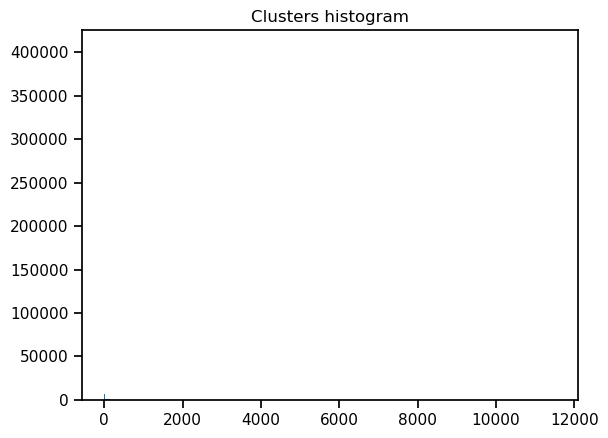

In [356]:
class_id, class_count = np.unique(cluster_labels, return_counts=True)
plt.bar(class_id, class_count, width=0.8);
plt.title('Clusters histogram');

In [357]:
select = cluster_labels != -1

In [358]:
select.shape

(1120100,)

In [366]:
reload(mosna)
fig, ax, niches_color_mapper = mosna.plot_clusters(
    embed_viz[select, :], 
    cluster_labels=cluster_labels[select], 
    save_dir=sof_dir, 
    cluster_params=cluster_params, 
    return_cmap=True,
    # extra_str='_no_cluster_id', 
    show_id=False,
    legend=True,
    figsize=(2,2)
    )

embed_viz (1120100, 2)
select [False False False ... False False False]
embed_viz (1120100, 2)
select [False False False ... False False False]
embed_viz (1120100, 2)
select [False False False ... False False False]
embed_viz (1120100, 2)
select [False False False ... False False False]
embed_viz (1120100, 2)
select [False False False ... False False  True]
embed_viz (1120100, 2)
select [False False  True ... False False False]
embed_viz (1120100, 2)
select [False False False ... False False False]
embed_viz (1120100, 2)
select [False False False ... False False False]
embed_viz (1120100, 2)
select [False False False ... False False False]
embed_viz (1120100, 2)
select [False False False ... False False False]
embed_viz (1120100, 2)
select [False False False ... False False False]
embed_viz (1120100, 2)
select [False False False ... False False False]
embed_viz (1120100, 2)
select [False False False ... False False False]
embed_viz (1120100, 2)
select [False False False ... False False

ValueError: Image size of 52x83965 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 60x60 with 1 Axes>

In [ ]:
# ValueError: Image size of 252x260696 pixels is too large. It must be less than 2^16 in each direction.

In [368]:
plt.savefig('figure.png', dpi=20)  # Adjust DPI as needed
os.getcwd()

'/home/abdelmounim.essabbar/Projects/mosna_benchmark/benchmarking/mosna_repo'

<Figure size 640x480 with 0 Axes>

### Survival analysis

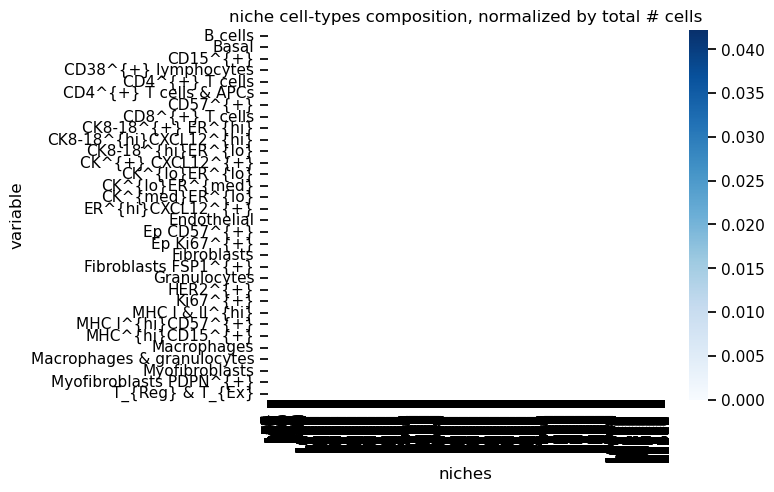

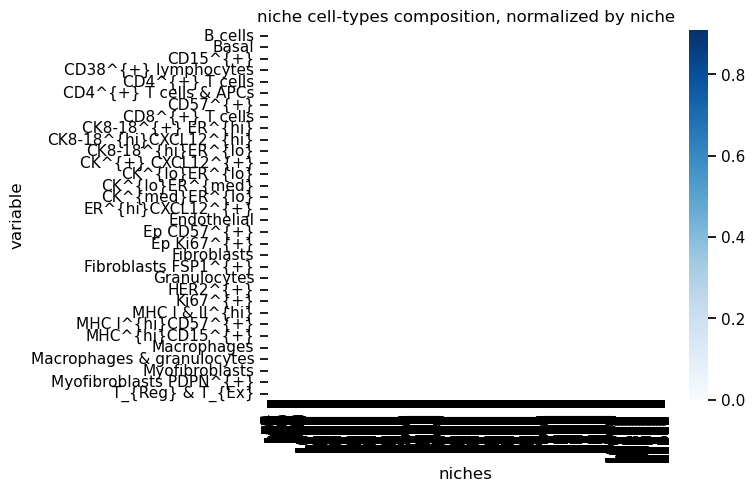

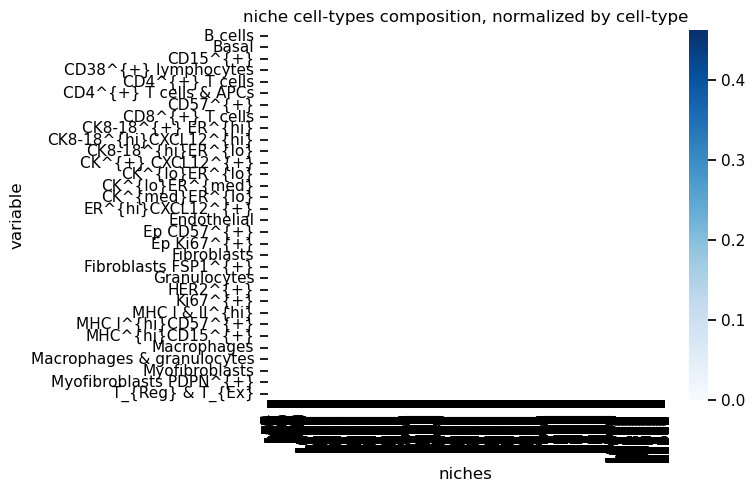

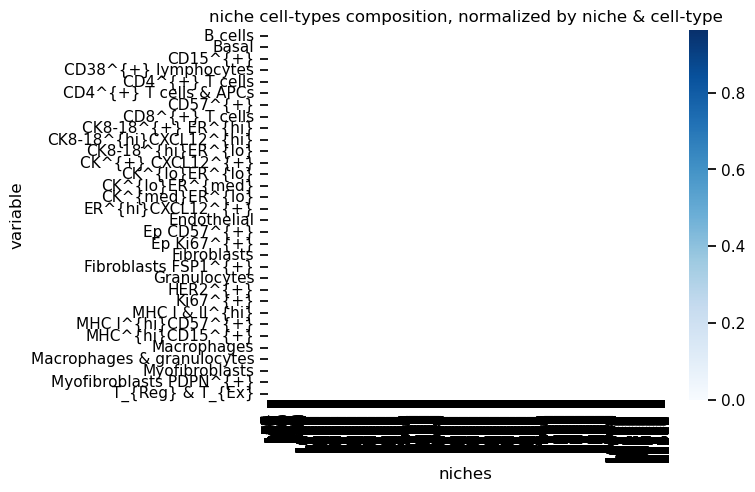

In [369]:
# assert(len(nodes_all) == len(var_aggreg))

cell_types = nodes_all[pheno_col]
niches = cluster_labels
other_str = ''

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
title = "niche cell-types composition, normalized by total # cells"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
title = "niche cell-types composition, normalized by niche"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
title = "niche cell-types composition, normalized by cell-type"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche&obs')
title = "niche cell-types composition, normalized by niche & cell-type"
plt.title(title)
plt.savefig(cluster_dir / title, bbox_inches='tight', facecolor='white')

Here niches are very similar. This is partly due to the prevalence of few cell types like Fibroblasts, but also we haven't optimized the niche definition yet.

### Improve CoxPH model fitting

#### Explore different clustering wrt survival

In [371]:
sof_dir

PosixPath('../data/processed/IMC_breast_cancer/samples_networks_xy_min_size-150_solitary-3/nas_on-cell-types_stats-mean_order-1')

In [372]:
def surv_col_to_numpy(df_surv, event_col, duration_col):
    y_df = df_surv[[event_col, duration_col]].copy()
    y_df.loc[:, event_col] = y_df.loc[:, event_col].astype(bool)
    records = y_df.to_records(index=False)
    y = np.array(records, dtype = records.dtype.descr)
    return y

In [373]:
RUN_LONG = False

In [378]:
# WIP

def make_reducer_knn_network(
        data,
        save_dir,
        reducer_type='umap', 
        n_neighbors=15, 
        metric='manhattan', 
        min_dist=0.0,
        clusterer_type='leiden', 
        dim_clust=2, 
        k_cluster=15, 
        n_clusters=None,
        flavor=None,
        use_gpu=True,
        random_state=None,
        save_net_data=True,
        verbose=1,
        ):
    """
    Generate or load a clustering model and cluster labels.

    Parameters
    ----------
    data : ndarray
        Dataset on which we want to apply the DR method.
    save_dir : str or pathlib Path object
        Directory where the DR model and transformed data are stored.
    reducer_type : str
        DR method, can be 'umap', for now, other ones coming soon.
    n_components : int
        Number of final dimensions.
    n-neighbors : int
        Number of closest neighbors used in various DR methods.
    metric : str
        Type of distance used.
    min_dist : float
        Minimum distance between DRed data, we usually want 0.
    clusterer_type : str
        Clustering algorithm to partition data, either 'leiden', 'ecg' for Ensemble 
        Clustering for Graphs, 'spectral' for balanced spectral clustering or 'gmm' 
        for Gaussian Mixture Model.
    dim_clust : int
        Dimensionality of the reducede space in which data is clustered.
        A higher number allows for more complex cluster shapes, but introduces outliers.
    k_cluster : int
        Number of neighbors considered during the clustering.
    resolution : float
        Level of details of the clustering. A higher number increases the level of details.
    n_clusters : int, None
        Number of target clusters, used with GaussianMixtureModel clusterer.
    ecg_min_weight : float, 0.05
        min_weight parameter for the ecg method.
    ecg_ensemble_size : int, 20
        ensemble_size parameter for the ecg method.
    flavor : str, None
        If 'CellCharter', uses UMAP for dimensionality reduction, and a gaussian mixture
        model for clustering. 
    force_recompute : bool
        Whether computation occurs even if results already exist in `save_dir`.
    use_gpu : boo
        If True, GMM clustering leverages GPU.
    
    Returns
    -------
    embedding : ndarray
        Reduced coordinates of the dataset.
    reducer : object
        The DR model, its type depends on the choosen DR method.

    Example
    -------
    >>> np.random.seed(0)
    >>> data = np.random.rand(800, 4)
    >>> cluster_labels, cluster_dir, nb_clust, G = get_clusterer(data, "test")
    """

    if flavor is not None:
        if flavor == 'UTAG':
            print('not implemented yet')
        elif flavor == 'CellCharter':
            reducer_type = 'umap'
            clusterer_type = 'gmm'
            if n_clusters is None:
                n_clusters = 10
    reducer_name = f"reducer-{reducer_type}_dim-{dim_clust}_nneigh-{n_neighbors}_metric-{metric}_min_dist-{min_dist}"
    reducer_dir = Path(save_dir) / reducer_name
    # knn network in reduced space, common to several clustering methods:
    reduced_net_path = reducer_dir / f'edges_n_neighbors-{k_cluster}.parquet'

        
    # load estimator or network data for return
    if reduced_net_path.exists() :
        if use_gpu and gpu_clustering:
            edges = cudf.read_parquet(reduced_net_path)
        else:
            edges = pd.read_parquet(reduced_net_path)
        save_net_data = False
    else:
        # get the embedding of data
        embedding, _ = get_reducer(
            data, save_dir, reducer_type, dim_clust, n_neighbors, 
            metric, min_dist, random_state=random_state, verbose=verbose)
        if verbose > 0: 
            print("Performing clustering")

    if reduced_net_path.exists():
        if verbose > 1:
            print('loading knn graph')
        if gpu_clustering:
            edges = cudf.read_parquet(reduced_net_path)
            # send edges to GPU, with dummy weights
            G = cugraph.Graph()
            G.from_cudf_edgelist(
                edges, 
                source='src', 
                destination='dst', 
                edge_attr='weight', 
                renumber=False,
                )
        else:
            edges = pd.read_parquet(reduced_net_path)
            embedding_pairs = edges['src', 'dst'].values
            G = ty.to_iGraph(embedding, embedding_pairs)
    else:
        # need to build knn graph
        if verbose > 1:
            print('building knn graph')
        embedding_pairs = ty.build_knn(embedding, k=k_cluster)


    if save_net_data:
        edges.to_parquet(reduced_net_path)

In [ ]:
# # Make UMAPs networks only, WIP

# if RUN_LONG:
#     # screen NAS parameters
#     # iter_dim_clust = [2, 3, 4, 5, 6]
#     iter_dim_clust = [4, 5]
#     if show_progress:
#         iter_dim_clust = tqdm(iter_dim_clust)
#     for dim_clust in iter_dim_clust:
#         iter_n_neighbors = [15, 45, 75, 100, 200]
#         if show_progress:
#             iter_n_neighbors = tqdm(iter_n_neighbors, leave=False)
#         for n_neighbors in iter_n_neighbors:
#             iter_metric = ['manhattan', 'euclidean', 'cosine']
#             if show_progress:
#                 iter_metric = tqdm(iter_metric, leave=False)
#             for metric in iter_metric:
#                 iter_clusterer_type = ['spectral']
#                 if show_progress:
#                     iter_clusterer_type = tqdm(iter_clusterer_type, leave=False)
#                 for clusterer_type in iter_clusterer_type:

#                     if clusterer_type == 'spectral':
#                         clust_size_param_name = 'n_clusters'
#                         if DEBUG:
#                             iter_clust_size_param = range(3, 6)
#                         else:
#                             iter_clust_size_param = range(3, 20)
#                     elif clusterer_type == 'leiden':
#                         clust_size_param_name = 'resolution'
#                         iter_clust_size_param = [0.1, 0.03, 0.01, 0.003, 0.001]
#                     elif clusterer_type == 'ecg':
#                         clust_size_param_name = 'ecg_ensemble_size'
#                         iter_clust_size_param = [20]
                    
#                     if show_progress:
#                         iter_clust_size_param = tqdm(iter_clust_size_param, leave=False)
#                     for clust_size_param in iter_clust_size_param:
#                         cluster_params = {
#                             'reducer_type': 'umap', 
#                             'n_neighbors': n_neighbors, 
#                             'metric': metric,
#                             'min_dist': 0.0,
#                             'clusterer_type': clusterer_type, 
#                             'dim_clust': dim_clust, 
#                             # 'flavor': 'CellCharter',
#                             clust_size_param_name: clust_size_param,
#                         }
#                         str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])

#                         # try:
#                         cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, verbose=verbose, **cluster_params)
#                         n_clusters = len(np.unique(cluster_labels))

In [379]:
plot_alphas = False
plot_best_model_coefs = False
train_model = True
recompute = False

DEBUG = False
if DEBUG:
    verbose = 2
else:
    verbose = 0
show_progress = False

columns = ['dim_clust', 'n_neighbors', 'metric', 'clusterer_type', 'clust_size_param', 'n_clusters', 'normalize', 'l1_ratio', 'alpha', 'n_coeffs', 'score']
col_types = {
    'dim_clust': int,
    'n_neighbors': int,
    'metric': 'category',
    'clusterer_type': 'category',
    'clust_size_param': float,
    'n_clusters': int,
    'normalize': 'category',
    'l1_ratio': float,
    'alpha': float,
    'n_coeffs': int,
    'score': float,
    }

from sksurv.linear_model import CoxPHSurvivalAnalysis, CoxnetSurvivalAnalysis
from sksurv.preprocessing import OneHotEncoder
from sklearn.model_selection import GridSearchCV, KFold
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
import warnings
from sklearn.exceptions import FitFailedWarning
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler

l1_ratios = [.1, .5, .7, .9, .95, .99, 1]
min_alpha = 0.001
dir_save_interm = sof_dir / 'search_CoxPH'
dir_save_interm.mkdir(parents=True, exist_ok=True)

In [375]:
reload(mosna)

<module 'mosna' from '/home/abdelmounim.essabbar/Projects/mosna_benchmark/benchmarking/mosna_repo/../../mosna/mosna.py'>

In [376]:
RUN_LONG = 1

In [380]:
all_models = []

if RUN_LONG:
    # screen NAS parameters
    iter_dim_clust = [2, 3, 4, 5, 6]
    # iter_dim_clust = [5]
    if show_progress:
        iter_dim_clust = tqdm(iter_dim_clust)
    for dim_clust in iter_dim_clust:
        iter_n_neighbors = [15, 45, 75, 100]
        if show_progress:
            iter_n_neighbors = tqdm(iter_n_neighbors, leave=False)
        for n_neighbors in iter_n_neighbors:
            iter_metric = ['manhattan', 'euclidean', 'cosine']
            if show_progress:
                iter_metric = tqdm(iter_metric, leave=False)
            for metric in iter_metric:
                # iter_clusterer_type = ['hdbscan', 'spectral', 'ecg', 'leiden', 'gmm']
                # iter_clusterer_type = ['spectral', 'ecg', 'leiden', 'gmm']
                iter_clusterer_type = ['spectral']
                if show_progress:
                    iter_clusterer_type = tqdm(iter_clusterer_type, leave=False)
                for clusterer_type in iter_clusterer_type:

                    if clusterer_type == 'spectral':
                        clust_size_param_name = 'n_clusters'
                        if DEBUG:
                            iter_clust_size_param = range(3, 6)
                        else:
                            iter_clust_size_param = range(3, 20)
                    elif clusterer_type == 'leiden':
                        clust_size_param_name = 'min_cluster_size'
                        iter_clust_size_param = [0.1, 0.03, 0.01, 0.003, 0.001]
                    elif clusterer_type == 'hdbscan':
                        clust_size_param_name = 'resolution'
                        iter_clust_size_param = [0.1, 0.03, 0.01, 0.003, 0.001]
                    elif clusterer_type == 'ecg':
                        clust_size_param_name = 'ecg_ensemble_size'
                        iter_clust_size_param = [20]
                    if clusterer_type == 'gmm':
                        clust_size_param_name = 'n_clusters'
                        iter_clust_size_param = range(3, 20)
                    
                    if show_progress:
                        iter_clust_size_param = tqdm(iter_clust_size_param, leave=False)
                    for clust_size_param in iter_clust_size_param:
                        cluster_params = {
                            'reducer_type': 'umap', 
                            'n_neighbors': n_neighbors, 
                            'k_cluster': n_neighbors,
                            'metric': metric,
                            'min_dist': 0.0,
                            'clusterer_type': clusterer_type, 
                            'dim_clust': dim_clust, 
                            # 'flavor': 'CellCharter',
                            clust_size_param_name: clust_size_param,
                        }
                        str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
                        print(str_params)

                        # try:
                        cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, verbose=verbose, **cluster_params)
                        n_clusters = len(np.unique(cluster_labels))

                        # Survival analysis (just heatmap for now)
                        niches = cluster_labels
                        for normalize in ['total', 'niche', 'obs', 'clr', 'niche&obs']:
                            str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
                            str_params = str_params + f'_normalize-{normalize}'

                            results_path = dir_save_interm / f'{str_params}.parquet'
                            if results_path.exists() and not recompute:
                                if verbose > 1:
                                    print(f'load {results_path.stem}')
                                new_model = pd.read_parquet(results_path)
                            else:
                                if train_model and n_clusters < 200:
                                    if verbose > 1:
                                        print(f'compute {results_path.stem}')
                                    
                                    var_aggreg_niches = var_aggreg_samples_info.copy()
                                    var_aggreg_niches['niche'] = np.array(niches)
                                    counts = mosna.make_niches_composition(var_aggreg_niches['patient'], niches, var_label=patient_col, normalize=normalize)
                                    
                                    duration_col = 'yearsToStatus'
                                    event_col = 'DeathBreast'
                                    covariates = [] # ['ERStatus'] #, 'ERBB2_pos'] # else []
                                    strata = None #'ERStatus'
                                    status = surv[[duration_col, event_col] + covariates]

                                    drop_nan = True
                                    df_surv = counts.merge(status, how='inner', on=patient_col)
                                    if drop_nan:
                                        n_obs_orig = len(df_surv)
                                        df_surv.dropna(axis=0, inplace=True)
                                        n_obs = len(df_surv)
                                

                                    non_pred_cols = [patient_col, sample_col, event_col, duration_col]
                                    pred_cols = [x for x in df_surv if x not in non_pred_cols]
                                    # Xt = OneHotEncoder().fit_transform(X)
                                    Xt = df_surv[pred_cols]
                                    Xt.columns = Xt.columns.astype(str)
                                    y = surv_col_to_numpy(df_surv, event_col, duration_col)

                                    # Search best CoxPH model
                                    models = []
                                    scores = []
                                    all_cv_results = []
                                    for l1_ratio in l1_ratios:
                                        if verbose > 1:
                                            print(f'l1_ratio: {l1_ratio}', end='; ')

                                        coxnet_pipe = make_pipeline(StandardScaler(), CoxnetSurvivalAnalysis(l1_ratio=l1_ratio, alpha_min_ratio=min_alpha, max_iter=100))
                                        coxnet_pipe.fit(Xt, y)

                                        # retrieve best alpha
                                        estimated_alphas = coxnet_pipe.named_steps["coxnetsurvivalanalysis"].alphas_
                                        # estimated_alphas = [0.1, 0.01]

                                        cv = KFold(n_splits=5, shuffle=True, random_state=0)
                                        gcv = GridSearchCV(
                                            make_pipeline(StandardScaler(), CoxnetSurvivalAnalysis(l1_ratio=l1_ratio)),
                                            param_grid={"coxnetsurvivalanalysis__alphas": [[v] for v in estimated_alphas]},
                                            cv=cv,
                                            error_score=0.5,
                                            n_jobs=22,
                                        ).fit(Xt, y)

                                        cv_results = pd.DataFrame(gcv.cv_results_)

                                        # retrieve best model
                                        best_model = gcv.best_estimator_.named_steps["coxnetsurvivalanalysis"]

                                        models.append(best_model)
                                        scores.append(best_model.score(Xt, y))
                                        all_cv_results.append(cv_results)

                                    best_score_id = np.argmax(scores)
                                    best_model = models[best_score_id]
                                    best_cv = all_cv_results[best_score_id]
                                    score = scores[best_score_id]
                                    l1_ratio = best_model.l1_ratio
                                    alpha = best_model.alphas[0]
                                    best_coefs = pd.DataFrame(best_model.coef_, index=Xt.columns, columns=["coefficient"])
                                    non_zero = np.sum(best_coefs.iloc[:, 0] != 0)
                                    # print(f"Number of non-zero coefficients: {non_zero}")
                                    non_zero_coefs = best_coefs.query("coefficient != 0")
                                    coef_order = non_zero_coefs.abs().sort_values("coefficient").index
                                    n_coefs = len(non_zero_coefs)

                                    if plot_alphas:
                                        alphas = cv_results.param_coxnetsurvivalanalysis__alphas.map(lambda x: x[0])
                                        mean = cv_results.mean_test_score
                                        std = cv_results.std_test_score

                                        fig, ax = plt.subplots(figsize=(9, 6))
                                        ax.plot(alphas, mean)
                                        ax.fill_between(alphas, mean - std, mean + std, alpha=0.15)
                                        ax.set_xscale("log")
                                        ax.set_ylabel("concordance index")
                                        ax.set_xlabel("alpha")
                                        ax.axvline(gcv.best_params_["coxnetsurvivalanalysis__alphas"][0], c="C1")
                                        ax.axhline(0.5, color="grey", linestyle="--")
                                        ax.grid(True)

                                    if plot_best_model_coefs:
                                        _, ax = plt.subplots(figsize=(6, 8))
                                        non_zero_coefs.loc[coef_order].plot.barh(ax=ax, legend=False)
                                        ax.set_xlabel("coefficient")
                                        ax.set_title(f'l1_ratio: {l1_ratio}  alpha: {alpha:.3g}  score: {score:.3g}')
                                        ax.grid(True)
                                    
                                    # str_params_model = f'{str_params}_l1_ratio-{l1_ratio:.3g}_alpha-{alpha:.3g}'
                                    # print(str_params_model)
                                    new_model = [dim_clust, n_neighbors, metric, clusterer_type, clust_size_param, n_clusters, normalize, l1_ratio, alpha, n_coefs, score]
                                else:
                                    new_model = [dim_clust, n_neighbors, metric, clusterer_type, clust_size_param, n_clusters, normalize, -1, -1, -1, -1]
                                new_model = pd.DataFrame(data=np.array(new_model).reshape((1, -1)), columns=columns)
                                new_model = new_model.astype(col_types)
                                new_model.to_parquet(results_path)
                            
                            all_models.append(new_model.values)
                        # except:
                        #     pass
    all_models = pd.DataFrame(all_models, columns=columns)
    all_models.loc[:, 'metric'] = all_models.loc[:, 'metric'].astype('category')
    all_models.loc[:, 'clusterer_type'] = all_models.loc[:, 'clusterer_type'].astype('category')
    all_models.loc[:, 'normalize'] = all_models.loc[:, 'normalize'].astype('category')
    all_models.to_parquet(dir_save_interm / 'all_models.parquet')
    print('done')
else:
    print('Load NAS hyperparameters search results')
    all_models = [pd.read_parquet(file_path) for file_path in dir_save_interm.glob('*.parquet')]
    all_models = pd.concat(all_models, axis=0).astype(col_types)
    all_models.index = np.arange(len(all_models))
    # all_models = pd.read_parquet(dir_save_interm / 'all_models.parquet')


reducer_type-umap_n_neighbors-15_k_cluster-15_metric-manhattan_min_dist-0.0_clusterer_type-spectral_dim_clust-2_n_clusters-3


KeyError: ('src', 'dst')

In [ ]:
all_models = pd.read_parquet(dir_save_interm / 'all_models.parquet')

In [ ]:
dir_save_interm

In [ ]:
all_models

In [ ]:
RUN_LONG = True

In [ ]:
# # results_path = dir_save_interm / f'{str_params}.csv'
# results_path = dir_save_interm / f'{str_params}.parquet'
# if results_path.exists():
#     # new_model = pd.read_csv(results_path, index_col=0).T
#     new_model = pd.read_parquet(results_path)
#     # # convert wrongly formatted data
#     # if isinstance(new_model, pd.DataFrame):
#     #     # new_model.index = new_model.iloc[:, 0]
#     #     # new_model.index.name = 'hyperparams'
#     #     # new_model = new_model.drop(columns=new_model.columns[0])
#     #     # new_model.columns = ['values']
#     #     # new_model = new_model.squeeze()
#     #     if not isinstance(new_model['n_coeffs'], int):
#     #         new_model['n_coeffs'] = len(new_model['n_coeffs'].values[0].split('\n')) - 1  # skip the 'coefficient' str
#     new_model = new_model.astype(col_types)
#     new_model.to_parquet(dir_save_interm / f'{str_params}.parquet')
#     all_models.append(new_model)
#     # all_models.append(new_model.values)

In [ ]:
# for csv data:
# all_models = pd.DataFrame(np.vstack(all_models), columns=columns)
# all_models = all_models.astype(col_types)
# # all_models = pd.read_parquet(dir_save_interm / 'all_models.parquet')

In [ ]:
all_models = all_models.sort_values('score', ascending=False, ignore_index=True)

In [ ]:
all_models['score'].max()

In [ ]:
all_models.loc[all_models['n_coeffs'] > 0, :]

In [ ]:
all_models.loc[all_models['n_coeffs'] > 0, 'score'].hist()

In [ ]:
pd.set_option('display.max_rows', 40)
all_models.head(40)

In [ ]:
best_idx = all_models['score'].argmax()
best_idx = 39
best_params = all_models.loc[best_idx, :]
best_params

In [ ]:
clusterer_type = best_params['clusterer_type']
normalize = best_params['normalize']

if clusterer_type == 'spectral':
    clust_size_param_name = 'n_clusters'
elif clusterer_type == 'leiden':
    clust_size_param_name = 'min_cluster_size'
elif clusterer_type == 'hdbscan':
    clust_size_param_name = 'resolution'
elif clusterer_type == 'ecg':
    clust_size_param_name = 'ecg_ensemble_size'
if clusterer_type == 'gmm':
    clust_size_param_name = 'n_clusters'

cluster_params = {
    'reducer_type': 'umap', 
    'n_neighbors': best_params['n_neighbors'], 
    # 'k_cluster': 15, # by default !
    'metric': best_params['metric'],
    'min_dist': 0.0,
    'clusterer_type': best_params['clusterer_type'], 
    'dim_clust': best_params['dim_clust'], 
    # 'flavor': 'CellCharter',
    clust_size_param_name: int(best_params['clust_size_param']),
}

In [ ]:
verbose = 2

cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)
niches = cluster_labels
n_clusters = len(np.unique(cluster_labels))

embed_viz, _ = mosna.get_reducer(
    var_aggreg, 
    sof_dir, 
    reducer_type=cluster_params['reducer_type'], 
    n_neighbors=cluster_params['n_neighbors'], 
    metric=cluster_params['metric'],
    )


In [ ]:
# Survival analysis

str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
str_params = str_params + f'_normalize-{normalize}'

var_aggreg_niches = var_aggreg_samples_info.copy()
var_aggreg_niches['niche'] = np.array(niches)
counts = mosna.make_niches_composition(var_aggreg_niches['patient'], niches, var_label=patient_col, normalize=normalize)

duration_col = 'yearsToStatus'
event_col = 'DeathBreast'
covariates = [] # ['ERStatus'] #, 'ERBB2_pos'] # else []
strata = None #'ERStatus'
status = surv[[duration_col, event_col] + covariates]

drop_nan = True
df_surv = counts.merge(status, how='inner', on=patient_col)
if drop_nan:
    n_obs_orig = len(df_surv)
    df_surv.dropna(axis=0, inplace=True)
    n_obs = len(df_surv)


In [ ]:
df_surv

In [ ]:
l1_ratio = best_params['l1_ratio']
alpha = best_params['alpha']

strata = None

cph = CoxPHFitter(penalizer=alpha, l1_ratio=l1_ratio)
if strata is None:
    cph.fit(df_surv, duration_col=duration_col, event_col=event_col)
else:
    cph.fit(df_surv, duration_col=duration_col, event_col=event_col, strata=strata)

# if convergence fails, use CoxPHFitter(penalizer=0.1).fit(…)
cph.print_summary()

In [ ]:
coefs_sig = mosna.get_significant_coefficients(cph.confidence_intervals_)
print(coefs_sig)

mosna.plot_survival_coeffs(
    model=cph, 
    data=df_surv,
)

In [ ]:
list([l1_ratio])

In [ ]:
plot_best_model_coefs = True
n_jobs_gridsearch = 22

non_pred_cols = [patient_col, sample_col, event_col, duration_col]
pred_cols = [x for x in df_surv if x not in non_pred_cols]
# Xt = OneHotEncoder().fit_transform(X)
Xt = df_surv[pred_cols]
Xt.columns = Xt.columns.astype(str)
y = surv_col_to_numpy(df_surv, event_col, duration_col)

# Search best CoxPH model
models = []
scores = []
all_cv_results = []
# make dummy iteration
l1_ratios = list([l1_ratio])
for l1_ratio in l1_ratios:
    if verbose > 1:
        print(f'l1_ratio: {l1_ratio}', end='; ')

    coxnet_pipe = make_pipeline(StandardScaler(), CoxnetSurvivalAnalysis(l1_ratio=l1_ratio, alpha_min_ratio=min_alpha, max_iter=100))
    coxnet_pipe.fit(Xt, y)

    # retrieve best alpha
    estimated_alphas = coxnet_pipe.named_steps["coxnetsurvivalanalysis"].alphas_
    # estimated_alphas = [0.1, 0.01]

    cv = KFold(n_splits=5, shuffle=True, random_state=0)
    gcv = GridSearchCV(
        make_pipeline(StandardScaler(), CoxnetSurvivalAnalysis(l1_ratio=l1_ratio)),
        param_grid={"coxnetsurvivalanalysis__alphas": [[v] for v in estimated_alphas]},
        cv=cv,
        error_score=0.5,
        n_jobs=n_jobs_gridsearch,
    ).fit(Xt, y)

    cv_results = pd.DataFrame(gcv.cv_results_)

    # retrieve best model
    best_model = gcv.best_estimator_.named_steps["coxnetsurvivalanalysis"]

    models.append(best_model)
    scores.append(best_model.score(Xt, y))
    all_cv_results.append(cv_results)

best_score_id = np.argmax(scores)
best_model = models[best_score_id]
best_cv = all_cv_results[best_score_id]
score = scores[best_score_id]
l1_ratio = best_model.l1_ratio
alpha = best_model.alphas[0]
best_coefs = pd.DataFrame(best_model.coef_, index=Xt.columns, columns=["coefficient"])
non_zero = np.sum(best_coefs.iloc[:, 0] != 0)
# print(f"Number of non-zero coefficients: {non_zero}")
non_zero_coefs = best_coefs.query("coefficient != 0")
coef_order = non_zero_coefs.abs().sort_values("coefficient").index
n_coefs = len(non_zero_coefs)

if plot_alphas:
    alphas = cv_results.param_coxnetsurvivalanalysis__alphas.map(lambda x: x[0])
    mean = cv_results.mean_test_score
    std = cv_results.std_test_score

    fig, ax = plt.subplots(figsize=(9, 6))
    ax.plot(alphas, mean)
    ax.fill_between(alphas, mean - std, mean + std, alpha=0.15)
    ax.set_xscale("log")
    ax.set_ylabel("concordance index")
    ax.set_xlabel("alpha")
    ax.axvline(gcv.best_params_["coxnetsurvivalanalysis__alphas"][0], c="C1")
    ax.axhline(0.5, color="grey", linestyle="--")
    ax.grid(True)

if plot_best_model_coefs:
    _, ax = plt.subplots(figsize=(6, 8))
    non_zero_coefs.loc[coef_order].plot.barh(ax=ax, legend=False)
    ax.set_xlabel("coefficient")
    ax.set_title(f'l1_ratio: {l1_ratio}  alpha: {alpha:.3g}  score: {score:.3g}')
    ax.grid(True)

#### get significance of coefficients

In [ ]:
def train_lifeline(hyperparams, return_df_surv=False, return_niches=False):

    clusterer_type = hyperparams['clusterer_type']
    normalize = hyperparams['normalize']

    if clusterer_type == 'spectral':
        clust_size_param_name = 'n_clusters'
    elif clusterer_type == 'leiden':
        clust_size_param_name = 'min_cluster_size'
    elif clusterer_type == 'hdbscan':
        clust_size_param_name = 'resolution'
    elif clusterer_type == 'ecg':
        clust_size_param_name = 'ecg_ensemble_size'
    if clusterer_type == 'gmm':
        clust_size_param_name = 'n_clusters'

    cluster_params = {
        # 'reducer_type': 'umap',
        'reducer_type': 'none', 
        'n_neighbors': hyperparams['n_neighbors'], 
        'k_cluster': hyperparams['n_neighbors'], 
        # 'k_cluster': 15, # by default !
        'metric': hyperparams['metric'],
        'min_dist': 0.0,
        'clusterer_type': hyperparams['clusterer_type'], 
        'dim_clust': hyperparams['dim_clust'], 
        # 'flavor': 'CellCharter',
        clust_size_param_name: int(hyperparams['clust_size_param']),
    }
    verbose = 2
    cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)
    niches = cluster_labels

    # Survival analysis

    str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
    str_params = str_params + f'_normalize-{normalize}'

    var_aggreg_niches = var_aggreg_samples_info.copy()
    var_aggreg_niches['niche'] = np.array(niches)
    counts = mosna.make_niches_composition(var_aggreg_niches['patient'], niches, var_label=patient_col, normalize=normalize)

    duration_col = 'yearsToStatus'
    event_col = 'DeathBreast'
    covariates = [] # ['ERStatus'] #, 'ERBB2_pos'] # else []
    strata = None #'ERStatus'
    status = surv[[duration_col, event_col] + covariates]

    drop_nan = True
    df_surv = counts.merge(status, how='inner', on=patient_col)
    if drop_nan:
        n_obs_orig = len(df_surv)
        df_surv.dropna(axis=0, inplace=True)
        n_obs = len(df_surv)

    l1_ratio = hyperparams['l1_ratio']
    alpha = hyperparams['alpha']

    strata = None

    cph = CoxPHFitter(penalizer=alpha, l1_ratio=l1_ratio)
    if strata is None:
        cph.fit(df_surv, duration_col=duration_col, event_col=event_col)
    else:
        cph.fit(df_surv, duration_col=duration_col, event_col=event_col, strata=strata)
    coefs_sig = mosna.get_significant_coefficients(cph.confidence_intervals_)
    n_coefs_sig = len(coefs_sig)
    
    returns  = [cph, n_coefs_sig]
    if return_df_surv:
        returns.append(df_surv)
    if return_niches:
        returns.append(niches)
    return returns

In [ ]:
all_models

In [ ]:
n_sig_surv = []

for index, row in tqdm(all_models.iterrows()):
    _, n_coefs_sig = train_lifeline(row)
    n_sig_surv.append(n_coefs_sig)
all_models['n_coefs_sig'] = n_sig_surv

In [ ]:
# If lifeline models training stoped before end of datafram:
all_models['n_coefs_sig'] = 0
all_models.loc[all_models.index[:len(n_sig_surv)], 'n_coefs_sig'] = n_sig_surv 
all_models.to_parquet(dir_save_interm / 'all_models.parquet')

In [ ]:
pd.set_option('display.max_rows', 40)
all_models.head(40)

In [ ]:
all_models.sort_values(by='n_coefs_sig', ascending=False).head(40)

In [ ]:
best_idxs = [535, 527, 0, 259]
for best_idx in best_idxs:
    print(f'idx: {best_idx}')
    hyperparams = all_models.loc[best_idx, :]
    cph, n_coefs_sig, df_surv = train_lifeline(hyperparams, return_df_surv=True)

    coefs_sig = mosna.get_significant_coefficients(cph.confidence_intervals_)
    print(f'coefs_sig: {coefs_sig}')

    mosna.plot_survival_coeffs(
        model=cph, 
        data=df_surv,
        )

We can now select the most interesting set of hyperparameters

In [ ]:
save_dir = dir_save_interm / 'figures'
save_dir.mkdir(parents=True, exist_ok=True)

In [ ]:
save_fig = True
cell_types = nodes_all[pheno_col]

# best_idxs = [2, 3, 4, 9, 10]
for best_idx in best_idxs:
    print(f'idx: {best_idx}')
    hyperparams = all_models.loc[best_idx, :]

    # Select paramaters
    clusterer_type = hyperparams['clusterer_type']
    normalize = hyperparams['normalize']
    score = hyperparams['score']
    l1_ratio = hyperparams['l1_ratio']
    alpha = hyperparams['alpha']

    if clusterer_type == 'spectral':
        clust_size_param_name = 'n_clusters'
    elif clusterer_type == 'leiden':
        clust_size_param_name = 'min_cluster_size'
    elif clusterer_type == 'hdbscan':
        clust_size_param_name = 'resolution'
    elif clusterer_type == 'ecg':
        clust_size_param_name = 'ecg_ensemble_size'
    if clusterer_type == 'gmm':
        clust_size_param_name = 'n_clusters'

    cluster_params = {
        # 'reducer_type': 'umap', 
        'reducer_type': 'none', 
        'n_neighbors': hyperparams['n_neighbors'], 
        'k_cluster': hyperparams['n_neighbors'],
        # 'k_cluster': 15, # by default !
        'metric': hyperparams['metric'],
        'min_dist': 0.0,
        'clusterer_type': hyperparams['clusterer_type'], 
        'dim_clust': hyperparams['dim_clust'], 
        # 'flavor': 'CellCharter',
        clust_size_param_name: int(hyperparams['clust_size_param']),
    }

    str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
    str_params = str_params + f'_normalize-{normalize}'
    print(str_params)


    # Load niches data
    cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)
    niches = cluster_labels

    # embed_viz, _ = mosna.get_reducer(
    #     var_aggreg, 
    #     sof_dir, 
    #     reducer_type=cluster_params['reducer_type'], 
    #     n_neighbors=cluster_params['n_neighbors'], 
    #     metric=cluster_params['metric'],
    #     )

    # # Niches embedding
    # mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params)
    # if save_fig:
    #     figname = f"{str_params}_niches_embedding.jpg"
    #     plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    # plt.show()

    # Niches total counts
    ax = mosna.plot_niches_histogram(niches)
    plt.title('Niches histogram');
    if save_fig:
        figname = f"{str_params}_niches_total_count.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    plt.show()


    # Niches composition

    mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
    title = "niche cell-types composition, normalized by total # cells"
    plt.title(title)
    if save_fig:
        figname = f"{str_params}_{title}.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    plt.show()

    mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
    title = "niche cell-types composition, normalized by niche"
    plt.title(title)
    if save_fig:
        figname = f"{str_params}_{title}.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    plt.show()

    mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
    title = "niche cell-types composition, normalized by cell-type"
    plt.title(title)
    if save_fig:
        figname = f"{str_params}_{title}.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    plt.show()

    mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche&obs')
    title = "niche cell-types composition, normalized by niche & cell-type"
    plt.title(title)
    if save_fig:
        figname = f"{str_params}_{title}.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    plt.show()


    # Survival analysis (just heatmap for now)
        
    var_aggreg_niches = var_aggreg_samples_info.copy()
    var_aggreg_niches['niche'] = np.array(niches)
    counts = mosna.make_niches_composition(
        var_aggreg_niches['patient'], 
        niches, 
        var_label=patient_col, 
        normalize=normalize,
        )

    duration_col = 'yearsToStatus'
    event_col = 'DeathBreast'
    covariates = [] # ['ERStatus'] #, 'ERBB2_pos'] # else []
    strata = None #'ERStatus'
    status = surv[[duration_col, event_col] + covariates]

    drop_nan = True
    df_surv = counts.merge(status, how='inner', on=patient_col)
    if drop_nan:
        n_obs_orig = len(df_surv)
        df_surv.dropna(axis=0, inplace=True)
        n_obs = len(df_surv)

    non_pred_cols = [patient_col, sample_col]
    pred_cols = [x for x in df_surv if x not in non_pred_cols]

    cph = CoxPHFitter(penalizer=alpha, l1_ratio=l1_ratio)
    if strata is None:
        cph.fit(df_surv, duration_col=duration_col, event_col=event_col)
    else:
        cph.fit(df_surv, duration_col=duration_col, event_col=event_col, strata=strata)
    # if strata is None:
    #     cph.fit(df_surv[pred_cols], duration_col=duration_col, event_col=event_col)
    # else:
    #     cph.fit(df_surv[pred_cols], duration_col=duration_col, event_col=event_col, strata=strata)

    # Get significant coefficients only
    coefs_sig = mosna.get_significant_coefficients(cph.confidence_intervals_)
    n_sig = len(coefs_sig)
    print(f'There are {n_sig} significant coefficients in the CoxPH model.')

    # Plot coefficients
    ax = mosna.plot_survival_coeffs(
        model=cph, 
        data=df_surv,
        )
    # ax.set_title(f'n sig: {n_sig} {str_params}')
    if save_fig:
        figname = f"{str_params}_CoxPH_coefficients.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    plt.show()

    for variable_name in coefs_sig:
        best_thresh, best_perc, best_p_val = mosna.find_best_survival_threshold(df_surv, variable_name, duration_col, event_col)
        print(variable_name)
        print(f'best_thresh: {best_thresh:.3g}')
        print(f'best_perc: {best_perc:.3g}')
        print(f'best_p_val: {best_p_val:.3g}')
        mosna.plot_survival_threshold(df_surv, variable_name, duration_col, event_col, best_thresh)
        if save_fig:
            figname = f"{str_params}_survival_curve_{variable_name}.jpg"
            plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
        plt.show()

The first model ‘idx = 0‘ is the best performing one, has simply 2 significant variables with opposite effects and survival curves given these variables do not cross. Let's inspect this model.

#### Inspect best model

In [ ]:
save_fig = True

best_idx = 0
hyperparams = all_models.loc[best_idx, :]

# Select paramaters
clusterer_type = hyperparams['clusterer_type']
normalize = hyperparams['normalize']
score = hyperparams['score']
l1_ratio = hyperparams['l1_ratio']
alpha = hyperparams['alpha']

if clusterer_type == 'spectral':
    clust_size_param_name = 'n_clusters'
elif clusterer_type == 'leiden':
    clust_size_param_name = 'min_cluster_size'
elif clusterer_type == 'hdbscan':
    clust_size_param_name = 'resolution'
elif clusterer_type == 'ecg':
    clust_size_param_name = 'ecg_ensemble_size'
if clusterer_type == 'gmm':
    clust_size_param_name = 'n_clusters'

cluster_params = {
    # 'reducer_type': 'umap', 
    'reducer_type': 'none', 
    'n_neighbors': hyperparams['n_neighbors'], 
    'k_cluster': hyperparams['n_neighbors'],
    # 'k_cluster': 15, # by default !
    'metric': hyperparams['metric'],
    'min_dist': 0.0,
    'clusterer_type': hyperparams['clusterer_type'], 
    'dim_clust': hyperparams['dim_clust'], 
    # 'flavor': 'CellCharter',
    clust_size_param_name: int(hyperparams['clust_size_param']),
}

str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
str_params = str_params + f'_normalize-{normalize}'
print(str_params)

# Load niches data
cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)
niches = cluster_labels

In [ ]:
# subsamples to perform dimensionality reduction on big dataset
sub = 20

embed_viz, _ = mosna.get_reducer(
    var_aggreg.values[::sub, :], 
    sof_dir, 
    reducer_type='umap', 
    n_neighbors=cluster_params['n_neighbors'], 
    metric=cluster_params['metric'],
    )

In [ ]:
# Niches embedding

fig, ax, niches_color_mapper = mosna.plot_clusters(
    embed_viz, 
    cluster_labels[::sub], 
    sof_dir, 
    cluster_params=cluster_params, 
    return_cmap=True,
    extra_str='_no_cluster_id', 
    show_id=False,
)
ax.set_xlim(-30, 30)
ax.set_ylim(-30, 30)
if save_fig:
    figname = f"{str_params}_niches_embedding.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
plt.show()

In [ ]:
# invert colors of niches 13 (not important, but red) and 5 (important, but light green)
niches_color_mapper[5] = '#D62728'  # red
niches_color_mapper[13] = '#BCBD22' # light green

In [ ]:
# Survival analysis (just heatmap for now)
    
var_aggreg_niches = var_aggreg_samples_info.copy()
var_aggreg_niches['niche'] = np.array(niches)
counts = mosna.make_niches_composition(
    var_aggreg_niches['patient'], 
    niches, 
    var_label=patient_col, 
    normalize=normalize,
    )

duration_col = 'yearsToStatus'
event_col = 'DeathBreast'
covariates = [] # ['ERStatus'] #, 'ERBB2_pos'] # else []
strata = None #'ERStatus'
status = surv[[duration_col, event_col] + covariates]

drop_nan = True
df_surv = counts.merge(status, how='inner', on=patient_col)
if drop_nan:
    n_obs_orig = len(df_surv)
    df_surv.dropna(axis=0, inplace=True)
    n_obs = len(df_surv)

non_pred_cols = [patient_col, sample_col]
pred_cols = [x for x in df_surv if x not in non_pred_cols]

cph = CoxPHFitter(penalizer=alpha, l1_ratio=l1_ratio)
if strata is None:
    cph.fit(df_surv, duration_col=duration_col, event_col=event_col)
else:
    cph.fit(df_surv, duration_col=duration_col, event_col=event_col, strata=strata)
# if strata is None:
#     cph.fit(df_surv[pred_cols], duration_col=duration_col, event_col=event_col)
# else:
#     cph.fit(df_surv[pred_cols], duration_col=duration_col, event_col=event_col, strata=strata)

# Get significant coefficients only
coefs_sig = mosna.get_significant_coefficients(cph.confidence_intervals_)
n_sig = len(coefs_sig)
print(f'There are {n_sig} significant coefficients in the CoxPH model.')


In [ ]:
# for col in var_aggreg.columns:
#     plt.figure()
#     data = var_aggreg[col].values
#     plt.hist(data[data != 0], bins=50)

In [ ]:
var_aggreg_niches = var_aggreg.copy()
var_aggreg_niches['niche'] = np.array(niches)

In [ ]:
for niche in coefs_sig:

    pvals = mosna.find_DE_markers(
        var_aggreg_niches, 
        group_ref='other', 
        group_tgt=niche, 
        group_var='niche',
        )
    pvals.to_csv(save_dir / f'model-{best_idx}_pvals_niche-{niche}.csv')
    select_pvals = pvals['pval_corr'] <= 0.05
    n_pvals_corr = select_pvals.sum()

    fig, ax = mosna.plot_distrib_groups(
        var_aggreg_niches, 
        group_var='niche',
        groups=['other', niche], 
        pval_data='compute', 
        pval_col='pval_corr', 
        max_cols=20, 
        multi_ind_to_col=False,
        var_name='NAS variables',
        add_points=False,
        )
    figname = f"comparison of NAS variables model {best_idx} niche {niche} vs all n_pvals_corr {n_pvals_corr}.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    plt.show()

In [ ]:
exclude_vars = {
    3: [
        'CK^{med}ER^{lo} mean',
        'CK^{lo}ER^{lo} mean',
        'Myofibroblasts mean',
        'Fibroblasts mean',
        'Endothelial mean',
        ],
    5: [
        'CK^{med}ER^{lo} mean',
        'Fibroblasts mean',
        'CK^{lo}ER^{lo} mean',
        'HER2^{+} mean',
        ],
}

In [ ]:
for niche in coefs_sig:

    pvals = mosna.find_DE_markers(
        var_aggreg_niches, 
        group_ref='other', 
        group_tgt=niche, 
        group_var='niche',
        )
    pvals.to_csv(save_dir / f'model-{best_idx}_pvals_niche-{niche}.csv')
    select_pvals = pvals['pval_corr'] <= 0.05
    n_pvals_corr = select_pvals.sum()

    fig, ax = mosna.plot_distrib_groups(
        var_aggreg_niches, 
        group_var='niche',
        groups=['other', niche], 
        pval_data='compute', 
        pval_col='pval_corr', 
        max_cols=20, 
        multi_ind_to_col=False,
        var_name='NAS variables',
        add_points=False,
        exclude_vars=exclude_vars[niche],
        )
    figname = f"comparison of NAS variables model {best_idx} niche {niche} vs all n_pvals_corr {n_pvals_corr} excluded variables.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    plt.show()

In [ ]:
for niche in coefs_sig:

    pvals = mosna.find_DE_markers(
        var_aggreg_niches, 
        group_ref='other', 
        group_tgt=niche, 
        group_var='niche',
        test='Kolmogorov-Smirnov',
        )
    pvals.to_csv(save_dir / f'model-{best_idx}_pvals_niche-{niche}_test-KS.csv')
    select_pvals = pvals['pval_corr'] <= 0.05
    n_pvals_corr = select_pvals.sum()

    fig, ax = mosna.plot_distrib_groups(
        var_aggreg_niches, 
        group_var='niche',
        groups=['other', niche], 
        pval_data='compute',
        pval_col='pval_corr', 
        max_cols=20, 
        multi_ind_to_col=False,
        var_name='NAS variables',
        add_points=False,
        )
    figname = f"comparison of NAS variables model {best_idx} niche {niche} vs all n_pvals_corr {n_pvals_corr} test KS.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    plt.show()

In [ ]:
for niche in coefs_sig:

    pvals = mosna.find_DE_markers(
        var_aggreg_niches, 
        group_ref='other', 
        group_tgt=niche, 
        group_var='niche',
        test='Kolmogorov-Smirnov',
        )
    pvals.to_csv(save_dir / f'model-{best_idx}_pvals_niche-{niche}_test-KS.csv')
    select_pvals = pvals['pval_corr'] <= 0.05
    n_pvals_corr = select_pvals.sum()

    fig, ax = mosna.plot_distrib_groups(
        var_aggreg_niches, 
        group_var='niche',
        groups=['other', niche], 
        pval_data='compute', 
        pval_col='pval_corr', 
        max_cols=20, 
        multi_ind_to_col=False,
        var_name='NAS variables',
        add_points=False,
        exclude_vars=exclude_vars[niche],
        )
    figname = f"comparison of NAS variables model {best_idx} niche {niche} vs all n_pvals_corr {n_pvals_corr} test KS excluded variables.jpg"
    plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    plt.show()

#### Inspect niche 5 composition

In [ ]:
niche = 5

select = niches == niche
var_aggreg_niche = var_aggreg.loc[select, :]

In [ ]:
var_aggreg_niche.mean().sort_values(ascending=False).head(20)

There are indeed a lot of HER2^{+} cells in neighborhoods.

In [ ]:
ax = var_aggreg_niche['HER2^{+} mean'].hist(bins=50)
ax.grid(False)
figname = f"histogram of HER2^+ mean in niche {niche}.jpg"
plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)

In [ ]:
cell_types = nodes_all[pheno_col]

In [ ]:
cell_types_niche = cell_types[select]

print(f'number of cells: {len(cell_types)}')
print(f'number of cells in niche {niche}: {len(cell_types_niche)}')

In [ ]:
cell_types_niche

In [ ]:
bins, counts = np.unique(cell_types_niche, return_counts=True)

In [ ]:
fig, ax = plt.subplots(figsize=(10, 5))

sns.barplot(x=bins, y=counts, ax=ax)
ax.axhline(0, color="k", clip_on=False)
plt.xticks(rotation=30, ha='right', fontsize=7);
figname = f"counts of cell types in niche {niche}.jpg"
plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)

In [ ]:
proportions = counts / counts.sum()

fig, ax = plt.subplots(figsize=(10, 5))

sns.barplot(x=bins, y=proportions, ax=ax)
ax.axhline(0, color="k", clip_on=False)
plt.xticks(rotation=30, ha='right', fontsize=7);
figname = f"proportions of cell types in niche {niche}.jpg"
plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)

In [ ]:
df_prop = pd.DataFrame(data={f'proportion in niche {niche}': proportions}, index=bins)
df_prop

#### Inspect niches on spatial data

In [ ]:
RUN_LONG = False
size_points = 10
# size_points = 5

In [ ]:
# invert colors of niches 13 (not important, but red) and 5 (important, but light green)
niches_color_mapper[5] = '#D62728'  # red
niches_color_mapper[13] = '#BCBD22' # light green

In [ ]:
# invert colormaps of cell types, the red one was gievn to 2 other cell phenotypes
celltypes_color_mapper['HER2^{+}'] = '#D62728'              # red
celltypes_color_mapper['CK^{lo}ER^{lo}'] = '#FFBB78'        # light orange
celltypes_color_mapper['Fibroblasts FSP1^{+}'] = '#FFBB78'  # light orange

In [ ]:
if RUN_LONG:
    if 'spatial_networks_niches' not in str(save_dir):
        save_dir = save_dir / 'spatial_networks_niches'
        save_dir.mkdir(parents=True, exist_ok=True)

    n_max_samples = 100
    i_sample = 0

    # colormap for cell-types
    n_cell_types = obj[pheno_col].unique().size
    # palette = sns.color_palette(cc.glasbey, n_colors=n_cell_types).as_hex()
    # palette = [mpl.colors.rgb2hex(x) for x in mpl.cm.get_cmap('tab20').colors]
    niche_colors = np.array([niches_color_mapper[x] for x in cluster_labels])
    plots_marker = '.'

    id_level_1 = 'patient'
    id_level_2 = 'sample'
    extension = 'parquet'
    read_fct = pd.read_parquet

    # build index of patients and samples files
    data_index = []
    len_ext = len(extension) + 1
    len_l1 = len(id_level_1) + 1
    len_l2 = len(id_level_2) + 1
    files = nodes_dir.glob(f'nodes_*.{extension}')
    for file in files:
        # parse patient and sample description
        file_name = file.name[6:-len_ext]
        patient_info, sample_info = file_name.split('_')
        patient_id = patient_info[len_l1:]
        sample_id = sample_info[len_l2:]
        # add info to data index
        data_index.append((patient_id, sample_id))

    for data_info in data_index:
        # load nodes and edges of a specific sample
        if len(data_info) == 1:
            str_group = f'{id_level_1}-{data_info[0]}'
        elif len(data_info) == 2:
            str_group = f'{id_level_1}-{data_info[0]}_{id_level_2}-{data_info[1]}'
        nodes = read_fct(nodes_dir / f'nodes_{str_group}.{extension}')
        edges = read_fct(edges_dir / f'edges_{str_group}.{extension}')
        coords = nodes[pos_cols].values
        pairs = edges.values
        # bolean selector among aggregated data
        sample_id = data_info[1]
        select = (var_aggreg_samples_info['sample'] == sample_id).values
        sample_niches = niches[select]
        uniq_sample_niches = np.unique(sample_niches)

        # Big summary plot
        # fig, ax = plt.subplots(1, 4, figsize=(int(7*4)+1, 7), tight_layout=False)
        fig, ax = plt.subplots(1, 2, figsize=(int(7*2)+1, 7), tight_layout=False)
        i = 0
        ty.plot_network(coords, 
                        pairs,
                        labels=nodes[pheno_col], 
                        color_mapper=celltypes_color_mapper, 
                        marker=plots_marker, 
                        size_nodes=size_points*10, 
                        ax=ax[0],
                        legend_opt={'loc': 'lower right', 'bbox_to_anchor': (-0.1, 0)},
                        )
        ax[i].set_title('Spatial map of phenotypes', fontsize=14);

        i += 1
        for sample_niche in uniq_sample_niches:
            # scatter plot iterating over each niche id found per sample
            select_niche = sample_niches == sample_niche
            ax[i].scatter(
                coords[select_niche, 0], 
                coords[select_niche, 1], 
                c=niches_color_mapper[sample_niche], 
                marker=plots_marker, 
                s=size_points*10,
                label=f'{sample_niche}',
                )
        ax[i].set_title('Spatial map of detected areas', fontsize=14);
        ax[i].set_aspect('equal')
        ax[i].legend(**{'loc': 'lower left', 'bbox_to_anchor': (1.05, 0)})

        # i += 1
        # ax[i].scatter(embed_viz[select, 0], embed_viz[select, 1], c=niche_colors[select], s=size_points);
        # ax[i].set_title("Clustering on NAS", fontsize=14);
        # ax[i].set_aspect('equal')

        # i += 1
        # ax[i].scatter(embed_viz[:, 0], embed_viz[:, 1], c=niche_colors, s=size_points);
        # ax[i].set_title("Clustering on NAS of all samples", fontsize=14);
        # ax[i].set_aspect('equal')
        
        # # make plot limits equal
        # ax[i-1].set_xlim(ax[i].get_xlim())
        # ax[i-1].set_ylim(ax[i].get_ylim())

        if size_points < 10:
            suptitle = f"Spatial omics data and detected areas - sample {sample_id} - small dots";
        else:
            suptitle = f"Spatial omics data and detected areas - sample {sample_id}";
        fig.suptitle(suptitle, fontsize=18)

        fig.savefig(save_dir / f'{suptitle}.jpg', bbox_inches='tight', facecolor='white', dpi=600)
        plt.show()


        # fig, ax = plt.subplots(figsize=(10, 10))
        # ax.scatter(coords[:, 0], coords[:, 1], c=niche_colors[select], marker=plots_marker, s=size_points*10)
        # ax.set_title('Spatial map of detected areas', fontsize=14);
        # ax.set_aspect('equal')
        # fig.savefig(save_dir / f'spatial_niches_sample-{sample_id}_bignodes.jpg', bbox_inches='tight', facecolor='white', dpi=600)
        # plt.show()

        i_sample += 1
        if i_sample >= n_max_samples:
            break


### order 2

In [ ]:
method = 'NAS'
# method = 'SCAN-IT'

order = 2
var_type = 'cell-types'
# stat_names = 'mean-std'
stat_funcs = np.mean
stat_names = 'mean'
# aggreg_vars = pheno_cols

# as we use cell types, we don't need to save data in a folder dedicated to a particular nodes data transformation
nodes_dir = edges_dir

# directory of spatial omic features
if method == 'NAS':
    sof_dir = nodes_dir / f"nas_on-{var_type}_stats-{stat_names}_order-{order}"    
    sof_dir.mkdir(parents=True, exist_ok=True)
elif method == 'SCAN-IT':
    sof_dir = nodes_dir / f"scanit_on-{var_type}"    
    sof_dir.mkdir(parents=True, exist_ok=True)

# For UMAP visualization
marker = '.'
size_points = 10

In [ ]:
edges_dir

In [ ]:
filename = sof_dir / f'aggregation_statistics.parquet'

if filename.exists():
    var_aggreg = pd.read_parquet(filename)
else:
    var_aggreg = mosna.compute_spatial_omic_features_all_networks(
        method=method,
        nodes_dir=nodes_dir,
        edges_dir=edges_dir, 
        attributes_col=pheno_col,
        use_attributes=uniq_phenotypes, 
        make_onehot=True,
        stat_funcs=stat_funcs,
        stat_names=stat_names,
        id_level_1='patient',
        id_level_2='sample', 
        parallel_groups=False, #'max', 
        memory_limit='max',
        save_intermediate_results=False, 
        dir_save_interm=None,
        verbose=1,
        )
    var_aggreg.to_parquet(filename, index=False)

In [ ]:
var_aggreg

In [ ]:
var_aggreg_samples_info = var_aggreg[['patient', 'sample']]
var_aggreg.drop(columns=['patient', 'sample'], inplace=True)

In [ ]:
sof_dir

In [ ]:
def surv_col_to_numpy(df_surv, event_col, duration_col):
    y_df = df_surv[[event_col, duration_col]].copy()
    y_df.loc[:, event_col] = y_df.loc[:, event_col].astype(bool)
    records = y_df.to_records(index=False)
    y = np.array(records, dtype = records.dtype.descr)
    return y

In [ ]:
RUN_LONG = False

In [ ]:
plot_alphas = False
plot_best_model_coefs = False
train_model = True
recompute = False

DEBUG = False
if DEBUG:
    verbose = 2
else:
    verbose = 0
show_progress = False

columns = ['dim_clust', 'n_neighbors', 'metric', 'clusterer_type', 'clust_size_param', 'n_clusters', 'normalize', 'l1_ratio', 'alpha', 'n_coeffs', 'score']
col_types = {
    'dim_clust': int,
    'n_neighbors': int,
    'metric': 'category',
    'clusterer_type': 'category',
    'clust_size_param': float,
    'n_clusters': int,
    'normalize': 'category',
    'l1_ratio': float,
    'alpha': float,
    'n_coeffs': int,
    'score': float,
    }

from sksurv.linear_model import CoxPHSurvivalAnalysis, CoxnetSurvivalAnalysis
from sksurv.preprocessing import OneHotEncoder
from sklearn.model_selection import GridSearchCV, KFold
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
import warnings
from sklearn.exceptions import FitFailedWarning
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler

l1_ratios = [.1, .5, .7, .9, .95, .99, 1]
min_alpha = 0.001
dir_save_interm = sof_dir / 'search_CoxPH'
dir_save_interm.mkdir(parents=True, exist_ok=True)

In [ ]:
reload(mosna)

In [ ]:
all_models = []

if RUN_LONG:
    # screen NAS parameters
    iter_dim_clust = [2, 3, 4, 5, 6]
    # iter_dim_clust = [5]
    if show_progress:
        iter_dim_clust = tqdm(iter_dim_clust)
    for dim_clust in iter_dim_clust:
        iter_n_neighbors = [15, 45, 75, 100]
        if show_progress:
            iter_n_neighbors = tqdm(iter_n_neighbors, leave=False)
        for n_neighbors in iter_n_neighbors:
            iter_metric = ['manhattan', 'euclidean', 'cosine']
            if show_progress:
                iter_metric = tqdm(iter_metric, leave=False)
            for metric in iter_metric:
                # iter_clusterer_type = ['hdbscan', 'spectral', 'ecg', 'leiden', 'gmm']
                # iter_clusterer_type = ['spectral', 'ecg', 'leiden', 'gmm']
                iter_clusterer_type = ['spectral']
                if show_progress:
                    iter_clusterer_type = tqdm(iter_clusterer_type, leave=False)
                for clusterer_type in iter_clusterer_type:

                    if clusterer_type == 'spectral':
                        clust_size_param_name = 'n_clusters'
                        if DEBUG:
                            iter_clust_size_param = range(3, 6)
                        else:
                            iter_clust_size_param = range(3, 20)
                    elif clusterer_type == 'leiden':
                        clust_size_param_name = 'min_cluster_size'
                        iter_clust_size_param = [0.1, 0.03, 0.01, 0.003, 0.001]
                    elif clusterer_type == 'hdbscan':
                        clust_size_param_name = 'resolution'
                        iter_clust_size_param = [0.1, 0.03, 0.01, 0.003, 0.001]
                    elif clusterer_type == 'ecg':
                        clust_size_param_name = 'ecg_ensemble_size'
                        iter_clust_size_param = [20]
                    if clusterer_type == 'gmm':
                        clust_size_param_name = 'n_clusters'
                        iter_clust_size_param = range(3, 20)
                    
                    if show_progress:
                        iter_clust_size_param = tqdm(iter_clust_size_param, leave=False)
                    for clust_size_param in iter_clust_size_param:
                        cluster_params = {
                            'reducer_type': 'umap', 
                            'n_neighbors': n_neighbors, 
                            'k_cluster': n_neighbors,
                            'metric': metric,
                            'min_dist': 0.0,
                            'clusterer_type': clusterer_type, 
                            'dim_clust': dim_clust, 
                            # 'flavor': 'CellCharter',
                            clust_size_param_name: clust_size_param,
                        }
                        str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
                        print(str_params)

                        # try:
                        cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, verbose=verbose, **cluster_params)
                        n_clusters = len(np.unique(cluster_labels))

                        # Survival analysis (just heatmap for now)
                        niches = cluster_labels
                        for normalize in ['total', 'niche', 'obs', 'clr', 'niche&obs']:
                            str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
                            str_params = str_params + f'_normalize-{normalize}'

                            results_path = dir_save_interm / f'{str_params}.parquet'
                            if results_path.exists() and not recompute:
                                if verbose > 1:
                                    print(f'load {results_path.stem}')
                                new_model = pd.read_parquet(results_path)
                            else:
                                if train_model and n_clusters < 200:
                                    if verbose > 1:
                                        print(f'compute {results_path.stem}')
                                    
                                    var_aggreg_niches = var_aggreg_samples_info.copy()
                                    var_aggreg_niches['niche'] = np.array(niches)
                                    counts = mosna.make_niches_composition(var_aggreg_niches['patient'], niches, var_label=patient_col, normalize=normalize)
                                    
                                    duration_col = 'yearsToStatus'
                                    event_col = 'DeathBreast'
                                    covariates = [] # ['ERStatus'] #, 'ERBB2_pos'] # else []
                                    strata = None #'ERStatus'
                                    status = surv[[duration_col, event_col] + covariates]

                                    drop_nan = True
                                    df_surv = counts.merge(status, how='inner', on=patient_col)
                                    if drop_nan:
                                        n_obs_orig = len(df_surv)
                                        df_surv.dropna(axis=0, inplace=True)
                                        n_obs = len(df_surv)
                                

                                    non_pred_cols = [patient_col, sample_col, event_col, duration_col]
                                    pred_cols = [x for x in df_surv if x not in non_pred_cols]
                                    # Xt = OneHotEncoder().fit_transform(X)
                                    Xt = df_surv[pred_cols]
                                    Xt.columns = Xt.columns.astype(str)
                                    y = surv_col_to_numpy(df_surv, event_col, duration_col)

                                    # Search best CoxPH model
                                    models = []
                                    scores = []
                                    all_cv_results = []
                                    for l1_ratio in l1_ratios:
                                        if verbose > 1:
                                            print(f'l1_ratio: {l1_ratio}', end='; ')

                                        coxnet_pipe = make_pipeline(StandardScaler(), CoxnetSurvivalAnalysis(l1_ratio=l1_ratio, alpha_min_ratio=min_alpha, max_iter=100))
                                        coxnet_pipe.fit(Xt, y)

                                        # retrieve best alpha
                                        estimated_alphas = coxnet_pipe.named_steps["coxnetsurvivalanalysis"].alphas_
                                        # estimated_alphas = [0.1, 0.01]

                                        cv = KFold(n_splits=5, shuffle=True, random_state=0)
                                        gcv = GridSearchCV(
                                            make_pipeline(StandardScaler(), CoxnetSurvivalAnalysis(l1_ratio=l1_ratio)),
                                            param_grid={"coxnetsurvivalanalysis__alphas": [[v] for v in estimated_alphas]},
                                            cv=cv,
                                            error_score=0.5,
                                            n_jobs=22,
                                        ).fit(Xt, y)

                                        cv_results = pd.DataFrame(gcv.cv_results_)

                                        # retrieve best model
                                        best_model = gcv.best_estimator_.named_steps["coxnetsurvivalanalysis"]

                                        models.append(best_model)
                                        scores.append(best_model.score(Xt, y))
                                        all_cv_results.append(cv_results)

                                    best_score_id = np.argmax(scores)
                                    best_model = models[best_score_id]
                                    best_cv = all_cv_results[best_score_id]
                                    score = scores[best_score_id]
                                    l1_ratio = best_model.l1_ratio
                                    alpha = best_model.alphas[0]
                                    best_coefs = pd.DataFrame(best_model.coef_, index=Xt.columns, columns=["coefficient"])
                                    non_zero = np.sum(best_coefs.iloc[:, 0] != 0)
                                    # print(f"Number of non-zero coefficients: {non_zero}")
                                    non_zero_coefs = best_coefs.query("coefficient != 0")
                                    coef_order = non_zero_coefs.abs().sort_values("coefficient").index
                                    n_coefs = len(non_zero_coefs)

                                    if plot_alphas:
                                        alphas = cv_results.param_coxnetsurvivalanalysis__alphas.map(lambda x: x[0])
                                        mean = cv_results.mean_test_score
                                        std = cv_results.std_test_score

                                        fig, ax = plt.subplots(figsize=(9, 6))
                                        ax.plot(alphas, mean)
                                        ax.fill_between(alphas, mean - std, mean + std, alpha=0.15)
                                        ax.set_xscale("log")
                                        ax.set_ylabel("concordance index")
                                        ax.set_xlabel("alpha")
                                        ax.axvline(gcv.best_params_["coxnetsurvivalanalysis__alphas"][0], c="C1")
                                        ax.axhline(0.5, color="grey", linestyle="--")
                                        ax.grid(True)

                                    if plot_best_model_coefs:
                                        _, ax = plt.subplots(figsize=(6, 8))
                                        non_zero_coefs.loc[coef_order].plot.barh(ax=ax, legend=False)
                                        ax.set_xlabel("coefficient")
                                        ax.set_title(f'l1_ratio: {l1_ratio}  alpha: {alpha:.3g}  score: {score:.3g}')
                                        ax.grid(True)
                                    
                                    # str_params_model = f'{str_params}_l1_ratio-{l1_ratio:.3g}_alpha-{alpha:.3g}'
                                    # print(str_params_model)
                                    new_model = [dim_clust, n_neighbors, metric, clusterer_type, clust_size_param, n_clusters, normalize, l1_ratio, alpha, n_coefs, score]
                                else:
                                    new_model = [dim_clust, n_neighbors, metric, clusterer_type, clust_size_param, n_clusters, normalize, -1, -1, -1, -1]
                                new_model = pd.DataFrame(data=np.array(new_model).reshape((1, -1)), columns=columns)
                                new_model = new_model.astype(col_types)
                                new_model.to_parquet(results_path)
                            
                            all_models.append(new_model.values)
                        # except:
                        #     pass
    all_models = pd.DataFrame(all_models, columns=columns)
    all_models.loc[:, 'metric'] = all_models.loc[:, 'metric'].astype('category')
    all_models.loc[:, 'clusterer_type'] = all_models.loc[:, 'clusterer_type'].astype('category')
    all_models.loc[:, 'normalize'] = all_models.loc[:, 'normalize'].astype('category')
    all_models.to_parquet(dir_save_interm / 'all_models.parquet')
    print('done')
else:
    print('Load NAS hyperparameters search results')
    all_models = [pd.read_parquet(file_path) for file_path in dir_save_interm.glob('*.parquet')]
    all_models = pd.concat(all_models, axis=0).astype(col_types)
    all_models.index = np.arange(len(all_models))
    # all_models = pd.read_parquet(dir_save_interm / 'all_models.parquet')


In [ ]:
all_models

In [ ]:
all_models = all_models.sort_values('score', ascending=False, ignore_index=True)

In [ ]:
all_models['score'].max()

In [ ]:
all_models.loc[all_models['n_coeffs'] > 0, :]

In [ ]:
all_models.loc[all_models['n_coeffs'] > 0, 'score'].hist()

In [ ]:
n_sig_surv = []

for index, row in tqdm(all_models.iterrows()):
    _, n_coefs_sig = train_lifeline(row)
    n_sig_surv.append(n_coefs_sig)
all_models['n_coefs_sig'] = n_sig_surv

In [ ]:
# If lifeline models training stoped before end of datafram:
all_models['n_coefs_sig'] = 0
all_models.loc[all_models.index[:len(n_sig_surv)], 'n_coefs_sig'] = n_sig_surv 
all_models.to_parquet(dir_save_interm / 'all_models.parquet')

In [ ]:
pd.set_option('display.max_rows', 40)
all_models.head(40)

In [ ]:
best_idxs = np.arange(8)
for best_idx in best_idxs:
    print(f'idx: {best_idx}')
    hyperparams = all_models.loc[best_idx, :]
    cph, n_coefs_sig, df_surv = train_lifeline(hyperparams, return_df_surv=True)

    coefs_sig = mosna.get_significant_coefficients(cph.confidence_intervals_)
    print(f'coefs_sig: {coefs_sig}')

    mosna.plot_survival_coeffs(
        model=cph, 
        data=df_surv,
        )

In [ ]:
save_dir = dir_save_interm / 'figures'
save_dir.mkdir(parents=True, exist_ok=True)

In [ ]:
save_fig = True
cell_types = nodes_all[pheno_col]

best_idxs = [2, 3, 4, 9, 10]
for best_idx in best_idxs:
    print(f'idx: {best_idx}')
    hyperparams = all_models.loc[best_idx, :]

    # Select paramaters
    clusterer_type = hyperparams['clusterer_type']
    normalize = hyperparams['normalize']
    score = hyperparams['score']
    l1_ratio = hyperparams['l1_ratio']
    alpha = hyperparams['alpha']

    if clusterer_type == 'spectral':
        clust_size_param_name = 'n_clusters'
    elif clusterer_type == 'leiden':
        clust_size_param_name = 'min_cluster_size'
    elif clusterer_type == 'hdbscan':
        clust_size_param_name = 'resolution'
    elif clusterer_type == 'ecg':
        clust_size_param_name = 'ecg_ensemble_size'
    if clusterer_type == 'gmm':
        clust_size_param_name = 'n_clusters'

    cluster_params = {
        'reducer_type': 'umap', 
        'n_neighbors': hyperparams['n_neighbors'], 
        # 'k_cluster': 15, # by default !
        'metric': hyperparams['metric'],
        'min_dist': 0.0,
        'clusterer_type': hyperparams['clusterer_type'], 
        'dim_clust': hyperparams['dim_clust'], 
        # 'flavor': 'CellCharter',
        clust_size_param_name: int(hyperparams['clust_size_param']),
    }

    str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
    str_params = str_params + f'_normalize-{normalize}'
    print(str_params)


    # Load niches data
    cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)
    niches = cluster_labels

    # embed_viz, _ = mosna.get_reducer(
    #     var_aggreg, 
    #     sof_dir, 
    #     reducer_type=cluster_params['reducer_type'], 
    #     n_neighbors=cluster_params['n_neighbors'], 
    #     metric=cluster_params['metric'],
    #     )

    # # Niches embedding
    # mosna.plot_clusters(embed_viz, cluster_labels, sof_dir, cluster_params=cluster_params)
    # if save_fig:
    #     figname = f"{str_params}_niches_embedding.jpg"
    #     plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    # plt.show()

    # Niches total counts
    ax = mosna.plot_niches_histogram(niches)
    plt.title('Niches histogram');
    if save_fig:
        figname = f"{str_params}_niches_total_count.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    plt.show()


    # Niches composition

    mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types')
    title = "niche cell-types composition, normalized by total # cells"
    plt.title(title)
    if save_fig:
        figname = f"{str_params}_{title}.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    plt.show()

    mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche')
    title = "niche cell-types composition, normalized by niche"
    plt.title(title)
    if save_fig:
        figname = f"{str_params}_{title}.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    plt.show()

    mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='obs')
    title = "niche cell-types composition, normalized by cell-type"
    plt.title(title)
    if save_fig:
        figname = f"{str_params}_{title}.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    plt.show()

    mosna.plot_niches_composition(var=cell_types, niches=niches, var_label='cell-types', normalize='niche&obs')
    title = "niche cell-types composition, normalized by niche & cell-type"
    plt.title(title)
    if save_fig:
        figname = f"{str_params}_{title}.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    plt.show()


    # Survival analysis (just heatmap for now)
        
    var_aggreg_niches = var_aggreg_samples_info.copy()
    var_aggreg_niches['niche'] = np.array(niches)
    counts = mosna.make_niches_composition(
        var_aggreg_niches['patient'], 
        niches, 
        var_label=patient_col, 
        normalize=normalize,
        )

    duration_col = 'yearsToStatus'
    event_col = 'DeathBreast'
    covariates = [] # ['ERStatus'] #, 'ERBB2_pos'] # else []
    strata = None #'ERStatus'
    status = surv[[duration_col, event_col] + covariates]

    drop_nan = True
    df_surv = counts.merge(status, how='inner', on=patient_col)
    if drop_nan:
        n_obs_orig = len(df_surv)
        df_surv.dropna(axis=0, inplace=True)
        n_obs = len(df_surv)

    non_pred_cols = [patient_col, sample_col]
    pred_cols = [x for x in df_surv if x not in non_pred_cols]

    cph = CoxPHFitter(penalizer=alpha, l1_ratio=l1_ratio)
    if strata is None:
        cph.fit(df_surv, duration_col=duration_col, event_col=event_col)
    else:
        cph.fit(df_surv, duration_col=duration_col, event_col=event_col, strata=strata)
    # if strata is None:
    #     cph.fit(df_surv[pred_cols], duration_col=duration_col, event_col=event_col)
    # else:
    #     cph.fit(df_surv[pred_cols], duration_col=duration_col, event_col=event_col, strata=strata)

    # Get significant coefficients only
    coefs_sig = mosna.get_significant_coefficients(cph.confidence_intervals_)
    n_sig = len(coefs_sig)
    print(f'There are {n_sig} significant coefficients in the CoxPH model.')

    # Plot coefficients
    ax = mosna.plot_survival_coeffs(
        model=cph, 
        data=df_surv,
        )
    # ax.set_title(f'n sig: {n_sig} {str_params}')
    if save_fig:
        figname = f"{str_params}_CoxPH_coefficients.jpg"
        plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
    plt.show()

    for variable_name in coefs_sig:
        best_thresh, best_perc, best_p_val = mosna.find_best_survival_threshold(df_surv, variable_name, duration_col, event_col)
        print(variable_name)
        print(f'best_thresh: {best_thresh:.3g}')
        print(f'best_perc: {best_perc:.3g}')
        print(f'best_p_val: {best_p_val:.3g}')
        mosna.plot_survival_threshold(df_surv, variable_name, duration_col, event_col, best_thresh)
        if save_fig:
            figname = f"{str_params}_survival_curve_{variable_name}.jpg"
            plt.savefig(save_dir / figname, bbox_inches='tight', facecolor='white', dpi=150)
        plt.show()

Let's use the NAS parameter:
  - reducer_type-umap_n_neighbors-100_metric-cosine_min_dist-0.0_dim_clust-2_flavor-CellCharter_n_clusters-15normalize-niche (n_sig = 8)
  - reducer_type-umap_n_neighbors-15_metric-euclidean_min_dist-0.0_dim_clust-2_flavor-CellCharter_n_clusters-9normalize-obs (n_sig=6)
  - reducer_type-umap_n_neighbors-15_metric-euclidean_min_dist-0.0_dim_clust-2_flavor-CellCharter_n_clusters-17normalize-niche (n_sig=15)

In [ ]:
# # We select the NAS parameters among:
# selected_str_params = [
#     'reducer_type-umap_n_neighbors-15_metric-manhattan_min_dist-0.0_dim_clust-3_flavor-CellCharter_n_clusters-9_normalize-obs', # n sig-3
#     'reducer_type-umap_n_neighbors-15_metric-manhattan_min_dist-0.0_dim_clust-3_flavor-CellCharter_n_clusters-19_normalize-obs', # n sig-7
#     'reducer_type-umap_n_neighbors-15_metric-cosine_min_dist-0.0_dim_clust-3_flavor-CellCharter_n_clusters-6_normalize-niche', # n sig-3
#     'reducer_type-umap_n_neighbors-15_metric-cosine_min_dist-0.0_dim_clust-3_flavor-CellCharter_n_clusters-18_normalize-niche', # n sig-7
#     'reducer_type-umap_n_neighbors-15_metric-cosine_min_dist-0.0_dim_clust-2_flavor-CellCharter_n_clusters-12_normalize-niche', # n sig-3
#     'reducer_type-umap_n_neighbors-15_metric-cosine_min_dist-0.0_dim_clust-2_flavor-CellCharter_n_clusters-19_normalize-niche', # n sig-6
#     'reducer_type-umap_n_neighbors-75_metric-euclidean_min_dist-0.0_dim_clust-3_flavor-CellCharter_n_clusters-12_normalize-niche', # n sig-6
#     ]

# best_params_dir = Path('../data/processed/IMC_breast_cancer/samples_networks_xy_min_size-150_solitary-3/select_NAS_params_nas_on-cell-types_stats-mean-std_order-1')
# save_dir = best_params_dir
# save_fig = True

# cell_types = nodes_all[pheno_col]


In [ ]:
# def get_params_from_str(
#     s, 
#     ignore_fields=['biclustering'],
#     exclude_keys = ['normalize', 'roc_auc'],
#     ):
#     fields = [x for x in s.split('_') if x not in ignore_fields]

#     clean_fields = []
#     for i, field in enumerate(fields):
#         if '-' not in field:
#             try:
#                 fields[i + 1] = f"{field}_{fields[i + 1]}"
#             except:
#                 print(i)
#                 print(fields)
#         else:
#             clean_fields.append(field)

#     # make parameters variables
#     nas_params = {}
#     for field in clean_fields:
#         key, val = field.split('-')
#         # nas_params[key] = to_number(val)
#         nas_params[key] = val

#     cluster_params = {key: val for key, val in nas_params.items() if key not in exclude_keys}
#     normalize_pred = nas_params['normalize']
#     return cluster_params, normalize_pred

# # Select paramaters
# cluster_params, normalize_pred = get_params_from_str(selected_str_params[0])

# str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
# str_params = str_params + f'_normalize-{normalize_pred}'
# print(str_params)


# # Load niches data
# cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

### Plot samples networks and niches

In [ ]:
# Select paramaters
cluster_params, normalize_pred = get_params_from_str(selected_str_params[4])

str_params = '_'.join([str(key) + '-' + str(val) for key, val in cluster_params.items()])
str_params = str_params + f'_normalize-{normalize_pred}'
print(str_params)


# Load niches data
cluster_labels, cluster_dir, nb_clust, _ = mosna.get_clusterer(var_aggreg, sof_dir, **cluster_params)

embed_viz, _ = mosna.get_reducer(
    var_aggreg, 
    sof_dir, 
    reducer_type=cluster_params['reducer_type'], 
    n_neighbors=cluster_params['n_neighbors'], 
    metric=cluster_params['metric'],
    )

fig, ax, niches_color_mapper = mosna.plot_clusters(
    embed_viz, 
    cluster_labels, 
    sof_dir, 
    cluster_params=cluster_params, 
    return_cmap=True,
    extra_str='_no_cluster_id', 
    show_id=False,
    )

In [ ]:
if RUN_LONG:
    save_dir = cluster_dir / 'spatial_networks_niches'
    save_dir.mkdir(parents=True, exist_ok=True)

    n_max_samples = 100
    i_sample = 0

    # colormap for cell-types
    n_cell_types = obj[pheno_col].unique().size
    # palette = sns.color_palette(cc.glasbey, n_colors=n_cell_types).as_hex()
    # palette = [mpl.colors.rgb2hex(x) for x in mpl.cm.get_cmap('tab20').colors]
    niche_colors = np.array([niches_color_mapper[x] for x in cluster_labels])
    plots_marker = '.'

    id_level_1 = 'patient'
    id_level_2 = 'sample'
    extension = 'parquet'
    read_fct = pd.read_parquet

    # build index of patients and samples files
    data_index = []
    len_ext = len(extension) + 1
    len_l1 = len(id_level_1) + 1
    len_l2 = len(id_level_2) + 1
    files = nodes_dir.glob(f'nodes_*.{extension}')
    for file in files:
        # parse patient and sample description
        file_name = file.name[6:-len_ext]
        patient_info, sample_info = file_name.split('_')
        patient_id = patient_info[len_l1:]
        sample_id = sample_info[len_l2:]
        # add info to data index
        data_index.append((patient_id, sample_id))

    for data_info in data_index:
        # load nodes and edges of a specific sample
        if len(data_info) == 1:
            str_group = f'{id_level_1}-{data_info[0]}'
        elif len(data_info) == 2:
            str_group = f'{id_level_1}-{data_info[0]}_{id_level_2}-{data_info[1]}'
        nodes = read_fct(nodes_dir / f'nodes_{str_group}.{extension}')
        edges = read_fct(edges_dir / f'edges_{str_group}.{extension}')
        coords = nodes[pos_cols].values
        pairs = edges.values
        # bolean selector among aggregated data
        sample_id = data_info[1]
        select = (var_aggreg_samples_info['sample'] == sample_id).values

        # Big summary plot
        # fig, ax = plt.subplots(1, 4, figsize=(int(7*4)+1, 7), tight_layout=False)
        fig, ax = plt.subplots(1, 2, figsize=(int(7*2)+1, 7), tight_layout=False)
        i = 0
        ty.plot_network(coords, 
                        pairs,
                        labels=nodes[pheno_col], 
                        color_mapper=celltypes_color_mapper, 
                        marker=plots_marker, 
                        size_nodes=size_points*10, 
                        ax=ax[0])
        ax[i].set_title('Spatial map of phenotypes', fontsize=14);

        i += 1
        ax[i].scatter(coords[:, 0], coords[:, 1], c=niche_colors[select], marker=plots_marker, s=size_points*10)
        ax[i].set_title('Spatial map of detected areas', fontsize=14);
        ax[i].set_aspect('equal')

        # i += 1
        # ax[i].scatter(embed_viz[select, 0], embed_viz[select, 1], c=niche_colors[select], s=size_points);
        # ax[i].set_title("Clustering on NAS", fontsize=14);
        # ax[i].set_aspect('equal')

        # i += 1
        # ax[i].scatter(embed_viz[:, 0], embed_viz[:, 1], c=niche_colors, s=size_points);
        # ax[i].set_title("Clustering on NAS of all samples", fontsize=14);
        # ax[i].set_aspect('equal')
        
        # # make plot limits equal
        # ax[i-1].set_xlim(ax[i].get_xlim())
        # ax[i-1].set_ylim(ax[i].get_ylim())

        suptitle = f"Spatial omics data and detected areas - sample {sample_id}";
        fig.suptitle(suptitle, fontsize=18)

        fig.savefig(save_dir / f'{suptitle}.jpg', bbox_inches='tight', facecolor='white', dpi=600)
        plt.show()


        # fig, ax = plt.subplots(figsize=(10, 10))
        # ax.scatter(coords[:, 0], coords[:, 1], c=niche_colors[select], marker=plots_marker, s=size_points*10)
        # ax.set_title('Spatial map of detected areas', fontsize=14);
        # ax.set_aspect('equal')
        # fig.savefig(save_dir / f'spatial_niches_sample-{sample_id}_bignodes.jpg', bbox_inches='tight', facecolor='white', dpi=600)
        # plt.show()

        i_sample += 1
        if i_sample >= n_max_samples:
            break


### Differences in aggregation statistics

### Differences in raw marker levels